# Load packages

In [10]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [11]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
generative_dist = "Diagonal"
learning_rate = 0.003
scheduler_gamma = [0.6, 0.6, 0.5, 0.6, 0.6, 0.5, 0.5]
scheduler_milestones = [25, 50, 100, 150, 200, 250, 400]
use_generative_bias = True

# Use the SummaryModels class
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               scheduler_gamma=scheduler_gamma, scheduler_milestones=scheduler_milestones,
                               use_generative_bias=use_generative_bias)

In [12]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [13]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    df_speed["Type"] = df_speed["Type"].str.replace("Actual", "Actual speed")
    df_course["Type"] = df_course["Type"].str.replace("Actual", "Actual course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    print(df_recon)
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [14]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


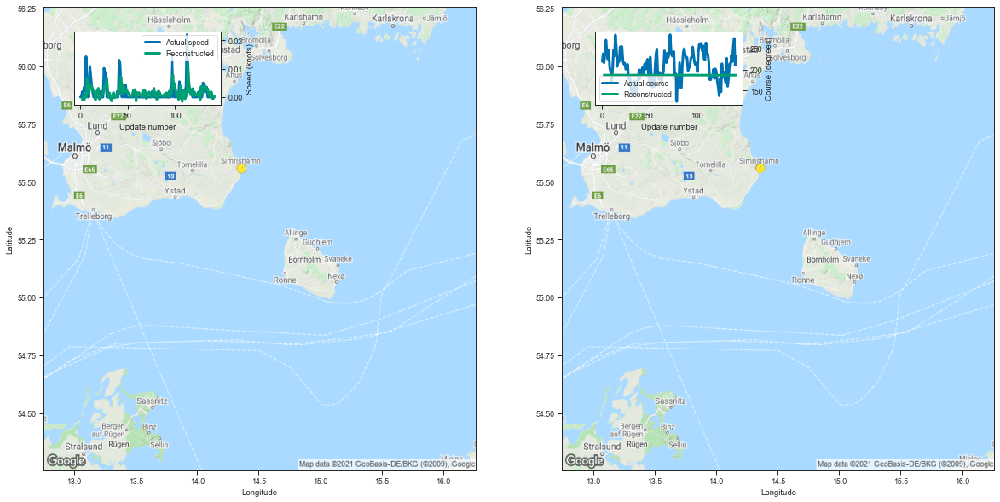

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359342  55.558788 -0.001053  186.673660         0.001280   
3    14.359921  55.557945  0.000615  186.553741         0.000889   
4    14.359797  55.558640 -0.000941  186.541183         0.000821   
5    14.360312  55.558643  0.000781  186.509903         0.000776   
6    14.360054  55.558052 -0.000066  186.437439         0.000712   
..         ...        ...       ...         ...              ...   
138  14.359813  55.558887  0.001823  186.412277         0.000684   
139  14.360687  55.558025  0.001837  186.595383         0.000826   
140  14.360052  55.558525 -0.000537  186.421783         0.000696   
141  14.359869  55.558983 -0.000501  186.443573         0.000706   
142  14.360326  55.557858  0.000492  186.467361         0.000723   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001279     0.005031     90.812032  
3          0.000849     0.003856     96.317098  
4          0.000772     0.003864    

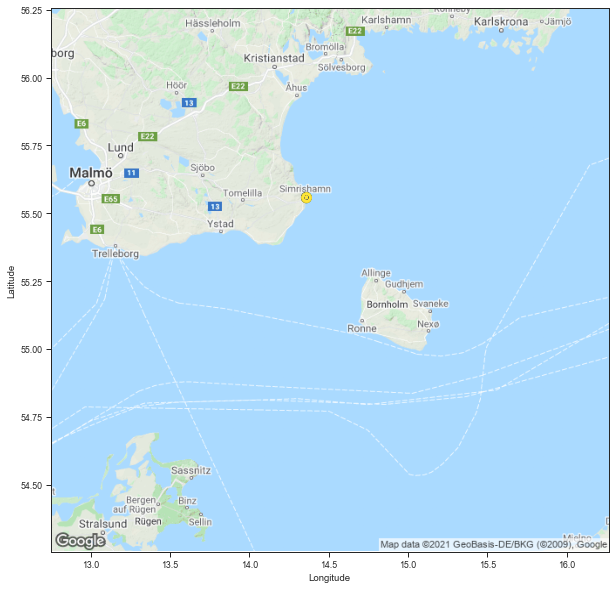

     Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                 0  6685896  265759000  14.359031  55.556702  0.000000   
1                 0  6685896  265759000  14.359023  55.556713  0.000000   
2                 0  6685896  265759000  14.359054  55.556709  0.001923   
3                 0  6685896  265759000  14.359044  55.556709  0.000000   
4                 0  6685896  265759000  14.359061  55.556709  0.003571   
..              ...      ...        ...        ...        ...       ...   
138               0  6685896  265759000  14.359066  55.556721  0.000000   
139               0  6685896  265759000  14.359043  55.556709  0.000000   
140               0  6685896  265759000  14.359036  55.556713  0.000000   
141               0  6685896  265759000  14.359025  55.556694  0.000000   
142               0  6685896  265759000  14.359023  55.556709  0.000000   

         Course Ship type  Track length          Time stamp  
0    219.074280   Fishing           1

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,14.359342,55.558788,-0.001053,186.673660,0.001280,0.001279,0.005031,90.812032
3,14.359921,55.557945,0.000615,186.553741,0.000889,0.000849,0.003856,96.317098
4,14.359797,55.558640,-0.000941,186.541183,0.000821,0.000772,0.003864,97.945920
5,14.360312,55.558643,0.000781,186.509903,0.000776,0.000727,0.003489,98.409629
6,14.360054,55.558052,-0.000066,186.437439,0.000712,0.000671,0.002720,98.404806
...,...,...,...,...,...,...,...,...
138,14.359813,55.558887,0.001823,186.412277,0.000684,0.000644,0.002502,98.636649
139,14.360687,55.558025,0.001837,186.595383,0.000826,0.000759,0.004820,99.484673
140,14.360052,55.558525,-0.000537,186.421783,0.000696,0.000657,0.002593,98.487780
141,14.359869,55.558983,-0.000501,186.443573,0.000706,0.000662,0.002812,98.801435


In [15]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


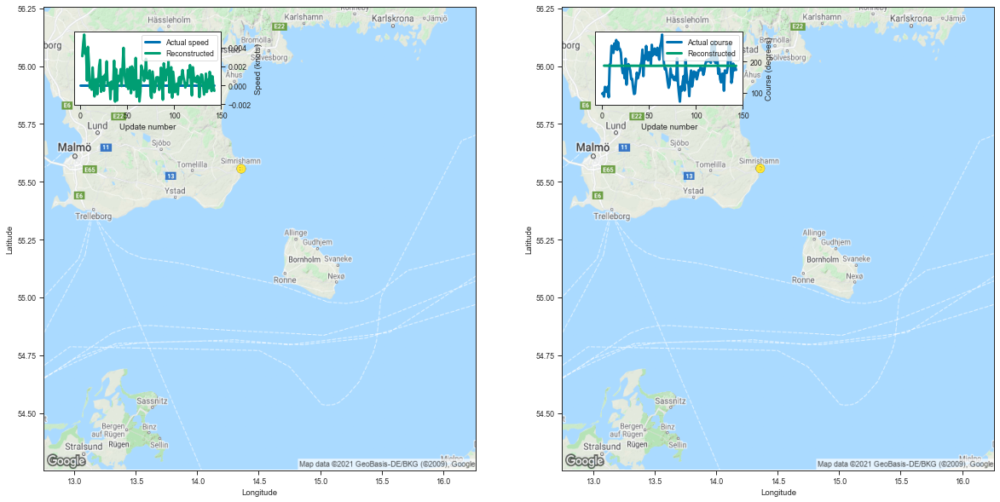

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358787  55.557545  0.003073  186.866058         0.001538   
3    14.358286  55.558086  0.004416  186.808365         0.001165   
4    14.359230  55.558247  0.005346  186.806213         0.001103   
5    14.359356  55.558025  0.003329  186.761490         0.001035   
6    14.359554  55.557602  0.003801  186.674469         0.000924   
..         ...        ...       ...         ...              ...   
139  14.359327  55.557011  0.000969  186.417343         0.000681   
140  14.359418  55.556904 -0.000612  186.545975         0.000782   
141  14.358488  55.558632  0.000935  186.658035         0.000885   
142  14.359088  55.557949 -0.000146  186.453232         0.000721   
143  14.359547  55.557388 -0.000579  186.413467         0.000682   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001489     0.010043     92.151291  
3          0.001080     0.009720     97.307763  
4          0.001007     0.010302    

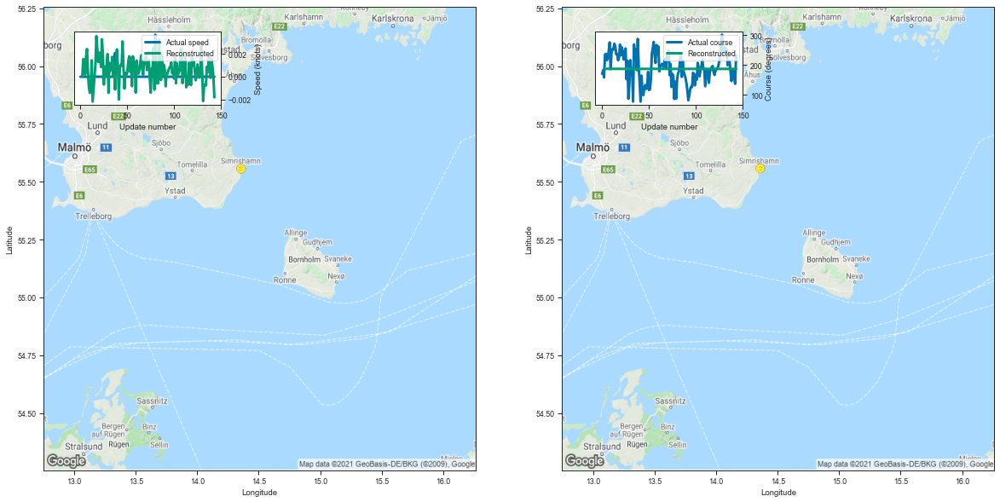

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359485  55.557926  0.000014  186.637894         0.001223   
3    14.358500  55.557514  0.001546  186.641769         0.000972   
4    14.359241  55.557564  0.001404  186.570511         0.000853   
5    14.359506  55.557110  0.000203  186.551651         0.000816   
6    14.358723  55.557995  0.001749  186.426529         0.000707   
..         ...        ...       ...         ...              ...   
139  14.359461  55.557140 -0.000099  186.468109         0.000725   
140  14.359531  55.556847  0.001563  186.497696         0.000745   
141  14.359721  55.557278  0.000854  186.473251         0.000729   
142  14.358614  55.557663  0.000011  186.541321         0.000779   
143  14.358930  55.557743 -0.001816  186.452759         0.000713   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001222     0.004401     90.947793  
3          0.000916     0.005276     96.774237  
4          0.000800     0.004306    

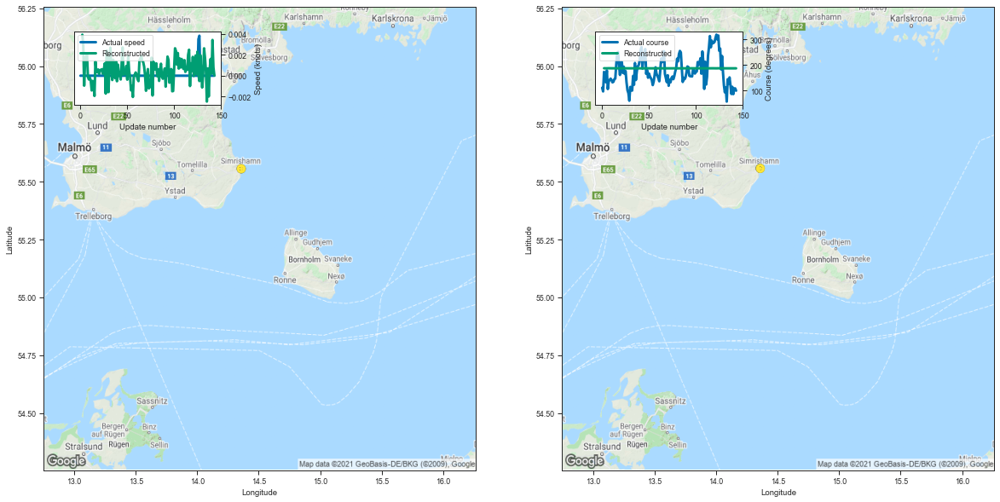

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358266  55.557907  0.003952  186.704727         0.001292   
3    14.358586  55.558014  0.002925  186.528885         0.000866   
4    14.359062  55.557224 -0.000959  186.438095         0.000731   
5    14.359499  55.557507  0.001544  186.672989         0.000916   
6    14.358960  55.558147  0.001786  186.645859         0.000897   
..         ...        ...       ...         ...              ...   
139  14.357930  55.557533  0.001616  186.423340         0.000689   
140  14.359104  55.558136  0.000198  186.435913         0.000695   
141  14.358451  55.557163  0.003439  186.573105         0.000803   
142  14.359785  55.557457  0.000800  186.487045         0.000742   
143  14.359502  55.557610  0.000024  186.410599         0.000679   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001269     0.005762     91.803703  
3          0.000827     0.003516     96.303095  
4          0.000693     0.002670    

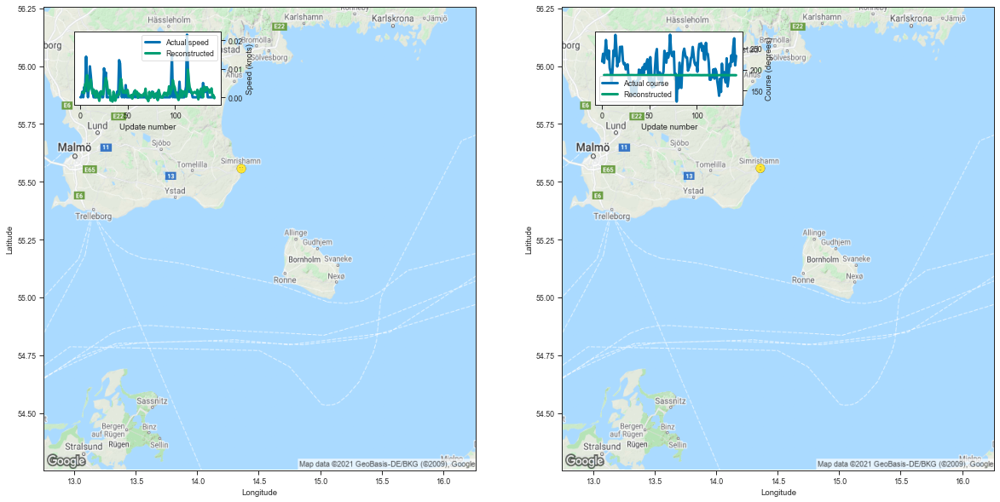

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359928  55.557880  0.001734  186.806168         0.001452   
3    14.359712  55.558250  0.001676  186.669327         0.001015   
4    14.360049  55.558521  0.001502  186.687943         0.000969   
5    14.360877  55.558426  0.004594  186.915939         0.001207   
6    14.360833  55.557861  0.004306  186.828888         0.001102   
..         ...        ...       ...         ...              ...   
138  14.360256  55.558289  0.002351  186.557968         0.000803   
139  14.360637  55.557289  0.003098  186.446884         0.000715   
140  14.360667  55.558010  0.000130  186.490570         0.000743   
141  14.359796  55.559113  0.000704  186.427795         0.000696   
142  14.359614  55.558258 -0.000324  186.411499         0.000681   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001416     0.008004     91.802522  
3          0.000957     0.005872     96.632575  
4          0.000896     0.006615    

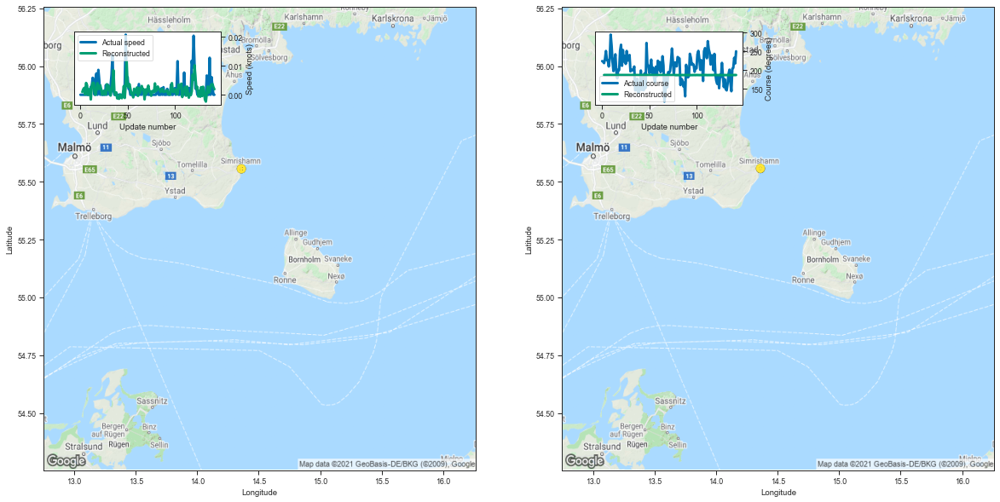

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360544  55.556995  0.000968  186.681030         0.001279   
3    14.360248  55.556953  0.001897  186.677917         0.001003   
4    14.360768  55.557640  0.002372  186.676666         0.000958   
5    14.360497  55.557487  0.000139  186.798462         0.001057   
6    14.360908  55.557083  0.004084  186.788834         0.001052   
..         ...        ...       ...         ...              ...   
138  14.360269  55.557083  0.003202  186.421738         0.000694   
139  14.360588  55.557205  0.003586  186.647034         0.000876   
140  14.360464  55.557083  0.003695  186.505798         0.000766   
141  14.360956  55.557072  0.002614  186.678558         0.000907   
142  14.360248  55.557762  0.001911  186.684189         0.000927   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001272     0.005213     91.175499  
3          0.000943     0.005792     96.877359  
4          0.000888     0.006366    

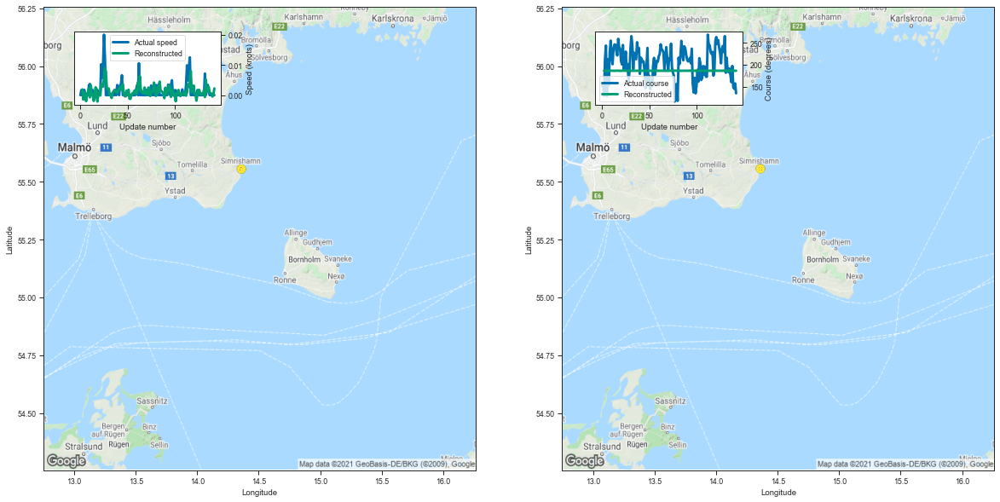

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360428  55.556381  0.001905  186.759308         0.001387   
3    14.359945  55.557026 -0.001447  186.630966         0.000963   
4    14.359646  55.557117  0.000241  186.577194         0.000861   
5    14.360411  55.556858  0.000959  186.461487         0.000742   
6    14.360818  55.556789 -0.001997  186.426987         0.000699   
..         ...        ...       ...         ...              ...   
138  14.360235  55.556049  0.000531  186.429306         0.000693   
139  14.360298  55.556595  0.000498  186.577774         0.000809   
140  14.361070  55.556175 -0.000470  186.425949         0.000696   
141  14.360193  55.556404  0.000209  186.408325         0.000676   
142  14.360280  55.555927  0.002204  186.541061         0.000779   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001362     0.006942     91.579062  
3          0.000909     0.005087     96.704073  
4          0.000807     0.004436    

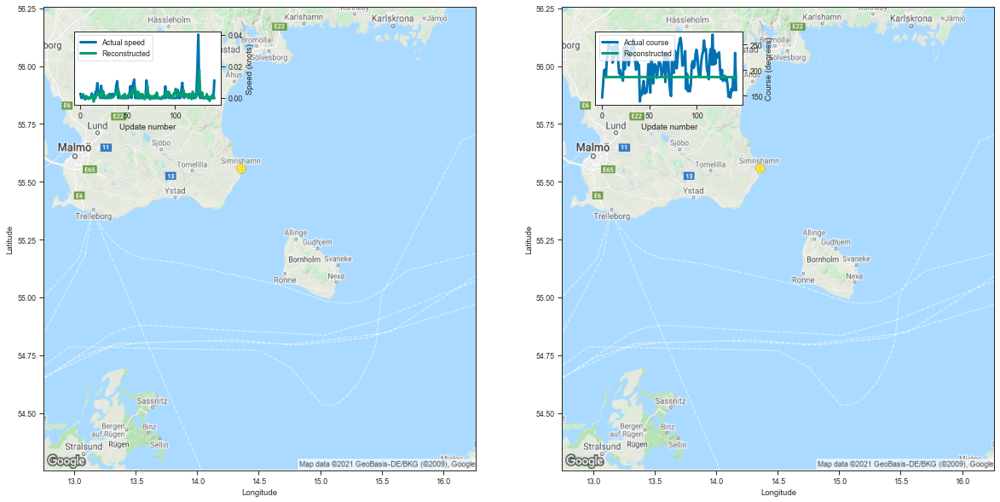

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359916  55.557446  0.001889  186.833832         0.001501   
3    14.360046  55.557564  0.002358  186.563354         0.000909   
4    14.360385  55.557602  0.000235  186.615173         0.000891   
5    14.360463  55.557686 -0.000969  186.446701         0.000730   
6    14.360066  55.557327  0.001251  186.475037         0.000737   
..         ...        ...       ...         ...              ...   
138  14.359757  55.557693  0.000728  186.408752         0.000678   
139  14.359462  55.557384  0.000480  186.451675         0.000708   
140  14.361115  55.556938  0.002140  186.583633         0.000815   
141  14.360444  55.556870  0.001617  186.547455         0.000793   
142  14.360185  55.557362 -0.000170  186.440582         0.000707   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001461     0.008925     91.803900  
3          0.000870     0.004020     96.083841  
4          0.000830     0.005065    

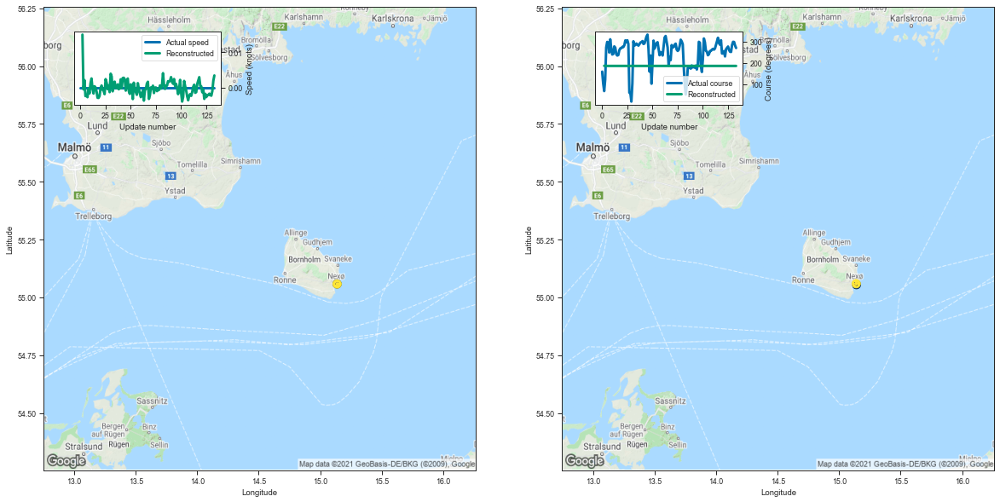

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.140867  55.055088  0.014937  186.967468         0.002636   
3    15.139505  55.057167 -0.000446  186.679733         0.001472   
4    15.138532  55.059364  0.002158  186.522324         0.001159   
5    15.137997  55.059624 -0.002342  186.312973         0.000901   
6    15.138462  55.059086 -0.002128  186.307068         0.000866   
..         ...        ...       ...         ...              ...   
129  15.138836  55.059227 -0.002078  186.263184         0.000811   
130  15.138467  55.059216 -0.002208  186.262741         0.000809   
131  15.138370  55.059574 -0.000893  186.460342         0.000999   
132  15.138931  55.059147  0.001995  186.411453         0.000970   
133  15.138797  55.059151  0.003463  186.273346         0.000837   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002415     0.044913     94.825987  
3          0.001332     0.020395    100.489738  
4          0.001058     0.012375    

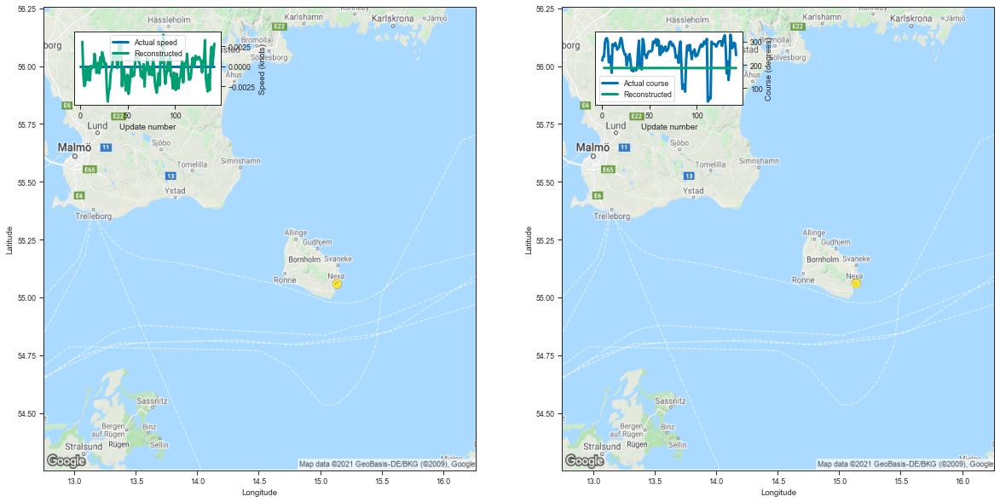

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.138051  55.060764  0.003065  186.707352         0.001986   
3    15.139105  55.059250 -0.000929  186.544403         0.001276   
4    15.137655  55.060341 -0.002487  186.371704         0.000976   
5    15.138832  55.058990 -0.002360  186.291748         0.000862   
6    15.138381  55.059578 -0.000336  186.279770         0.000839   
..         ...        ...       ...         ...              ...   
138  15.138218  55.059586  0.001171  186.270111         0.000824   
139  15.138803  55.059155  0.002433  186.377319         0.000919   
140  15.138443  55.059475  0.000193  186.296463         0.000850   
141  15.138200  55.059956  0.001372  186.536819         0.001094   
142  15.138101  55.059792  0.002824  186.279419         0.000853   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001884     0.017367     93.812807  
3          0.001175     0.012063     99.878808  
4          0.000905     0.006900    

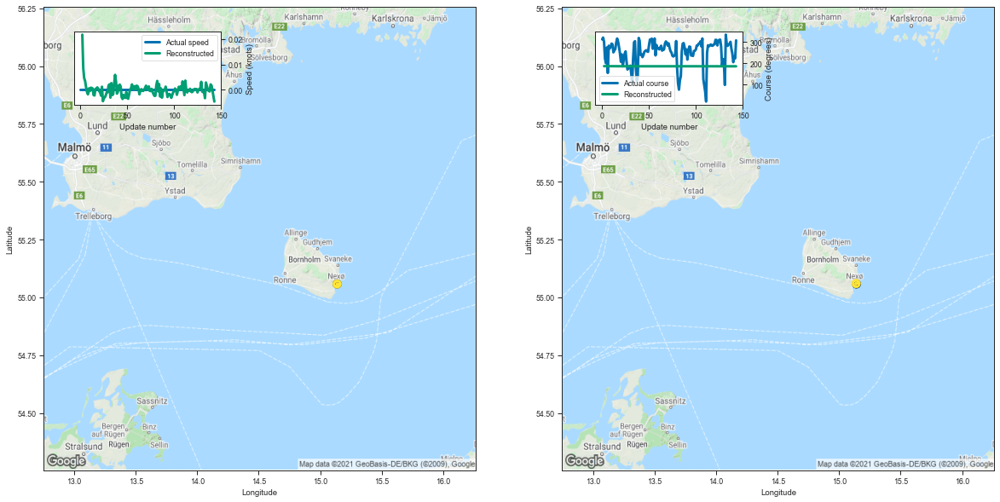

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.140216  55.058060  0.021805  186.924347         0.002646   
3    15.138235  55.059292  0.008554  186.882614         0.001844   
4    15.138523  55.060646  0.004641  186.619537         0.001339   
5    15.137861  55.061100  0.003469  186.571503         0.001199   
6    15.138422  55.060158  0.001056  186.609467         0.001235   
..         ...        ...       ...         ...              ...   
139  15.138654  55.058941  0.002155  186.264221         0.000815   
140  15.138857  55.058941  0.001703  186.413437         0.000951   
141  15.137963  55.060448 -0.000330  186.267273         0.000826   
142  15.138477  55.059978 -0.002581  186.319794         0.000860   
143  15.138327  55.059708 -0.004624  186.264938         0.000813   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002458     0.040310     93.762312  
3          0.001644     0.039115    100.577599  
4          0.001220     0.017598    

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
25,25,7292936,266054000,Fishing,144,1344.686035,9.338097
44,44,7135380,266054000,Fishing,144,1328.617920,9.226513
34,34,7237328,266054000,Fishing,144,1327.952393,9.221892
17,17,6685896,265759000,Fishing,143,1309.320312,9.156086
29,29,6787151,265759000,Fishing,143,1294.858521,9.054955
74,74,6962046,265759000,Fishing,143,1287.922241,9.006449
60,60,6869996,265759000,Fishing,143,1274.134277,8.910030
109,109,609266,211474000,Fishing,134,1168.581055,8.720754
46,46,867510,211474000,Fishing,143,1246.194580,8.714647
66,66,729120,211474000,Fishing,144,1246.449097,8.655897


In [16]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


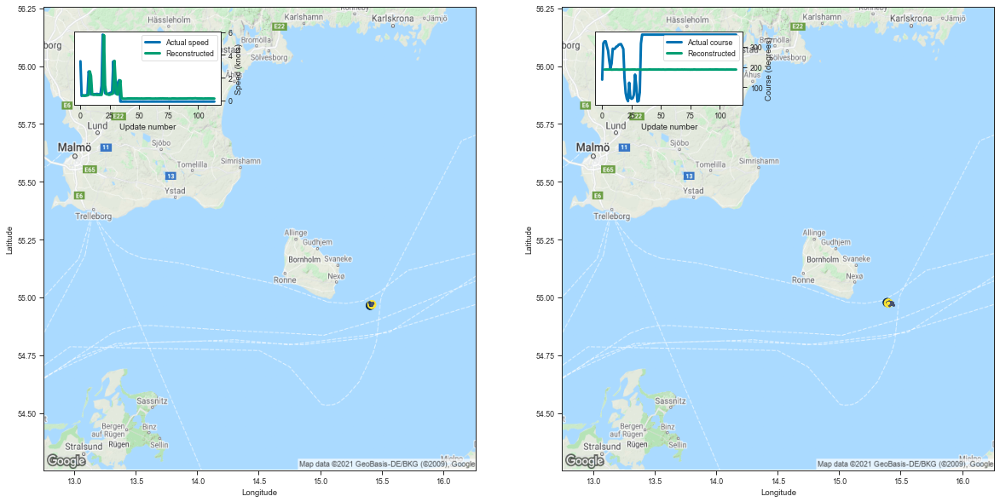

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.390971  54.977749  0.430482  187.479248         0.008473   
3    15.400268  54.975685  0.413348  187.462280         0.006347   
4    15.397855  54.975948  0.410289  187.674454         0.007531   
5    15.398603  54.975372  0.434200  187.546783         0.006803   
6    15.402235  54.972858  0.441605  187.563019         0.006901   
..         ...        ...       ...         ...              ...   
110  15.400136  54.973984  0.172800  187.597214         0.005760   
111  15.400254  54.974213  0.170367  187.398926         0.004697   
112  15.400878  54.975044  0.169304  187.352463         0.004309   
113  15.399845  54.975567  0.168751  187.486725         0.004899   
114  15.400558  54.975098  0.163298  187.357956         0.004376   

     Latitude sigma  Speed sigma  Course sigma  
2          0.006646     0.682070     94.293373  
3          0.004853     0.758348    100.192032  
4          0.005557     1.293531    

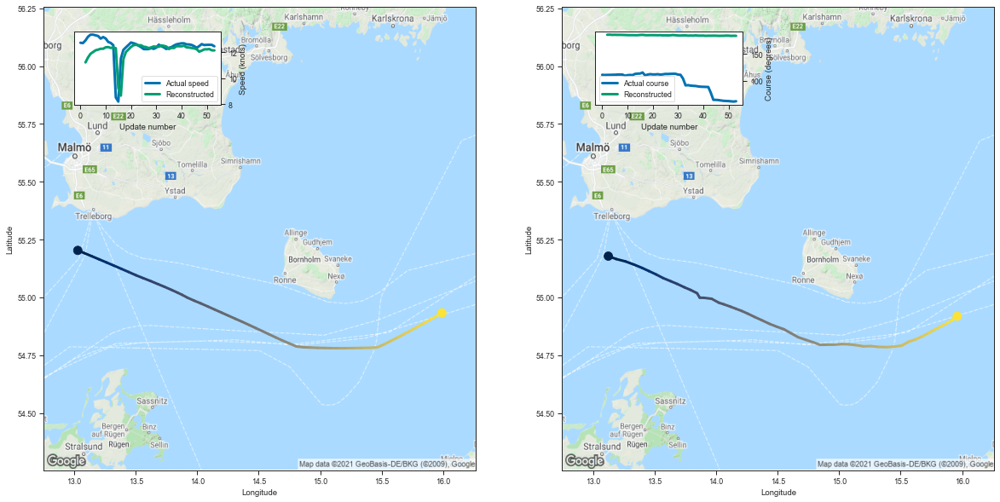

    Longitude   Latitude      Speed      Course  Longitude sigma  \
2   13.123746  55.178268  11.204908  186.019058         0.019255   
3   13.188209  55.165691  11.584671  186.223785         0.023090   
4   13.262888  55.155399  11.866007  185.778152         0.016691   
5   13.332094  55.141758  12.002365  185.964859         0.021712   
6   13.397887  55.127438  12.134583  185.777710         0.019765   
7   13.455664  55.113232  12.185276  185.835648         0.021951   
8   13.513391  55.098820  12.252405  185.719131         0.020802   
9   13.569058  55.083439  12.252817  185.566269         0.018633   
10  13.629731  55.070129  12.365269  185.337601         0.015893   
11  13.684119  55.057991  12.380814  185.294739         0.015837   
12  13.742946  55.043301  12.315536  185.334305         0.016741   
13  13.792730  55.031990  12.349586  185.180695         0.015072   
14  13.845469  55.017857  12.289669  185.202484         0.015594   
15  13.866846  54.998554   9.231289  185.627396 

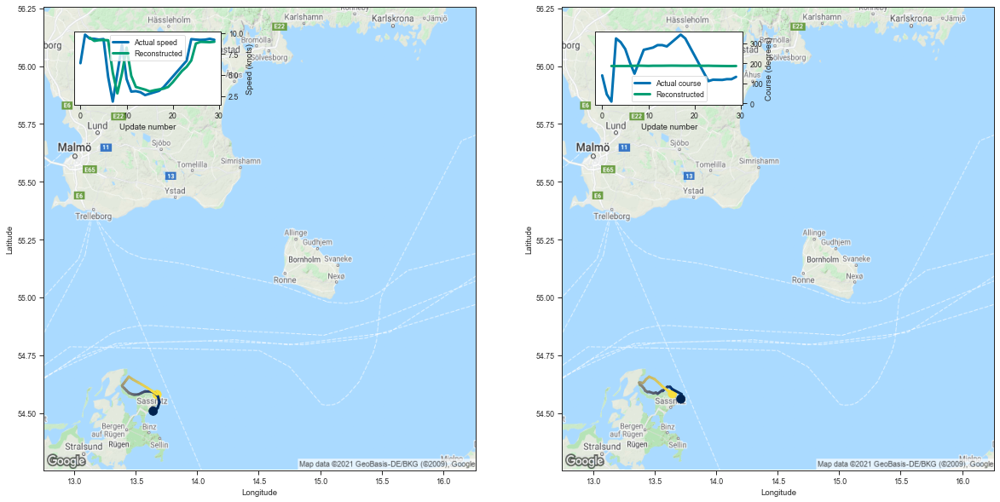

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.713546  54.560642  9.433774  186.511490         0.027378   
3   13.718211  54.581703  9.049651  186.246109         0.015517   
4   13.642175  54.603130  9.139837  186.478088         0.018059   
5   13.626320  54.612839  9.157879  186.358627         0.015799   
6   13.602589  54.612804  9.126118  186.676788         0.020865   
7   13.564865  54.594879  5.267716  187.447601         0.012480   
8   13.560467  54.597244  2.802837  188.081848         0.009989   
9   13.524342  54.583225  5.204268  187.610947         0.014064   
10  13.510804  54.587910  8.251071  186.981964         0.020102   
11  13.490347  54.585346  4.900719  187.654678         0.012946   
12  13.456635  54.591221  3.567742  187.670242         0.008251   
13  13.441216  54.590633  3.407036  187.744247         0.008227   
14  13.424447  54.595901  3.251588  188.043076         0.010333   
15  13.425818  54.596016  3.041801  188.303452         0.01257

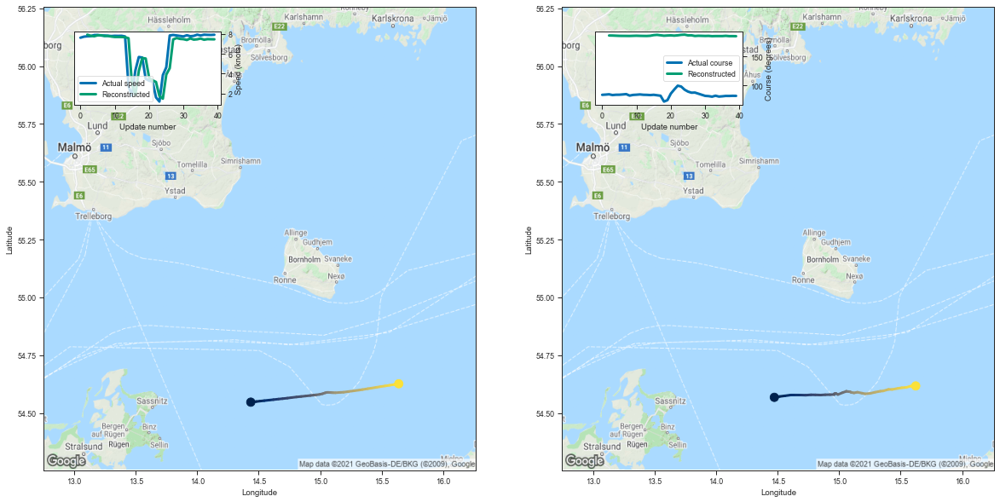

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.473373  54.567646  7.932628  186.254608         0.021673   
3   14.516080  54.571232  7.817419  186.166428         0.016493   
4   14.559835  54.574169  7.768173  185.905823         0.012309   
5   14.607222  54.577621  7.861105  185.647781         0.009870   
6   14.643130  54.577679  7.871072  185.589142         0.009377   
7   14.690718  54.577507  7.789432  185.543381         0.008888   
8   14.728179  54.576931  7.802166  185.486847         0.008635   
9   14.770926  54.578560  7.738282  185.685181         0.010507   
10  14.807455  54.578285  7.694660  185.866592         0.012911   
11  14.849775  54.577496  7.694967  185.645325         0.010868   
12  14.887465  54.578819  7.689015  185.520065         0.009649   
13  14.926939  54.579235  7.676374  185.459076         0.009189   
14  14.962244  54.579750  7.568154  185.797760         0.012697   
15  14.961226  54.583416  2.957671  186.924973         0.00725

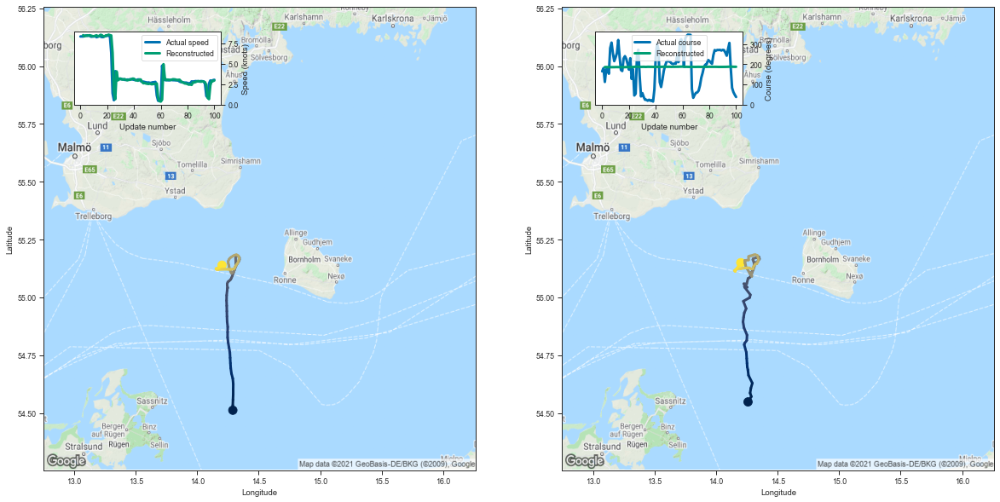

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.259432  54.547829  8.476215  186.036560         0.018534   
3    14.286395  54.570900  8.336549  186.140930         0.016271   
4    14.276226  54.586113  8.400002  185.966507         0.013382   
5    14.282768  54.607475  8.451456  185.776840         0.011089   
6    14.294589  54.628925  8.421585  185.587067         0.008964   
..         ...        ...       ...         ...              ...   
96   14.156718  55.112411  0.675867  188.346588         0.007967   
97   14.157945  55.119720  2.374332  187.725357         0.009099   
98   14.181184  55.134113  2.888025  187.507141         0.008687   
99   14.191074  55.141376  2.873869  187.292587         0.006957   
100  14.200303  55.150036  2.952485  187.320114         0.007193   

     Latitude sigma  Speed sigma  Course sigma  
2          0.010796     0.816393     96.538812  
3          0.009179     1.133161    101.741621  
4          0.007717     0.816603    

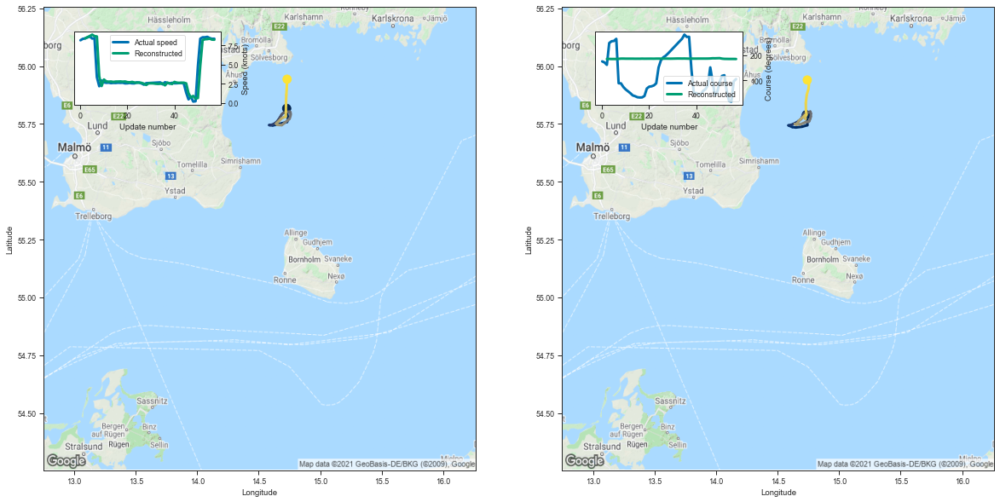

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.732988  55.789394  8.408451  185.415436         0.015290   
3   14.742061  55.758247  8.565233  185.681564         0.016322   
4   14.741570  55.744518  8.707684  185.411026         0.012925   
5   14.698558  55.737907  8.891022  185.398285         0.012522   
6   14.646811  55.734451  8.693141  185.466843         0.012000   
7   14.619877  55.736488  8.655865  186.070389         0.021220   
8   14.587956  55.743748  3.458808  186.919342         0.009230   
9   14.605387  55.745152  2.219745  186.960480         0.006145   
10  14.624536  55.748760  3.065828  186.695801         0.006259   
11  14.643395  55.753845  2.821746  186.695908         0.005694   
12  14.656412  55.757446  2.786179  186.675278         0.005463   
13  14.669422  55.762646  2.805882  186.669754         0.005465   
14  14.681639  55.767227  2.752712  186.457413         0.004338   
15  14.691296  55.771023  2.798511  186.527496         0.00464

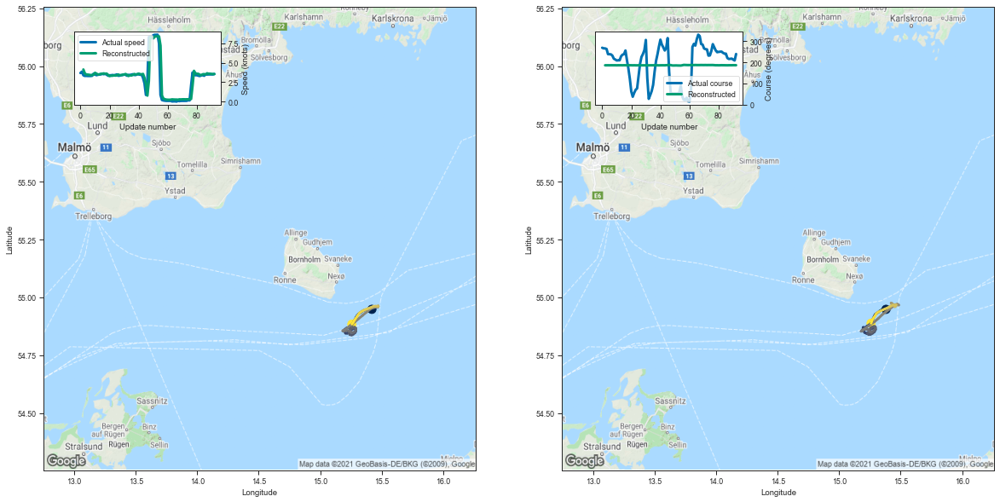

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.381342  54.948208  4.133668  186.212418         0.011326   
3   15.366673  54.947277  3.646072  186.174850         0.007061   
4   15.348431  54.946964  3.483915  186.281265         0.006770   
5   15.329955  54.940647  3.478316  186.126617         0.005606   
6   15.318366  54.935799  3.454697  186.352493         0.006695   
..        ...        ...       ...         ...              ...   
88  15.291099  54.919861  3.592994  186.456711         0.007906   
89  15.282487  54.912781  3.592471  186.447922         0.007855   
90  15.271985  54.904770  3.565045  186.706451         0.009968   
91  15.264684  54.896816  3.550038  186.673798         0.009942   
92  15.259674  54.887959  3.547873  186.486725         0.008136   

    Latitude sigma  Speed sigma  Course sigma  
2         0.007545     0.540981     92.320058  
3         0.004787     0.385648     97.179175  
4         0.004542     0.465459     99.222052  
5  

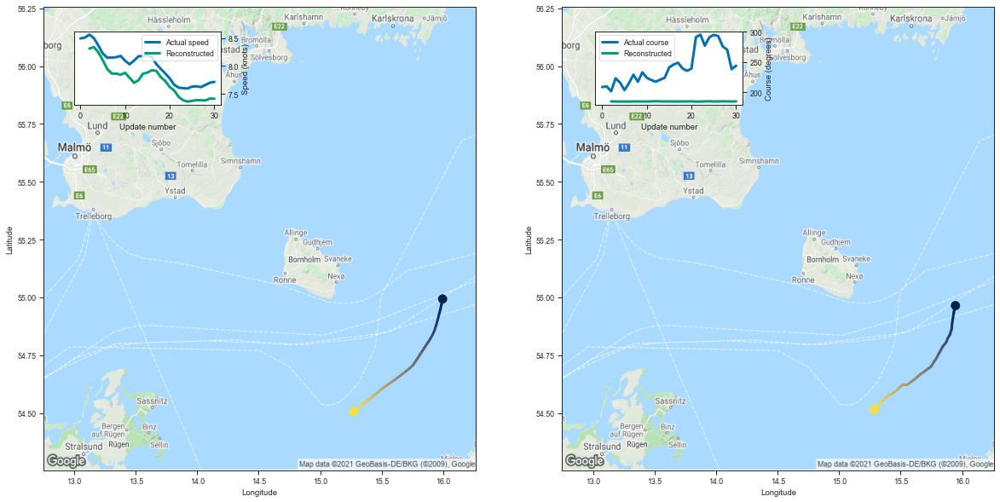

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.945746  54.964302  8.310661  185.244247         0.030437   
3   15.932686  54.936104  8.337850  185.094727         0.021624   
4   15.924844  54.908604  8.245781  185.032578         0.018514   
5   15.917624  54.883293  8.104094  185.031876         0.017103   
6   15.914604  54.862617  7.946229  184.974243         0.015000   
7   15.900183  54.838470  7.864827  185.097412         0.015884   
8   15.883070  54.822914  7.861168  185.206680         0.017485   
9   15.869747  54.804943  7.844174  185.131378         0.016010   
10  15.843597  54.788349  7.876284  185.121597         0.015350   
11  15.825771  54.771179  7.789682  185.221695         0.016121   
12  15.808286  54.754372  7.698289  185.571808         0.022040   
13  15.792480  54.738041  7.743390  185.290024         0.017124   
14  15.769415  54.720104  7.861403  185.141632         0.014564   
15  15.745640  54.699684  7.880894  185.177490         0.01455

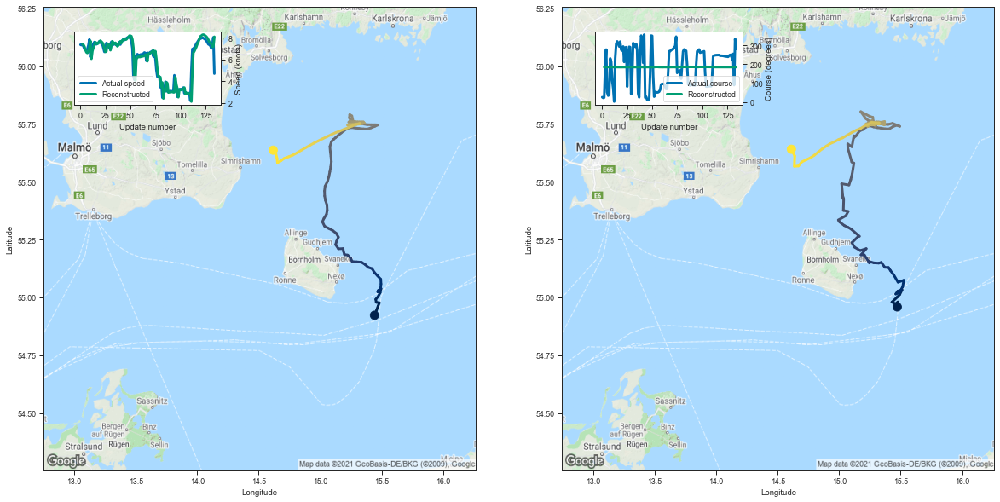

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.472281  54.958759  7.412025  185.061340         0.012082   
3    15.477212  54.980209  7.362648  185.343094         0.012108   
4    15.461019  54.972054  7.189289  185.579865         0.014593   
5    15.428847  54.979244  6.886070  185.775467         0.015525   
6    15.471984  55.000862  6.669111  185.863876         0.016264   
..         ...        ...       ...         ...              ...   
130  14.694811  55.585236  7.532454  185.747269         0.011222   
131  14.670011  55.567928  7.457487  185.535461         0.008729   
132  14.635841  55.566628  7.177238  185.404129         0.006633   
133  14.638979  55.611362  7.189436  185.578445         0.007591   
134  14.611816  55.640495  8.099476  185.694824         0.011392   

     Latitude sigma  Speed sigma  Course sigma  
2          0.007779     0.303082     91.371981  
3          0.007344     0.744273     98.252838  
4          0.008617     1.129720    

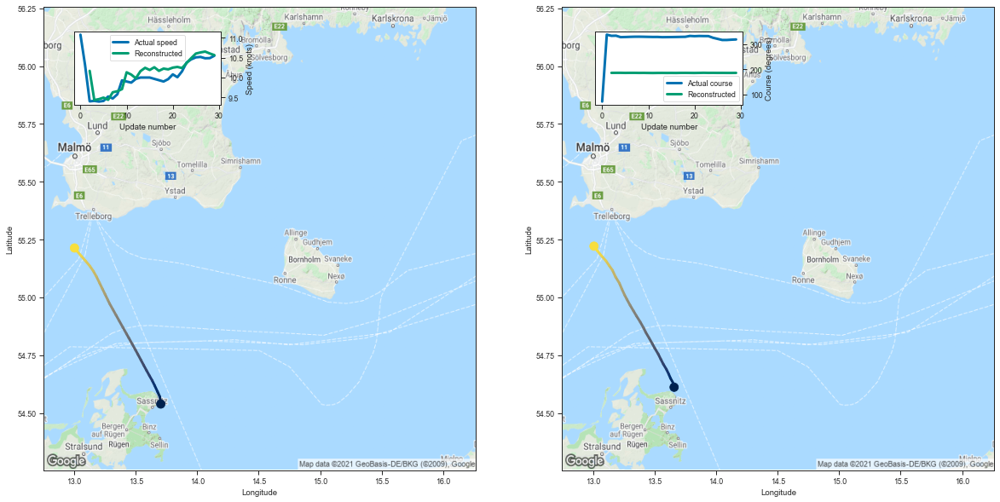

    Longitude   Latitude      Speed      Course  Longitude sigma  \
2   13.658610  54.611359  10.169165  186.306503         0.027063   
3   13.653078  54.627357   9.432709  186.465347         0.020646   
4   13.628855  54.650497   9.455551  186.504257         0.020160   
5   13.614885  54.667957   9.493877  186.161972         0.014148   
6   13.595746  54.688992   9.438339  186.353638         0.016231   
7   13.571229  54.710735   9.628668  186.366638         0.017100   
8   13.550495  54.732079   9.655163  186.106293         0.013114   
9   13.529255  54.755051   9.707859  186.251404         0.015002   
10  13.501030  54.780125  10.132381  185.933609         0.012300   
11  13.482577  54.798344  10.074379  185.742401         0.009727   
12  13.456473  54.822994   9.981590  186.016663         0.012066   
13  13.427717  54.848988  10.161182  186.111664         0.013806   
14  13.409890  54.868416  10.245079  185.886185         0.011290   
15  13.382153  54.894646  10.191053  186.034927 

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
56,56,4380691,261017210,Fishing,115,-663.353760,-5.768294
36,36,7969192,273352230,Fishing,54,-152.332977,-2.820981
73,73,1113112,211542610,Fishing,30,-83.297813,-2.776594
67,67,1070020,211474000,Fishing,40,-81.270653,-2.031766
48,48,4303656,261007170,Fishing,101,-167.586533,-1.659273
38,38,4942336,265593190,Fishing,58,-93.917923,-1.619275
78,78,140882,211314800,Fishing,93,-148.327606,-1.594920
1,1,4547326,261061000,Fishing,31,-43.530857,-1.404221
49,49,1557318,219021428,Fishing,135,-189.503235,-1.403728
101,101,1176042,211755650,Fishing,30,-28.117891,-0.937263


In [17]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


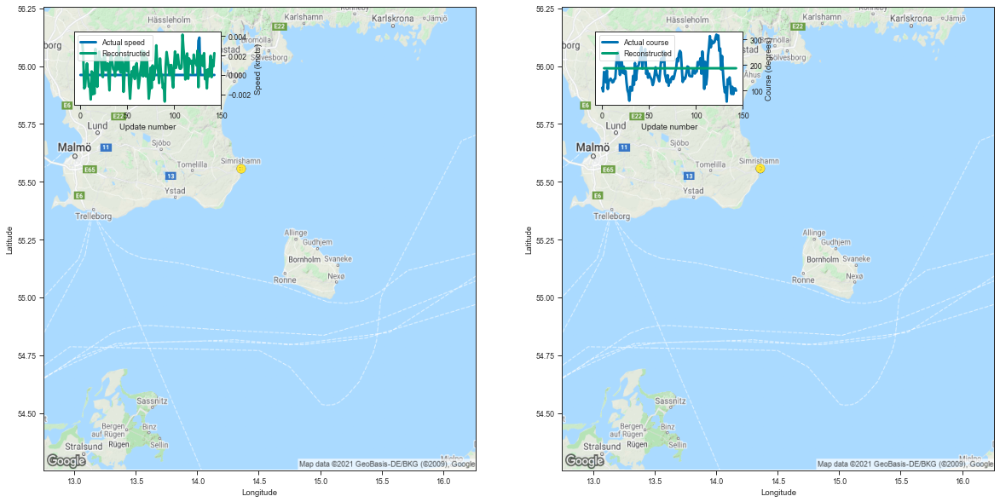

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359328  55.556576  0.003289  186.665161         0.001240   
3    14.358852  55.557571  0.002004  186.475800         0.000818   
4    14.359168  55.557690 -0.001383  186.646973         0.000910   
5    14.358889  55.557758 -0.001208  186.484726         0.000758   
6    14.359159  55.558105  0.000128  186.558685         0.000809   
..         ...        ...       ...         ...              ...   
139  14.357618  55.558037  0.001976  186.629578         0.000856   
140  14.359272  55.558086 -0.000224  186.601990         0.000839   
141  14.357863  55.558113  0.001521  186.458618         0.000719   
142  14.359045  55.558380  0.000891  186.596359         0.000827   
143  14.359862  55.557487  0.002250  186.721146         0.000946   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001225     0.004970     91.560522  
3          0.000785     0.002909     96.144737  
4          0.000841     0.005651    

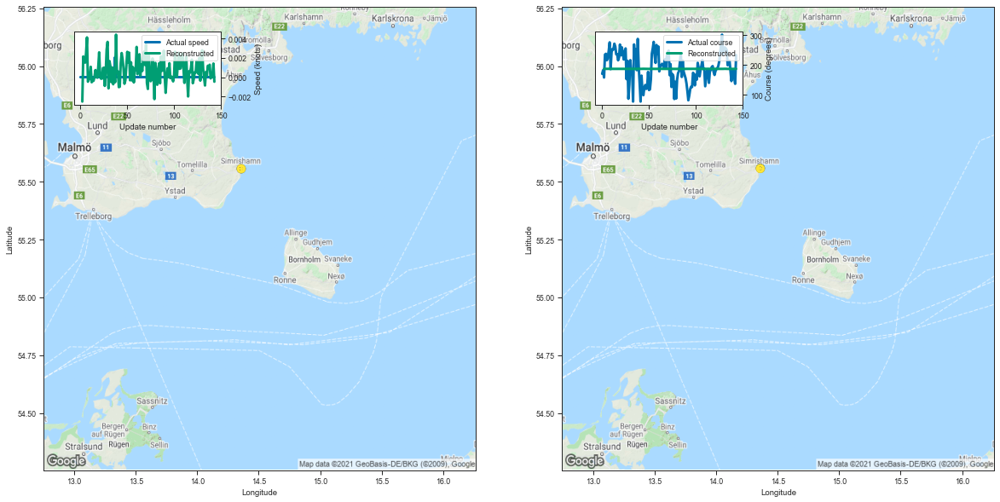

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359778  55.557972 -0.002536  186.652664         0.001258   
3    14.359164  55.556870  0.002146  186.616043         0.000947   
4    14.359380  55.557644  0.001635  186.609528         0.000892   
5    14.359385  55.557522  0.001508  186.546936         0.000813   
6    14.359577  55.557087  0.002467  186.555603         0.000813   
..         ...        ...       ...         ...              ...   
139  14.359536  55.556808 -0.000128  186.701202         0.000922   
140  14.358878  55.557407 -0.000006  186.506607         0.000767   
141  14.359751  55.557209  0.000265  186.535690         0.000777   
142  14.358569  55.557446  0.001413  186.414795         0.000687   
143  14.359287  55.557133 -0.000473  186.604980         0.000832   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001261     0.004677     90.656035  
3          0.000897     0.004827     96.629533  
4          0.000834     0.005041    

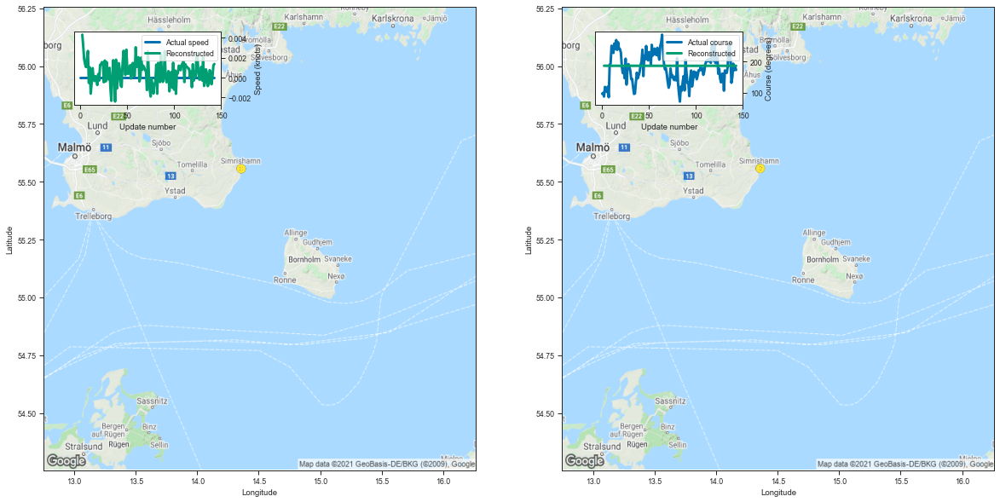

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358966  55.557579  0.004316  186.636154         0.001232   
3    14.358365  55.556866  0.003139  186.588745         0.000915   
4    14.359051  55.558002  0.001815  186.536133         0.000814   
5    14.359097  55.557732  0.001336  186.503113         0.000768   
6    14.359432  55.557266  0.001058  186.507126         0.000758   
..         ...        ...       ...         ...              ...   
139  14.359028  55.557854  0.000505  186.660767         0.000884   
140  14.358514  55.558212 -0.000665  186.450745         0.000718   
141  14.359111  55.557671  0.000124  186.452393         0.000711   
142  14.359851  55.557312  0.001236  186.463333         0.000719   
143  14.359543  55.557365  0.001368  186.503601         0.000750   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001229     0.004525     90.900057  
3          0.000866     0.004493     96.797257  
4          0.000764     0.003809    

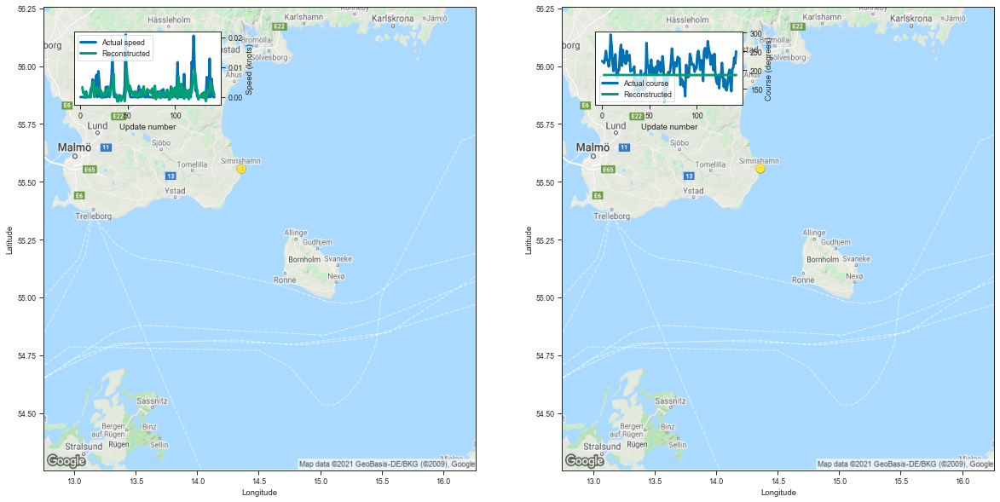

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360228  55.556374  0.003302  186.607422         0.001180   
3    14.359788  55.556870  0.001349  186.474701         0.000814   
4    14.360681  55.557049  0.001563  186.471191         0.000759   
5    14.360302  55.557270 -0.000220  186.422577         0.000704   
6    14.360285  55.557041  0.001882  186.428848         0.000701   
..         ...        ...       ...         ...              ...   
138  14.360255  55.557140  0.005198  186.418503         0.000697   
139  14.360250  55.557404  0.002127  186.594467         0.000827   
140  14.360636  55.557644  0.002953  186.555222         0.000800   
141  14.360119  55.557781  0.001566  186.479736         0.000741   
142  14.359753  55.557564  0.000745  186.431168         0.000697   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001179     0.003959     91.012979  
3          0.000781     0.002886     96.216827  
4          0.000717     0.002990    

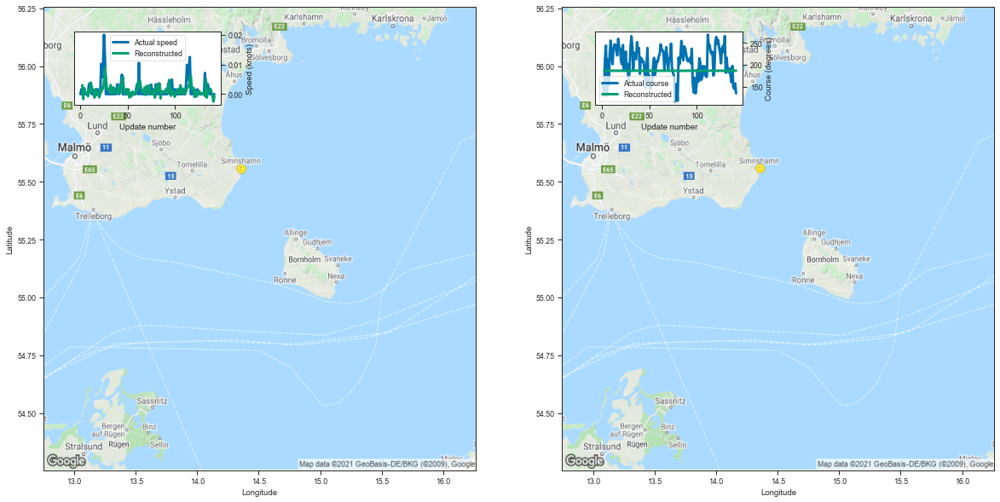

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359735  55.557114  0.003031  186.933060         0.001717   
3    14.360139  55.556908 -0.001657  186.681473         0.001035   
4    14.360607  55.556438  0.001997  186.576447         0.000865   
5    14.359921  55.557323  0.000415  186.744461         0.000996   
6    14.361116  55.556366  0.000490  186.630005         0.000884   
..         ...        ...       ...         ...              ...   
138  14.359860  55.556274  0.001731  186.406784         0.000675   
139  14.360464  55.556355  0.000371  186.495514         0.000736   
140  14.359934  55.556911 -0.000454  186.497971         0.000746   
141  14.360284  55.556850 -0.002490  186.462646         0.000718   
142  14.359744  55.557018 -0.000693  186.561890         0.000799   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001674     0.013046     91.332748  
3          0.000982     0.006228     96.288279  
4          0.000814     0.004468    

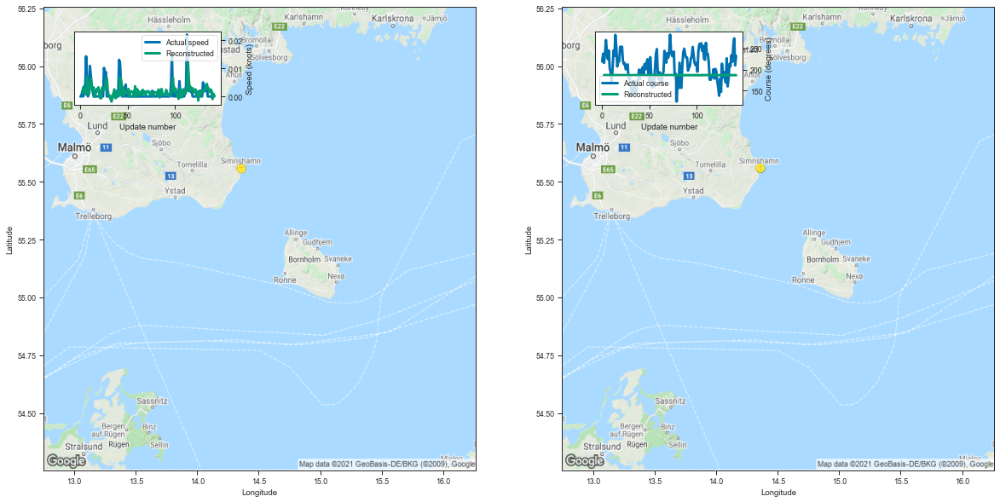

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360359  55.557812  0.001158  186.662277         0.001255   
3    14.360221  55.557930  0.003201  186.794937         0.001147   
4    14.360685  55.558128  0.002356  186.639709         0.000923   
5    14.360228  55.558273  0.001544  186.519989         0.000794   
6    14.359978  55.558483  0.000657  186.528076         0.000786   
..         ...        ...       ...         ...              ...   
138  14.360232  55.558285  0.002436  186.601868         0.000846   
139  14.360463  55.557709  0.002136  186.509277         0.000769   
140  14.360025  55.558403 -0.000951  186.532715         0.000778   
141  14.360518  55.557907  0.000973  186.446457         0.000713   
142  14.359591  55.558701  0.000249  186.413437         0.000684   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001249     0.004846     91.099726  
3          0.001064     0.009246     97.260674  
4          0.000864     0.005539    

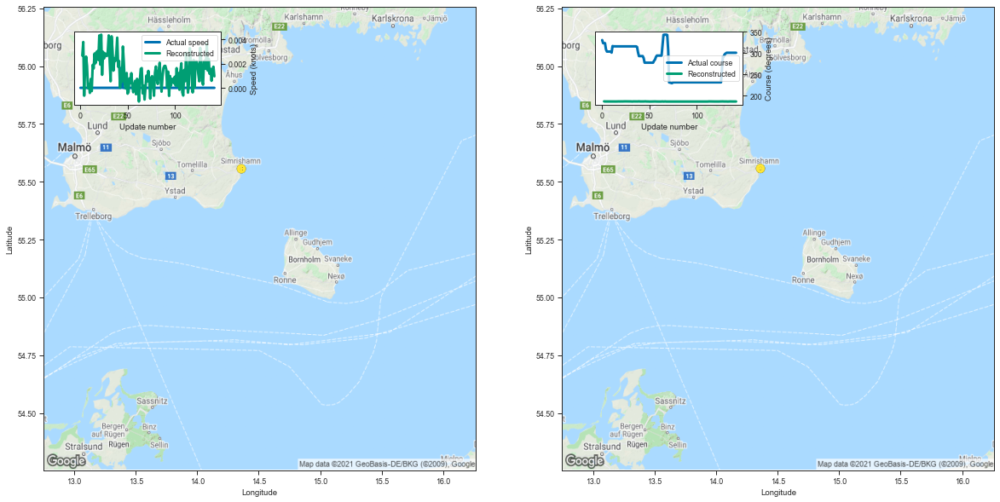

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360501  55.557095  0.002665  186.901199         0.001599   
3    14.360512  55.557461  0.003786  186.637634         0.000983   
4    14.360822  55.557201 -0.000649  186.620850         0.000897   
5    14.361079  55.557373  0.001763  186.571838         0.000837   
6    14.360859  55.557171  0.002582  186.650360         0.000900   
..         ...        ...       ...         ...              ...   
138  14.359997  55.557308  0.001570  186.596100         0.000840   
139  14.359897  55.557873  0.000582  186.565979         0.000813   
140  14.359953  55.558151  0.001494  186.685913         0.000918   
141  14.359955  55.557583  0.001747  186.529282         0.000791   
142  14.360282  55.557339  0.000953  186.582077         0.000823   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001544     0.011373     92.249338  
3          0.000934     0.005378     96.427297  
4          0.000840     0.005215    

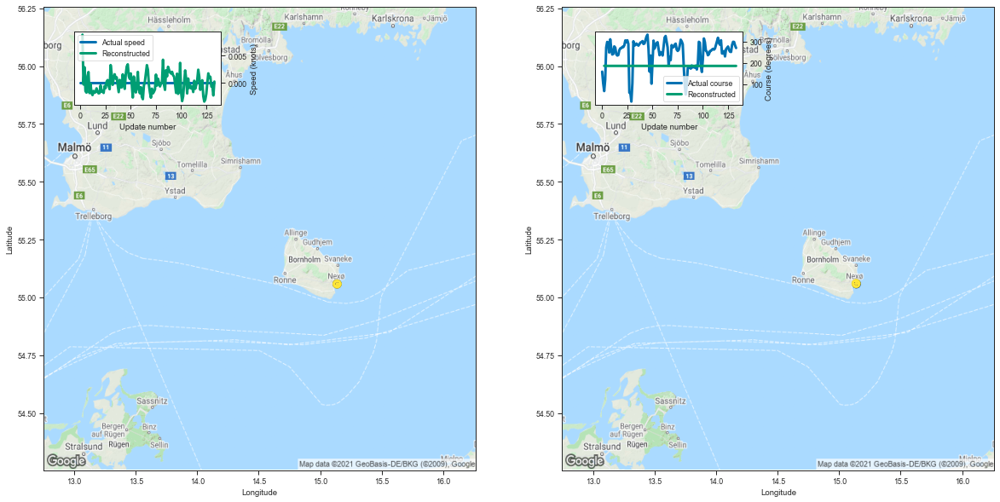

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139776  55.058655  0.008868  186.890015         0.002356   
3    15.139417  55.058876 -0.000312  186.663330         0.001426   
4    15.138747  55.059486  0.002878  186.453629         0.001070   
5    15.137506  55.060215 -0.001534  186.476318         0.001062   
6    15.138074  55.060043 -0.001812  186.476837         0.001055   
..         ...        ...       ...         ...              ...   
129  15.138927  55.059559  0.001100  186.461182         0.001038   
130  15.138227  55.059677 -0.000674  186.280960         0.000847   
131  15.137783  55.059662 -0.000568  186.272919         0.000824   
132  15.137594  55.060184 -0.002338  186.269257         0.000818   
133  15.137865  55.059734  0.000219  186.272263         0.000821   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002174     0.034453     95.198267  
3          0.001294     0.019326    100.639168  
4          0.000982     0.009568    

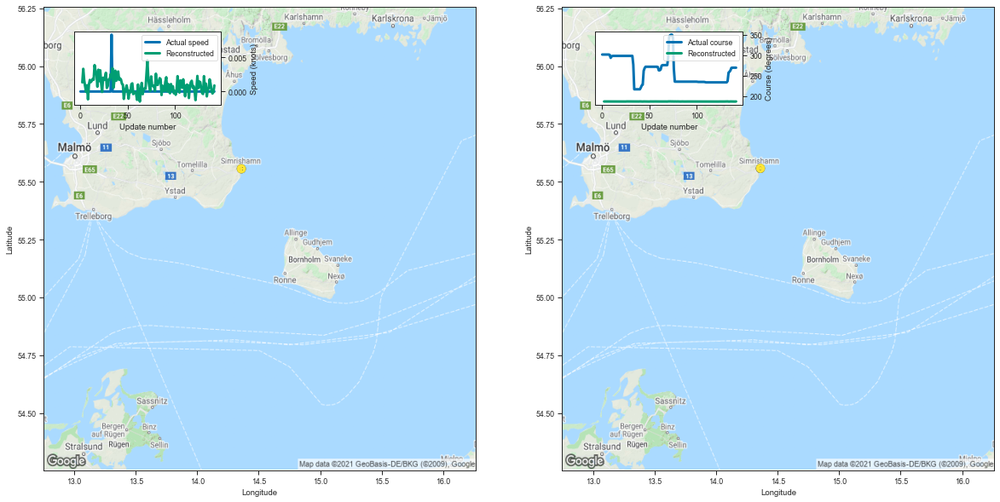

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359803  55.557587  0.001334  186.641678         0.001229   
3    14.360357  55.557461  0.003322  186.645767         0.000977   
4    14.360685  55.557247  0.001634  186.650757         0.000929   
5    14.360458  55.557800  0.000733  186.483948         0.000763   
6    14.360332  55.557339 -0.000051  186.478531         0.000743   
..         ...        ...       ...         ...              ...   
138  14.361106  55.557373  0.001108  186.699722         0.000938   
139  14.360591  55.557777  0.000098  186.601425         0.000850   
140  14.361213  55.556965 -0.000291  186.425308         0.000701   
141  14.360607  55.558315 -0.000102  186.417007         0.000687   
142  14.360610  55.558083  0.000886  186.663437         0.000892   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001230     0.004564     90.965438  
3          0.000922     0.005451     96.785629  
4          0.000865     0.005862    

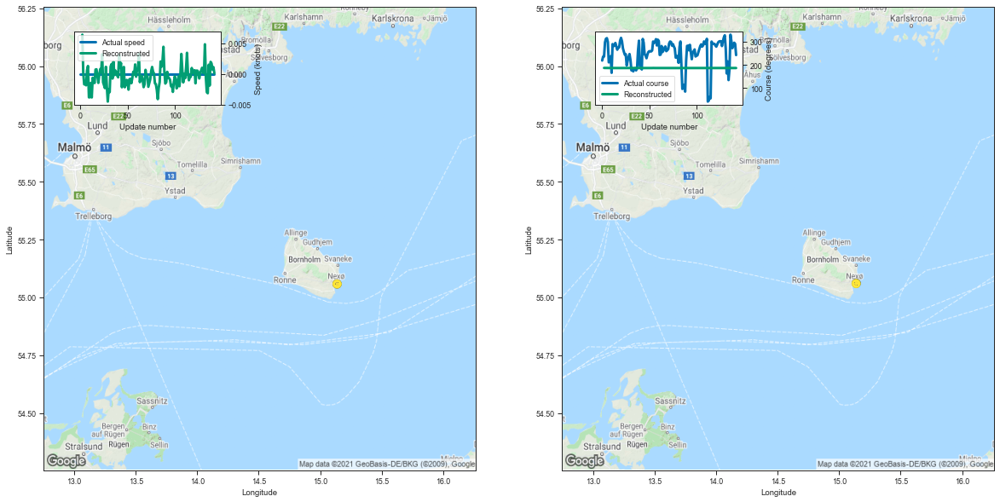

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139078  55.060612  0.006402  186.717697         0.001991   
3    15.139177  55.059643  0.000125  186.593170         0.001341   
4    15.138887  55.058941 -0.001723  186.421295         0.001034   
5    15.138633  55.059345 -0.001641  186.398148         0.000974   
6    15.138034  55.060028 -0.001874  186.287674         0.000855   
..         ...        ...       ...         ...              ...   
138  15.138838  55.058998  0.001946  186.322601         0.000874   
139  15.138847  55.059227  0.001693  186.372452         0.000918   
140  15.138161  55.059746  0.000706  186.337341         0.000889   
141  15.138364  55.059532  0.001091  186.360687         0.000908   
142  15.138283  55.059673  0.000074  186.356873         0.000906   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001883     0.017872     94.045815  
3          0.001227     0.014284    100.114953  
4          0.000952     0.008298    

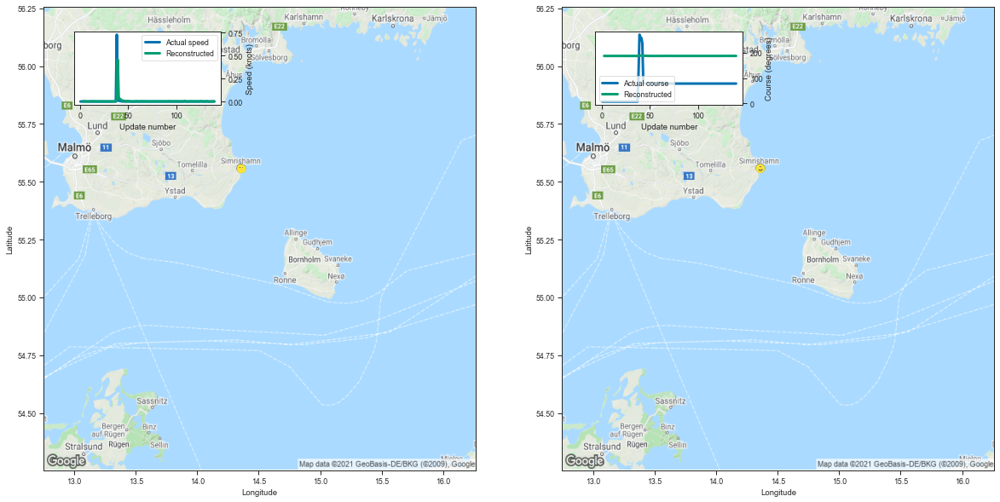

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359875  55.558437  0.002476  186.583771         0.001102   
3    14.359603  55.558357  0.002822  186.451172         0.000773   
4    14.359011  55.559341  0.001867  186.452988         0.000729   
5    14.359436  55.558132  0.003109  186.434494         0.000700   
6    14.359074  55.558899  0.001086  186.400696         0.000669   
..         ...        ...       ...         ...              ...   
136  14.359676  55.558590  0.001224  186.660614         0.000878   
137  14.359648  55.558464  0.000277  186.472977         0.000733   
138  14.359793  55.557835  0.001701  186.409088         0.000677   
139  14.359408  55.558327 -0.000043  186.404770         0.000671   
140  14.360143  55.557392  0.002481  186.563934         0.000795   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001091     0.003940     92.208594  
3          0.000738     0.002852     97.024008  
4          0.000686     0.003000    

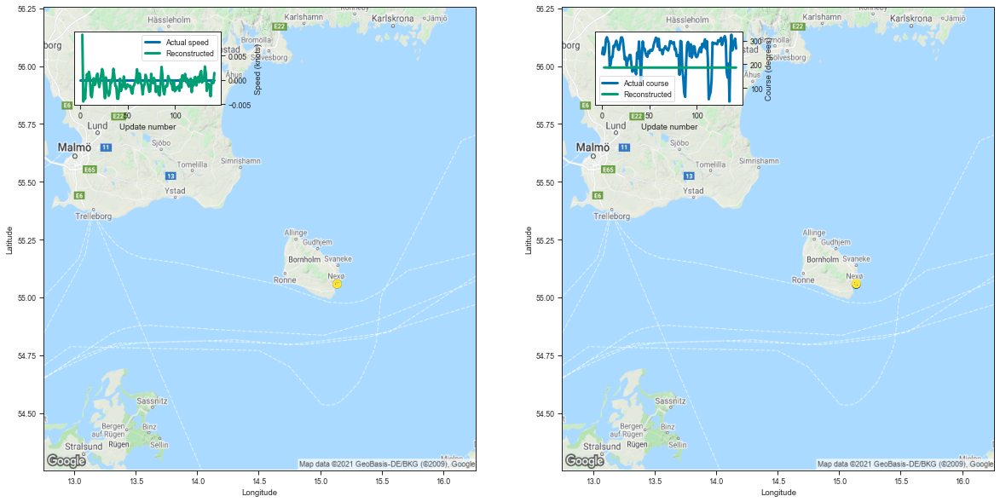

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.138772  55.056816  0.009268  186.667084         0.001906   
3    15.138147  55.058636 -0.004457  186.445129         0.001141   
4    15.137910  55.059631 -0.002645  186.308975         0.000904   
5    15.138740  55.058903 -0.003909  186.340088         0.000896   
6    15.138927  55.058773 -0.000604  186.449768         0.001010   
..         ...        ...       ...         ...              ...   
138  15.138976  55.059956 -0.003378  186.386841         0.000926   
139  15.138144  55.059715 -0.000340  186.280579         0.000838   
140  15.137833  55.059914 -0.000231  186.266891         0.000817   
141  15.138622  55.058834 -0.000657  186.449463         0.000992   
142  15.138918  55.059155  0.001412  186.286438         0.000850   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001815     0.014934     93.720162  
3          0.001063     0.008241     99.547860  
4          0.000841     0.005415    

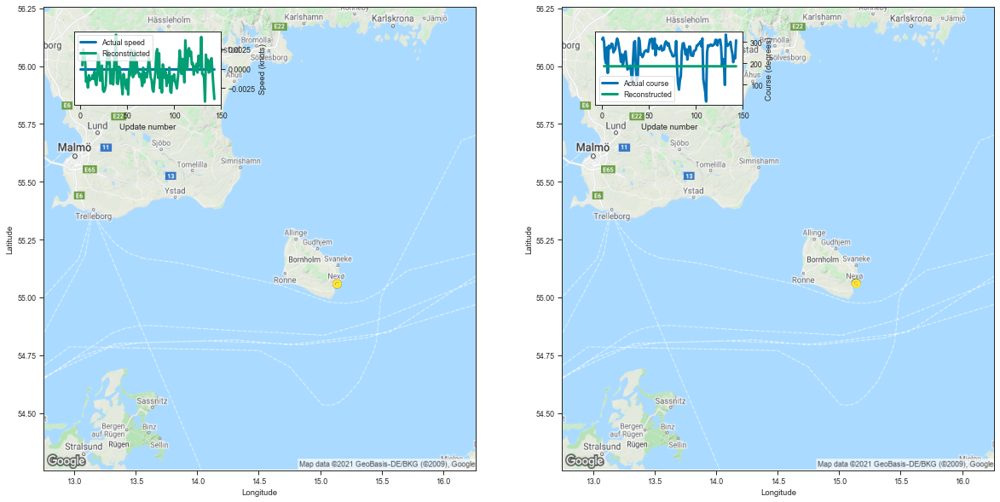

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.137753  55.061241  0.000431  186.767807         0.002065   
3    15.138151  55.060158  0.002501  186.565842         0.001307   
4    15.137892  55.060566  0.001759  186.469604         0.001091   
5    15.137581  55.061134  0.001036  186.473068         0.001058   
6    15.137624  55.060463 -0.001670  186.354141         0.000926   
..         ...        ...       ...         ...              ...   
139  15.138291  55.059593  0.001029  186.351791         0.000898   
140  15.138664  55.058826  0.001345  186.456345         0.001008   
141  15.138129  55.060337 -0.000527  186.276993         0.000840   
142  15.138741  55.059139 -0.002297  186.267136         0.000816   
143  15.138818  55.059456 -0.003887  186.264267         0.000810   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001936     0.022298     94.766649  
3          0.001201     0.013332     99.976394  
4          0.001002     0.009985    

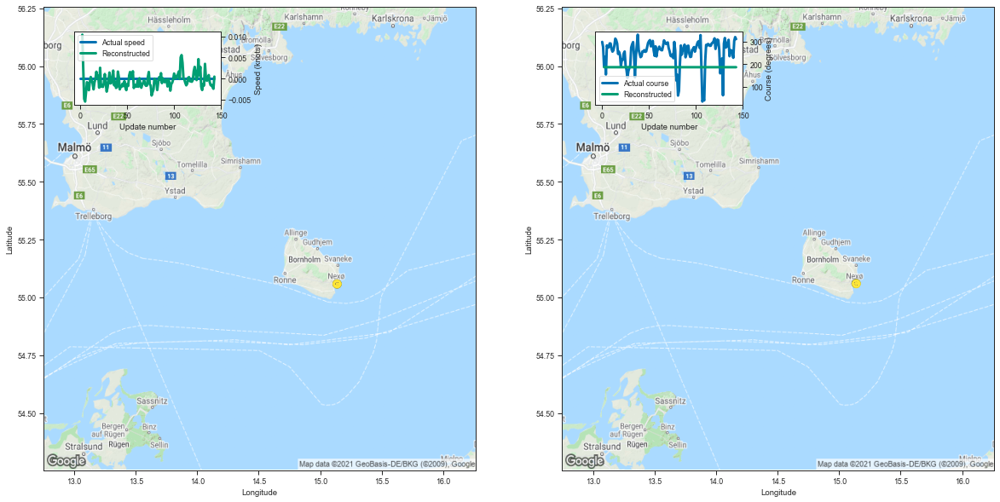

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.137795  55.059990  0.010423  186.527603         0.001622   
3    15.137936  55.060619  0.002313  186.354584         0.001017   
4    15.137895  55.059937 -0.004850  186.300552         0.000883   
5    15.138606  55.060204 -0.005486  186.275146         0.000831   
6    15.138037  55.059494 -0.003196  186.291855         0.000842   
..         ...        ...       ...         ...              ...   
139  15.138667  55.059227 -0.001595  186.312103         0.000856   
140  15.139288  55.058632 -0.001527  186.264832         0.000816   
141  15.138964  55.059208 -0.001965  186.263733         0.000809   
142  15.137931  55.059765 -0.002443  186.301193         0.000843   
143  15.139262  55.059101  0.000438  186.265350         0.000816   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001566     0.009317     93.574075  
3          0.000953     0.006044     99.775299  
4          0.000820     0.005230    

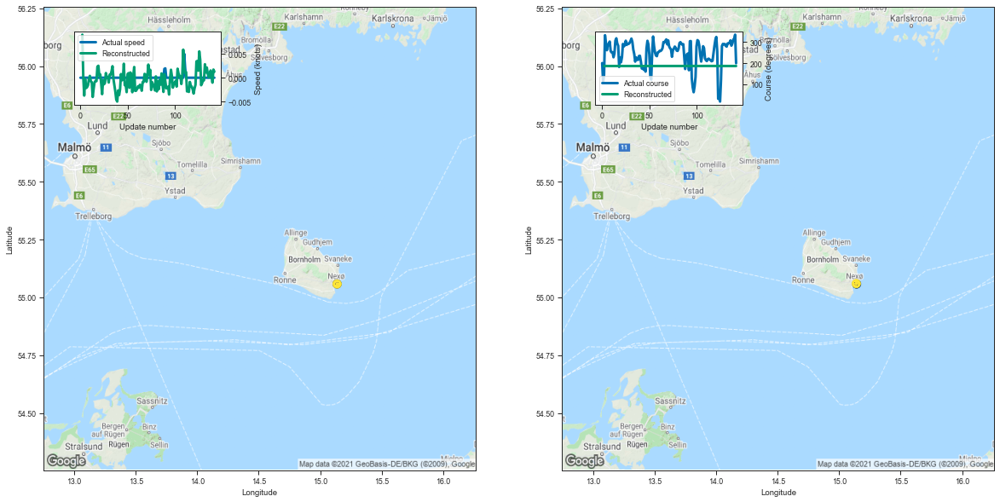

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.141784  55.057793  0.009021  186.563385         0.001704   
3    15.140945  55.058456  0.000245  186.399246         0.001068   
4    15.138291  55.059284 -0.003739  186.307877         0.000895   
5    15.137641  55.060036 -0.000310  186.309189         0.000872   
6    15.137560  55.060020 -0.002167  186.311218         0.000866   
..         ...        ...       ...         ...              ...   
138  15.137707  55.059830  0.001509  186.303192         0.000854   
139  15.138212  55.059532  0.000339  186.273285         0.000824   
140  15.138431  55.059647 -0.001034  186.405457         0.000947   
141  15.138959  55.059784  0.001704  186.337296         0.000894   
142  15.139373  55.059475  0.001271  186.273987         0.000831   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001639     0.011001     93.585371  
3          0.000995     0.007223     99.940285  
4          0.000831     0.005510    

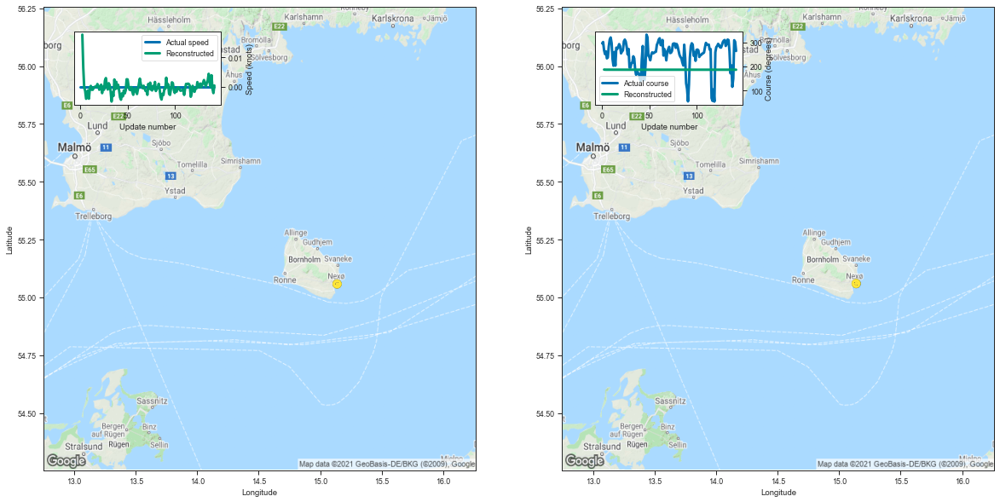

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139058  55.059475  0.017749  186.883453         0.002420   
3    15.138783  55.060024  0.006434  186.566711         0.001339   
4    15.138438  55.059849 -0.000448  186.428253         0.001047   
5    15.137696  55.060154 -0.001400  186.436768         0.001014   
6    15.138466  55.060108 -0.004201  186.305130         0.000873   
..         ...        ...       ...         ...              ...   
138  15.137882  55.060116 -0.000094  186.526703         0.001090   
139  15.138785  55.059204  0.003862  186.436096         0.000993   
140  15.138169  55.060349 -0.000792  186.436096         0.000984   
141  15.138049  55.059944 -0.002254  186.346786         0.000904   
142  15.138233  55.059658  0.000345  186.275482         0.000833   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002250     0.033270     94.365904  
3          0.001239     0.013441     99.378272  
4          0.000967     0.008520    

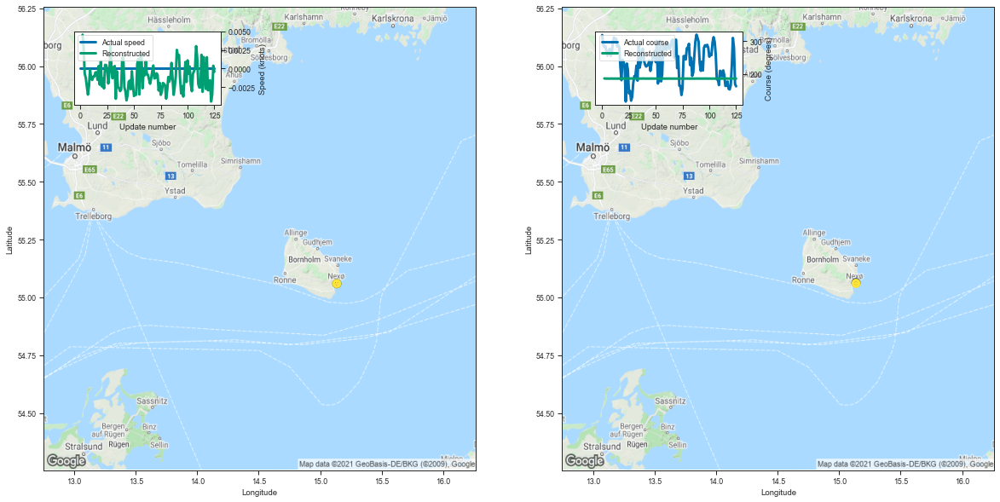

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.136546  55.062988  0.004570  186.831985         0.002245   
3    15.136528  55.061665  0.002717  186.464005         0.001187   
4    15.136585  55.060680 -0.000694  186.315521         0.000913   
5    15.137200  55.060333 -0.001249  186.386612         0.000945   
6    15.136702  55.060970 -0.002422  186.281250         0.000845   
..         ...        ...       ...         ...              ...   
121  15.137228  55.060497 -0.001565  186.324112         0.000870   
122  15.136333  55.061466 -0.004436  186.334808         0.000879   
123  15.137097  55.060604 -0.003479  186.269958         0.000821   
124  15.137004  55.060738  0.000380  186.296219         0.000841   
125  15.136925  55.060528 -0.000414  186.262146         0.000810   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002100     0.027078     94.421775  
3          0.001109     0.009189     99.211540  
4          0.000850     0.005655    

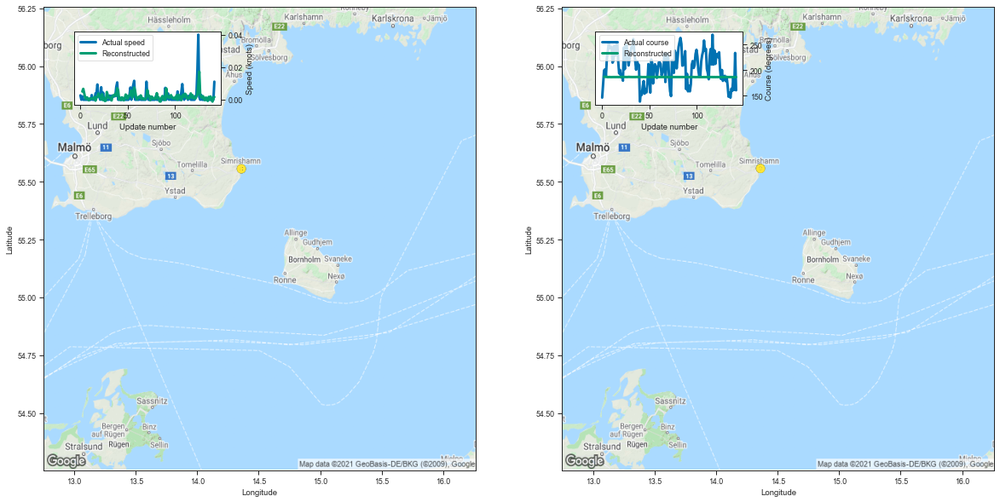

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360478  55.557552  0.005041  186.935562         0.001669   
3    14.360063  55.558372  0.006680  187.114853         0.001605   
4    14.360160  55.557552  0.003920  186.884933         0.001220   
5    14.360430  55.557243  0.001285  186.553009         0.000836   
6    14.360083  55.557255  0.000503  186.433853         0.000715   
..         ...        ...       ...         ...              ...   
138  14.359889  55.557335  0.001986  186.665985         0.000901   
139  14.359687  55.557217  0.000015  186.480362         0.000740   
140  14.360219  55.557755 -0.001120  186.505646         0.000757   
141  14.359620  55.557755  0.001153  186.413742         0.000686   
142  14.361032  55.557175  0.001685  186.529068         0.000768   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001605     0.012654     92.150973  
3          0.001435     0.026993     98.300982  
4          0.001118     0.013150    

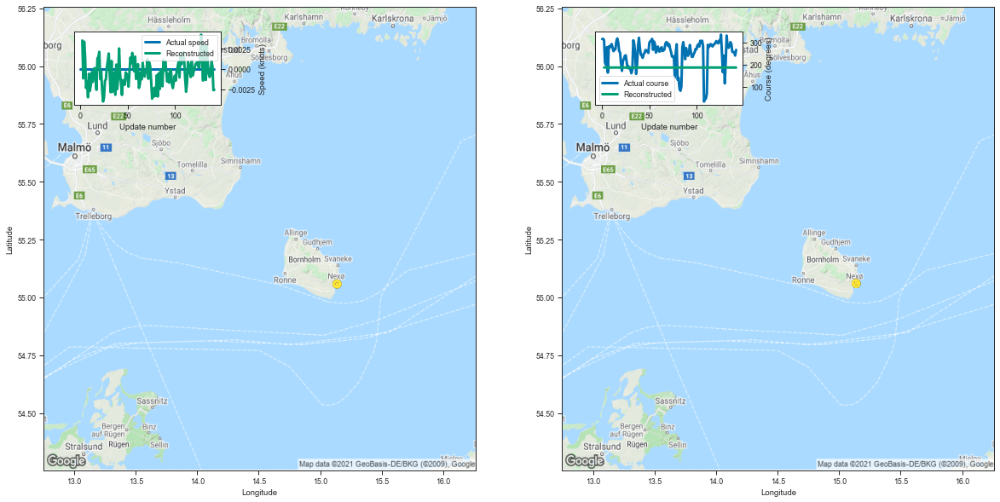

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139349  55.059902  0.003529  186.655014         0.001855   
3    15.138461  55.059937 -0.001154  186.528656         0.001241   
4    15.138281  55.060127  0.003385  186.425949         0.001033   
5    15.138097  55.060696  0.001381  186.407196         0.000982   
6    15.138239  55.059326 -0.002342  186.427292         0.000986   
..         ...        ...       ...         ...              ...   
138  15.138253  55.059299 -0.000525  186.265045         0.000814   
139  15.138639  55.059383  0.001009  186.263657         0.000813   
140  15.138618  55.059338  0.000325  186.263458         0.000812   
141  15.138499  55.059464 -0.002619  186.263519         0.000810   
142  15.138427  55.059780 -0.002563  186.370621         0.000904   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001764     0.015158     94.141677  
3          0.001143     0.011630    100.132110  
4          0.000950     0.008464    

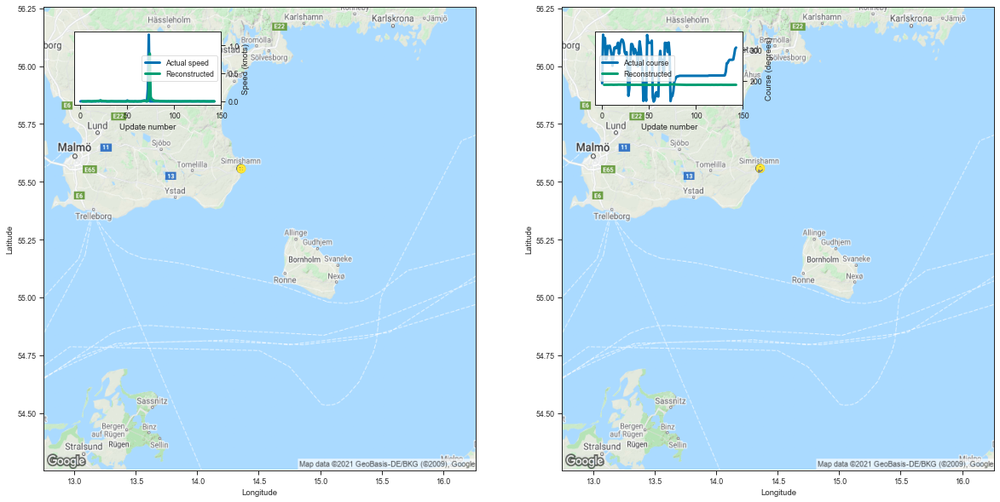

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.357509  55.557751  0.000875  186.641739         0.001214   
3    14.358277  55.558281 -0.000492  186.641525         0.000967   
4    14.358557  55.557827 -0.000461  186.626251         0.000899   
5    14.359179  55.558125  0.000841  186.532410         0.000801   
6    14.358652  55.557892 -0.000350  186.498825         0.000760   
..         ...        ...       ...         ...              ...   
139  14.360918  55.557541  0.000908  186.424393         0.000701   
140  14.360765  55.557991  0.001557  186.530594         0.000777   
141  14.360907  55.557476  0.001949  186.688309         0.000918   
142  14.361099  55.556877  0.001448  186.664124         0.000901   
143  14.360350  55.557617  0.001272  186.473221         0.000741   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001212     0.004638     91.288995  
3          0.000914     0.005392     96.880327  
4          0.000837     0.005333    

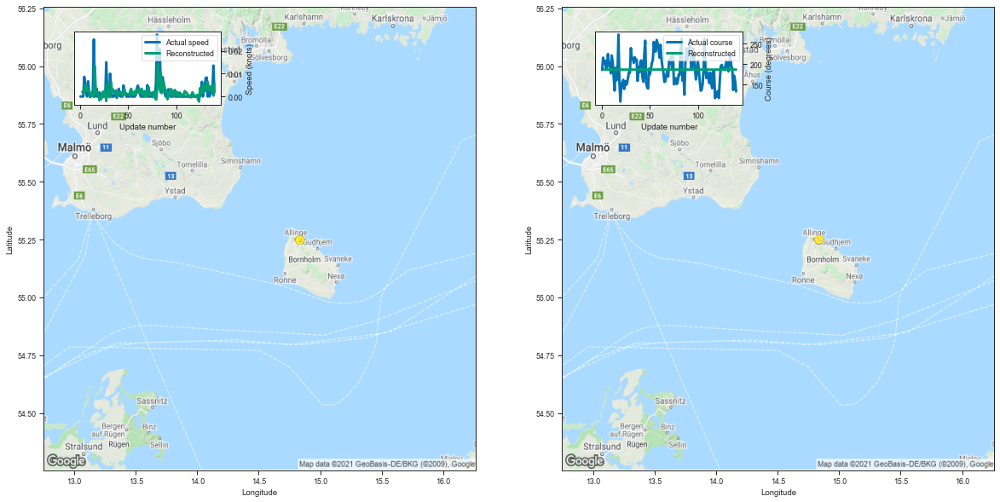

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836623  55.248672  0.002057  186.809052         0.001885   
3    14.837734  55.249554  0.001607  186.592026         0.001176   
4    14.837590  55.249302  0.002001  186.519623         0.001001   
5    14.837263  55.250504  0.004884  186.476364         0.000929   
6    14.838046  55.249832  0.005017  186.349960         0.000801   
..         ...        ...       ...         ...              ...   
136  14.836944  55.250061  0.002699  186.483185         0.000909   
137  14.837190  55.249920  0.004592  186.574188         0.001001   
138  14.836226  55.250328  0.003183  186.476929         0.000907   
139  14.837358  55.249298  0.000395  186.518631         0.000943   
140  14.836403  55.249538  0.005450  186.399963         0.000838   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001797     0.015491     93.133819  
3          0.001092     0.008667     98.341258  
4          0.000921     0.007092    

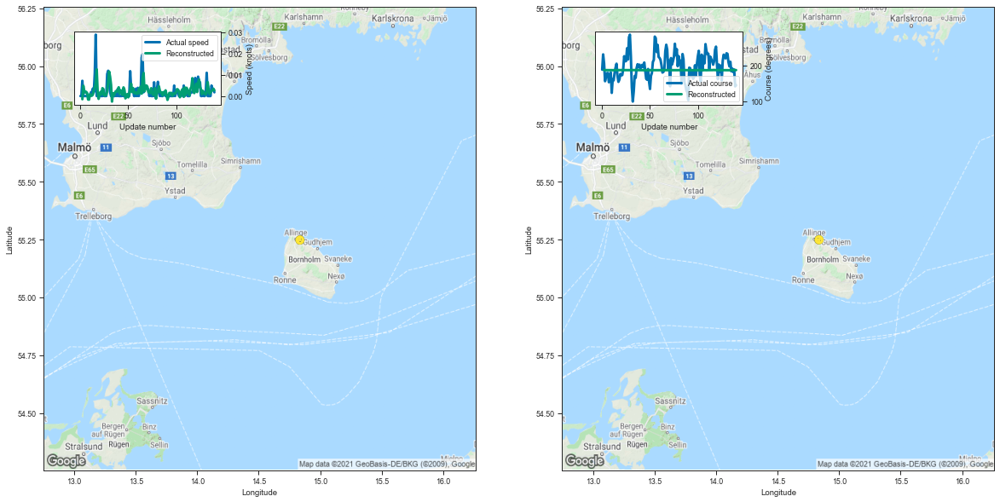

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.835596  55.249165 -0.001486  186.631699         0.001539   
3    14.836385  55.250492  0.004823  186.401978         0.000943   
4    14.836104  55.249710  0.002478  186.426498         0.000885   
5    14.837284  55.248711  0.001555  186.552261         0.000990   
6    14.837292  55.249481  0.001971  186.395172         0.000843   
..         ...        ...       ...         ...              ...   
136  14.836887  55.250500  0.001837  186.476135         0.000899   
137  14.837197  55.250301  0.002366  186.489944         0.000915   
138  14.837062  55.250179  0.002708  186.613037         0.001044   
139  14.837679  55.249653  0.003407  186.438431         0.000879   
140  14.836682  55.249073  0.002659  186.606979         0.001017   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001497     0.008108     92.707917  
3          0.000891     0.004314     98.077322  
4          0.000816     0.004975    

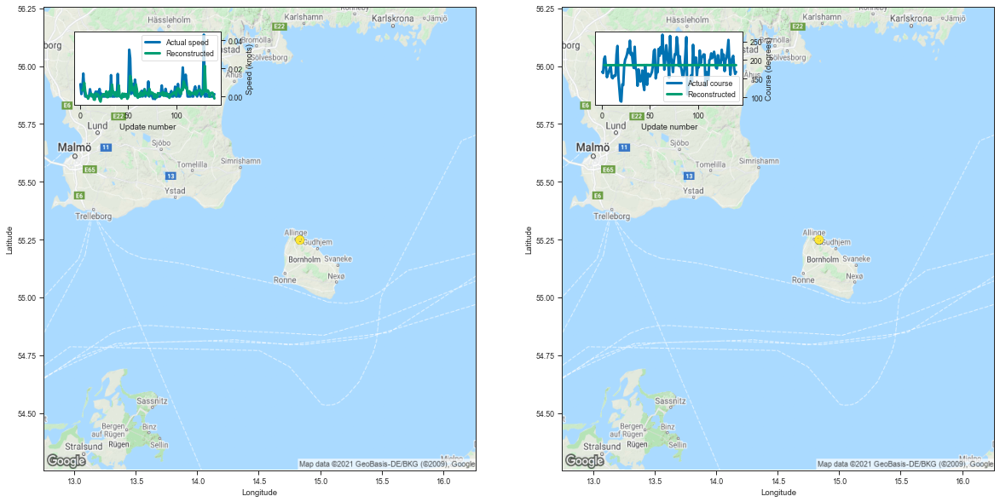

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.837633  55.247608  0.004361  186.870132         0.002025   
3    14.837563  55.249119  0.005243  186.421494         0.000989   
4    14.837175  55.249752  0.009791  186.546844         0.001019   
5    14.836771  55.250053  0.003648  186.476120         0.000930   
6    14.836944  55.248779  0.000154  186.417374         0.000855   
..         ...        ...       ...         ...              ...   
136  14.836709  55.249973  0.001737  186.537308         0.000958   
137  14.836887  55.249924  0.002627  186.524734         0.000953   
138  14.836828  55.249344  0.002680  186.601044         0.001026   
139  14.836938  55.250420  0.001117  186.480103         0.000918   
140  14.836734  55.249329 -0.001417  186.483673         0.000903   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001916     0.019245     93.215607  
3          0.000939     0.004691     97.490584  
4          0.000930     0.007855    

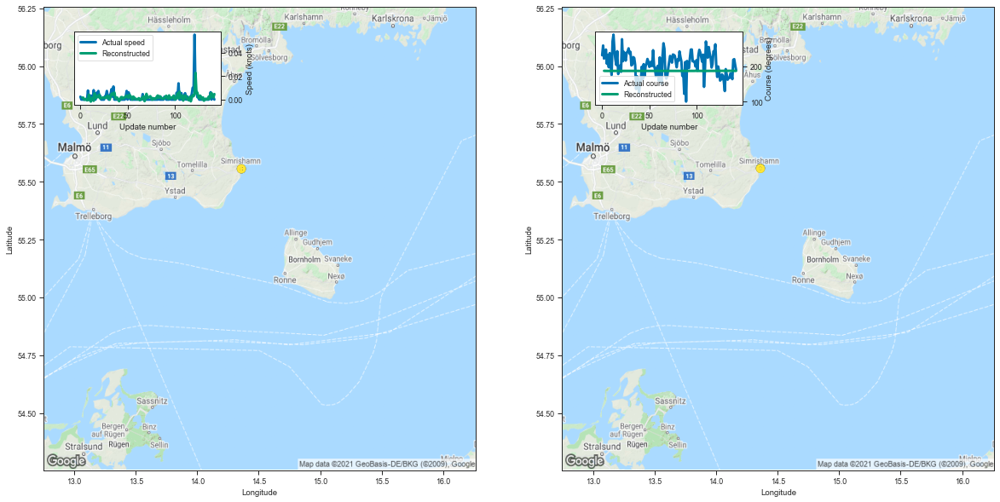

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360240  55.558189  0.001702  186.698227         0.001302   
3    14.359425  55.557842  0.001598  186.521317         0.000861   
4    14.360605  55.557640 -0.000069  186.486557         0.000773   
5    14.360003  55.557255  0.000075  186.573227         0.000829   
6    14.359699  55.558033  0.000608  186.423615         0.000704   
..         ...        ...       ...         ...              ...   
138  14.360742  55.557823  0.004769  186.796158         0.001027   
139  14.360513  55.557621  0.005620  186.939987         0.001207   
140  14.360649  55.556770  0.002294  186.755096         0.001021   
141  14.360420  55.556835  0.001840  186.501404         0.000771   
142  14.360334  55.557320  0.004712  186.698456         0.000936   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001292     0.005571     91.264666  
3          0.000825     0.003439     96.157103  
4          0.000731     0.003167    

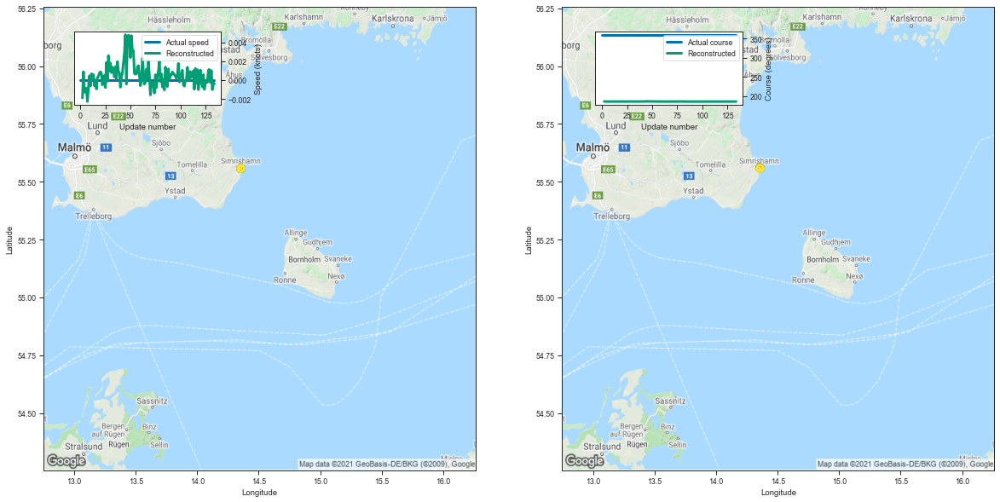

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.356998  55.559265 -0.001895  186.611603         0.001165   
3    14.357034  55.558601  0.000896  186.521530         0.000846   
4    14.357208  55.559002 -0.001135  186.442261         0.000733   
5    14.357208  55.558418 -0.001310  186.470367         0.000737   
6    14.356953  55.558628 -0.000857  186.422958         0.000696   
..         ...        ...       ...         ...              ...   
130  14.356898  55.558681 -0.000252  186.416672         0.000685   
131  14.357109  55.558167  0.001011  186.446457         0.000704   
132  14.356311  55.558975 -0.001007  186.416092         0.000684   
133  14.357039  55.558353 -0.000280  186.535675         0.000773   
134  14.357109  55.558315 -0.000386  186.525803         0.000771   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001165     0.004142     91.371719  
3          0.000809     0.003544     96.646540  
4          0.000696     0.002763    

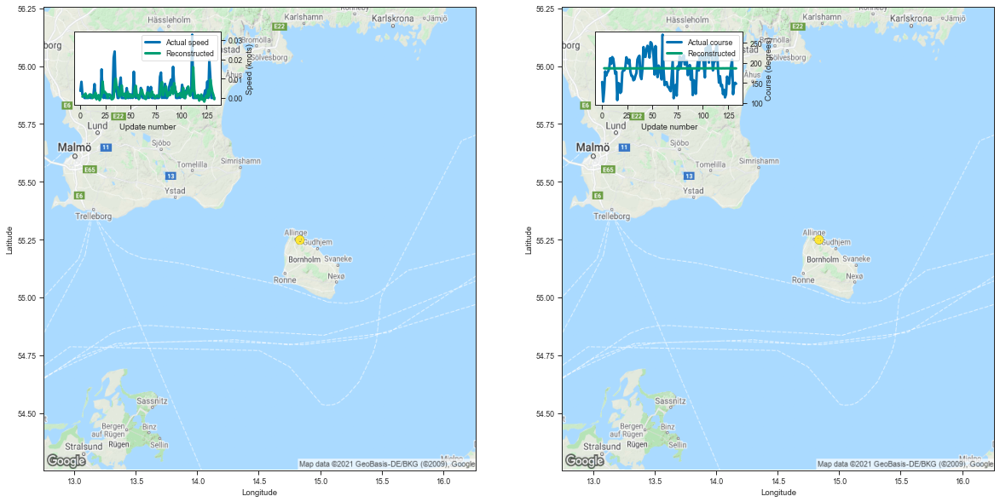

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.837715  55.248962  0.000656  186.630447         0.001541   
3    14.836743  55.250198  0.001211  186.456192         0.000993   
4    14.836944  55.250252  0.001429  186.464996         0.000930   
5    14.837534  55.248890  0.002288  186.575333         0.001022   
6    14.837054  55.249683  0.000155  186.395157         0.000841   
..         ...        ...       ...         ...              ...   
129  14.837215  55.250805  0.009507  186.643478         0.001092   
130  14.837295  55.249714  0.006114  186.442490         0.000891   
131  14.837177  55.249664  0.003092  186.453949         0.000878   
132  14.836658  55.249538  0.001573  186.506622         0.000925   
133  14.836499  55.249378 -0.000666  186.350327         0.000789   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001497     0.008141     92.722299  
3          0.000931     0.005245     98.389170  
4          0.000857     0.005721    

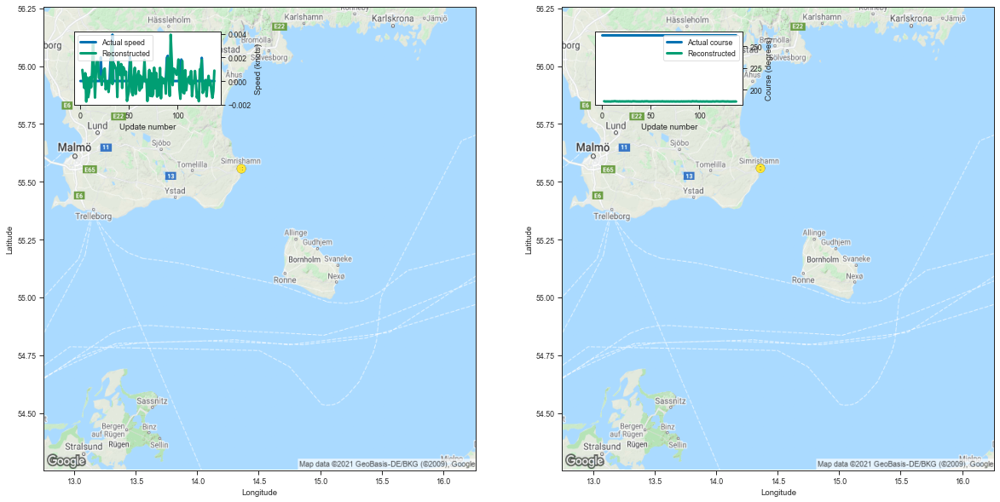

     Longitude   Latitude         Speed      Course  Longitude sigma  \
2    14.360571  55.558479  9.393692e-04  186.823532         0.001475   
3    14.360556  55.557644  7.867813e-05  186.485886         0.000834   
4    14.361248  55.557499 -5.884171e-04  186.566605         0.000839   
5    14.360119  55.558659  6.632805e-04  186.549164         0.000812   
6    14.360316  55.558460 -1.736403e-03  186.551270         0.000804   
..         ...        ...           ...         ...              ...   
134  14.360237  55.558174 -7.152557e-07  186.424332         0.000692   
135  14.361156  55.557468 -8.621216e-04  186.517685         0.000759   
136  14.360510  55.558361 -1.415014e-03  186.448578         0.000712   
137  14.360955  55.557629 -8.459091e-04  186.543961         0.000781   
138  14.360657  55.557880  8.811951e-04  186.442505         0.000708   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001438     0.008396     91.828368  
3          0.000805     0.003039     

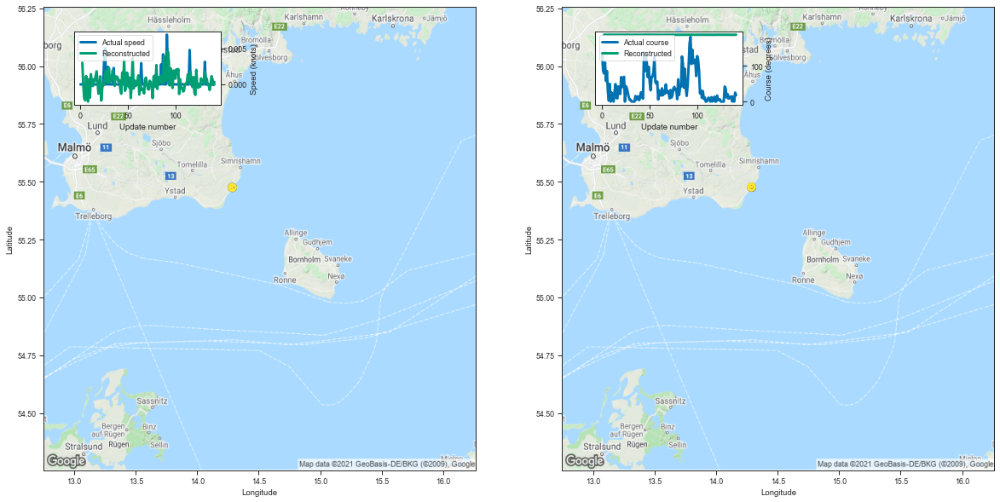

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.288257  55.476257  0.002987  186.670197         0.001186   
3    14.287408  55.477203 -0.000074  186.823288         0.001112   
4    14.288061  55.476990 -0.001948  186.686050         0.000925   
5    14.287763  55.476578 -0.002200  186.672424         0.000879   
6    14.288955  55.476112  0.001146  186.599670         0.000818   
..         ...        ...       ...         ...              ...   
137  14.287460  55.477230 -0.000056  186.464844         0.000683   
138  14.287583  55.476658  0.001135  186.563507         0.000756   
139  14.287809  55.476818  0.000668  186.467621         0.000689   
140  14.286830  55.477364 -0.000095  186.463028         0.000680   
141  14.287472  55.477139  0.000339  186.688858         0.000864   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001157     0.004413     92.443099  
3          0.001012     0.008915     98.528762  
4          0.000847     0.005745    

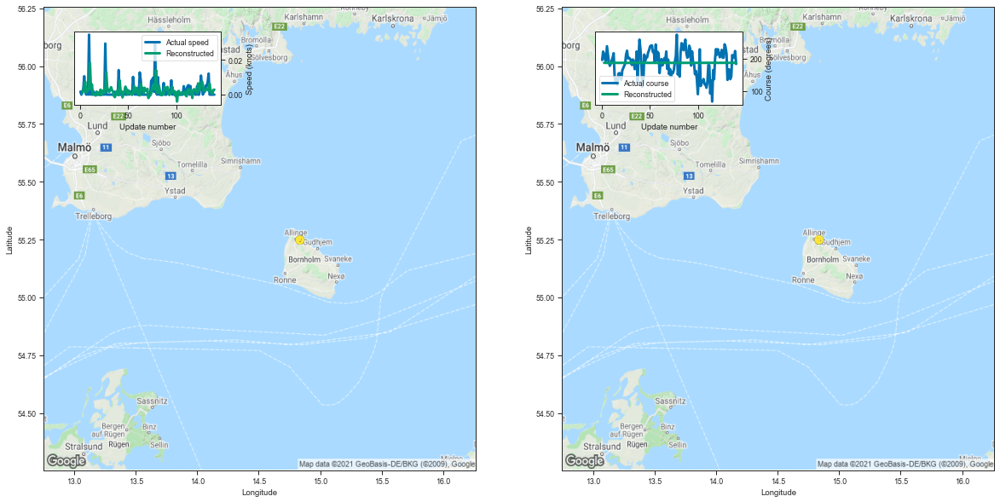

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.837442  55.248066  0.000884  186.624466         0.001556   
3    14.836091  55.250248  0.002319  186.567780         0.001125   
4    14.837207  55.250130  0.005205  186.547821         0.001035   
5    14.837745  55.249630  0.007407  186.429306         0.000886   
6    14.836894  55.248825  0.001182  186.374969         0.000818   
..         ...        ...       ...         ...              ...   
136  14.836414  55.249184  0.002567  186.398712         0.000822   
137  14.837075  55.249603  0.000829  186.454727         0.000875   
138  14.836924  55.250011  0.000592  186.322617         0.000765   
139  14.836684  55.250648  0.002721  186.511215         0.000928   
140  14.837107  55.248760  0.002872  186.562164         0.000991   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001521     0.007990     92.262713  
3          0.001044     0.007902     98.643594  
4          0.000946     0.007980    

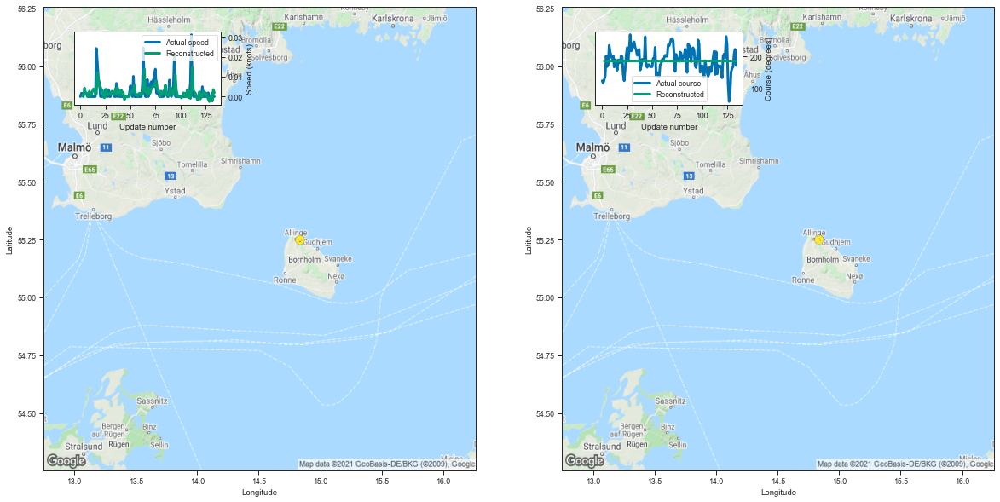

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836570  55.249809  0.000669  186.579178         0.001431   
3    14.835997  55.250835 -0.000096  186.610886         0.001154   
4    14.836935  55.248688  0.004348  186.623703         0.001105   
5    14.837373  55.249702  0.001926  186.487640         0.000945   
6    14.837071  55.249363  0.001807  186.347000         0.000798   
..         ...        ...       ...         ...              ...   
130  14.837373  55.248413  0.000134  186.435654         0.000858   
131  14.836968  55.249119  0.000524  186.472565         0.000894   
132  14.836404  55.249825 -0.002243  186.354004         0.000791   
133  14.837265  55.249264  0.003581  186.495544         0.000916   
134  14.836486  55.249310  0.001867  186.325485         0.000770   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001388     0.006725     93.086769  
3          0.001059     0.008958     99.231741  
4          0.000997     0.010099    

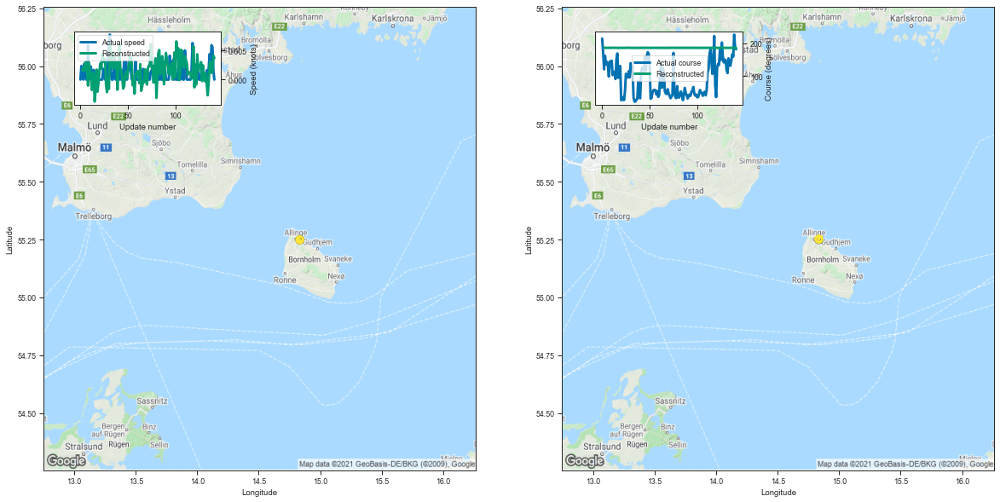

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.835761  55.250599  0.001539  186.782120         0.001813   
3    14.835658  55.251530  0.002016  186.521027         0.001079   
4    14.835361  55.250145  0.001508  186.512741         0.000985   
5    14.834336  55.251362  0.002937  186.529816         0.000973   
6    14.834866  55.251316  0.002999  186.595856         0.001039   
..         ...        ...       ...         ...              ...   
137  14.834612  55.251034  0.003113  186.402161         0.000817   
138  14.835297  55.250568  0.001157  186.454849         0.000874   
139  14.835495  55.249996  0.001441  186.484802         0.000906   
140  14.835195  55.250931  0.004038  186.671234         0.001108   
141  14.835619  55.251698  0.003698  186.342087         0.000797   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001729     0.013673     93.180709  
3          0.001008     0.006683     98.320471  
4          0.000904     0.006867    

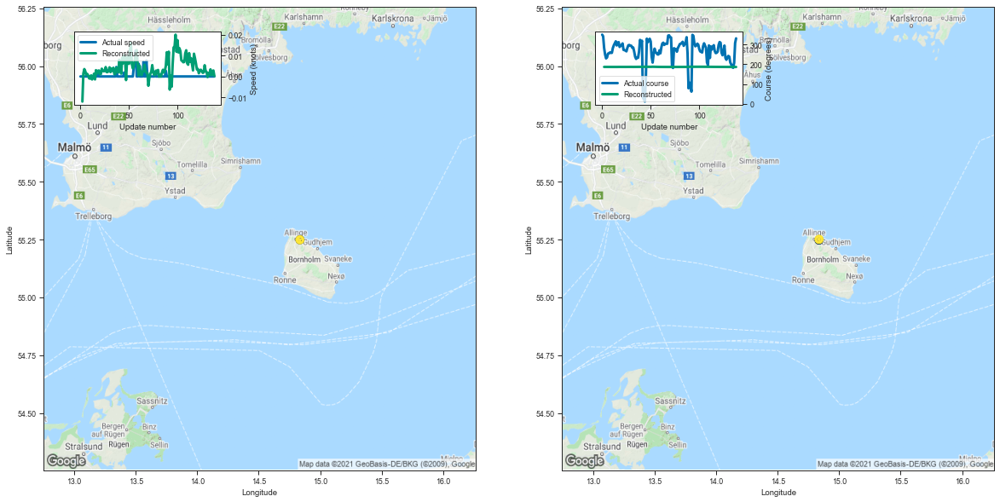

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836622  55.247864 -0.012077  186.641907         0.001541   
3    14.837659  55.250492  0.001412  186.672546         0.001237   
4    14.836370  55.250713  0.003534  186.421326         0.000904   
5    14.836912  55.249958  0.002514  186.370102         0.000821   
6    14.836205  55.250561  0.000771  186.443726         0.000872   
..         ...        ...       ...         ...              ...   
134  14.836834  55.250595  0.003405  186.371460         0.000797   
135  14.836857  55.251553  0.000541  186.348587         0.000779   
136  14.837227  55.250626  0.002465  186.313858         0.000750   
137  14.836924  55.250031  0.002863  186.382553         0.000803   
138  14.836779  55.250862  0.000174  186.317535         0.000754   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001504     0.008601     92.835503  
3          0.001134     0.011401     99.302691  
4          0.000843     0.004968    

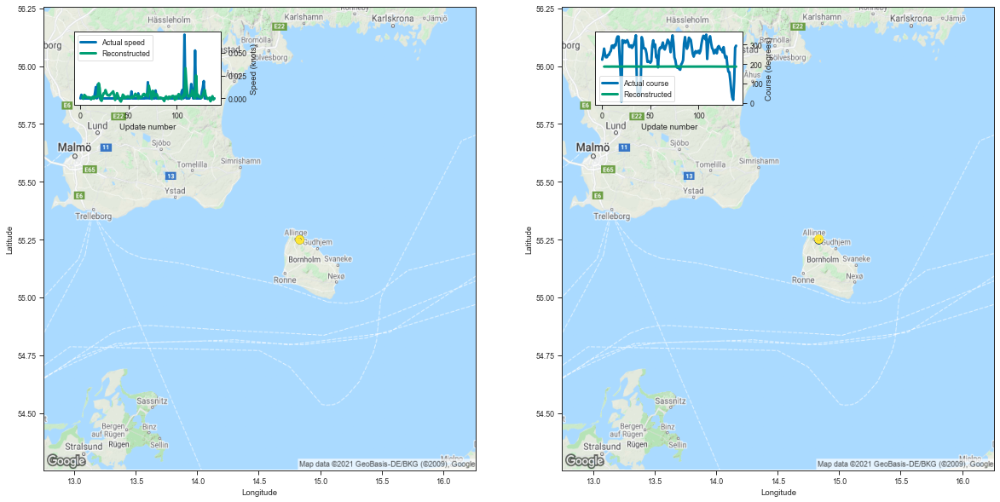

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.835609  55.248974  0.001780  186.550705         0.001414   
3    14.835014  55.251617 -0.000380  186.665695         0.001223   
4    14.835321  55.250286  0.003900  186.402908         0.000887   
5    14.835253  55.250336  0.002983  186.602295         0.001045   
6    14.834931  55.250324  0.001717  186.340729         0.000800   
..         ...        ...       ...         ...              ...   
135  14.834675  55.251232 -0.003085  186.428772         0.000833   
136  14.834689  55.250725  0.000104  186.303604         0.000729   
137  14.835820  55.250519  0.002474  186.406158         0.000806   
138  14.835853  55.251171 -0.001309  186.344101         0.000775   
139  14.835712  55.251717 -0.000021  186.487976         0.000907   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001386     0.006069     92.479310  
3          0.001117     0.010830     99.424737  
4          0.000827     0.004630    

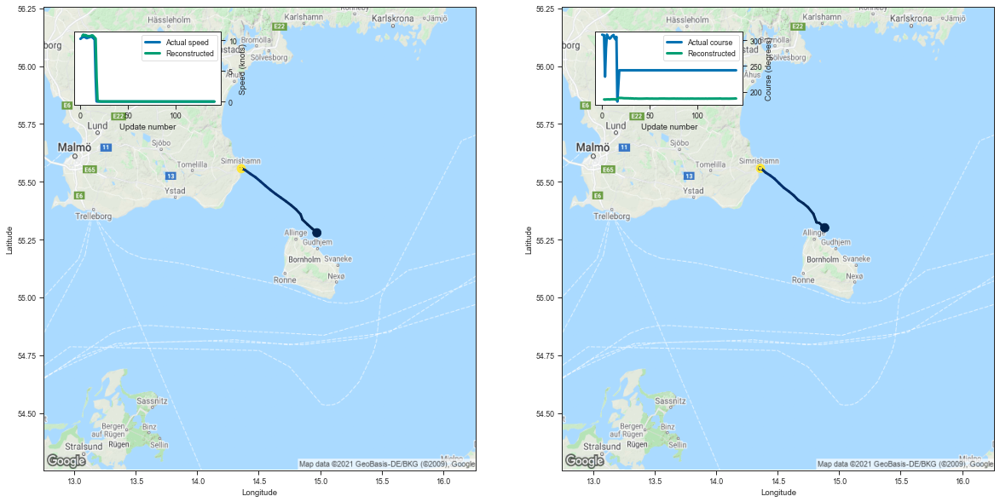

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.883001  55.301086  10.758503  184.983658         0.022550   
3    14.838213  55.321758  10.954121  184.623596         0.012747   
4    14.816424  55.324223  10.811005  184.940887         0.015400   
5    14.790647  55.361172  10.892824  185.028992         0.016934   
6    14.746588  55.389847  10.841282  185.170029         0.018479   
..         ...        ...        ...         ...              ...   
137  14.359866  55.558464  -0.000267  186.527496         0.000785   
138  14.359940  55.558022   0.001198  186.523041         0.000772   
139  14.360291  55.557873  -0.000191  186.633087         0.000868   
140  14.360472  55.558315   0.001359  186.878326         0.001126   
141  14.360367  55.557899   0.000505  186.654053         0.000910   

     Latitude sigma  Speed sigma  Course sigma  
2          0.013992     0.866636     91.507439  
3          0.008303     0.425384     95.242808  
4          0.009576     

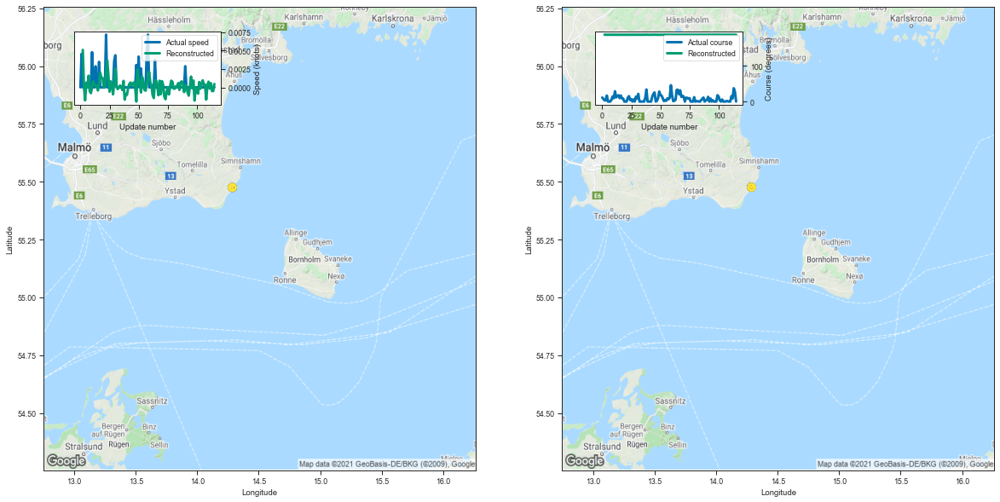

     Longitude   Latitude         Speed      Course  Longitude sigma  \
2    14.286560  55.476574  5.075455e-03  186.741913         0.001244   
3    14.287076  55.477001  2.403259e-04  186.525391         0.000804   
4    14.287256  55.476772 -1.761913e-03  186.486099         0.000723   
5    14.287579  55.476200  6.275177e-04  186.506088         0.000726   
6    14.287249  55.476856 -4.768372e-07  186.516861         0.000726   
..         ...        ...           ...         ...              ...   
111  14.287926  55.475906 -1.692772e-04  186.544861         0.000743   
112  14.287311  55.477024  5.688667e-04  186.474457         0.000694   
113  14.287760  55.476692 -5.049706e-04  186.492065         0.000701   
114  14.287537  55.476936 -4.982948e-04  186.467773         0.000688   
115  14.287790  55.476353  4.563332e-04  186.609680         0.000797   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001195     0.006121     93.629125  
3          0.000757     0.003277     

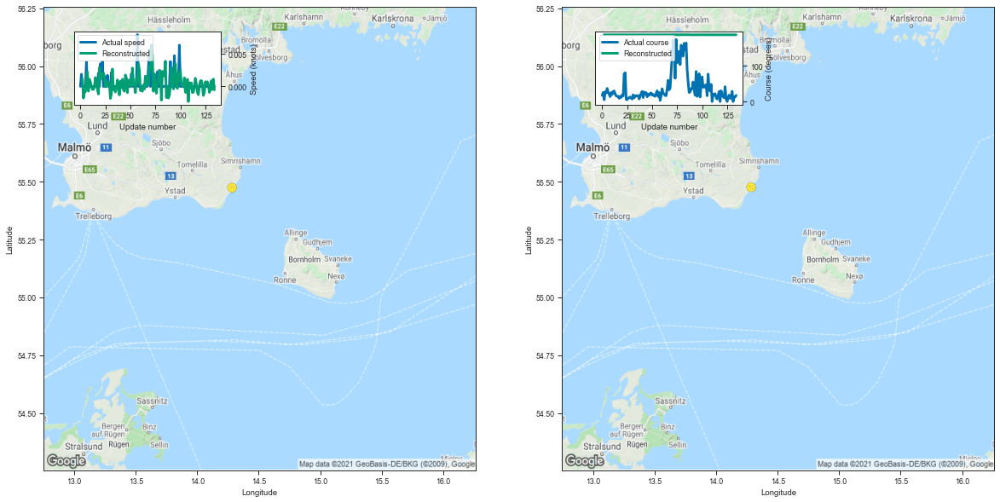

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.284533  55.476173  0.001121  186.708755         0.001216   
3    14.284092  55.475861 -0.001803  186.531052         0.000806   
4    14.285036  55.476078 -0.000879  186.550079         0.000776   
5    14.285705  55.474911 -0.000830  186.560547         0.000770   
6    14.285836  55.474869  0.001526  186.559021         0.000767   
..         ...        ...       ...         ...              ...   
130  14.285126  55.475922 -0.000534  186.634079         0.000823   
131  14.285031  55.475574  0.000885  186.568741         0.000771   
132  14.284666  55.475933 -0.000471  186.631805         0.000821   
133  14.285242  55.475330  0.001130  186.532379         0.000741   
134  14.284392  55.476307 -0.000521  186.529099         0.000734   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001181     0.005360     93.022269  
3          0.000759     0.003307     97.846914  
4          0.000718     0.003666    

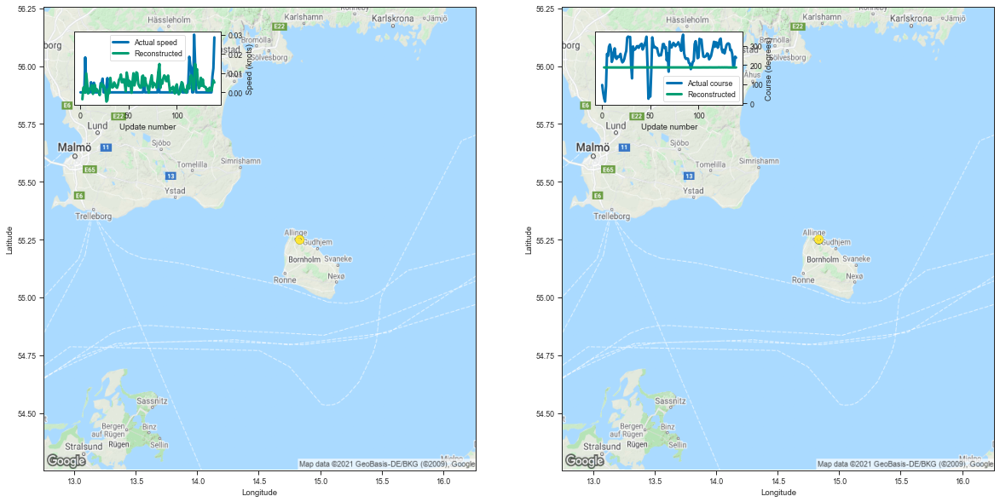

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.835796  55.249134 -0.003593  186.652802         0.001542   
3    14.834753  55.251038  0.002370  186.382080         0.000894   
4    14.835541  55.250454  0.002843  186.426147         0.000856   
5    14.836091  55.250526 -0.000194  186.601440         0.001033   
6    14.836319  55.250496  0.009810  186.578323         0.001034   
..         ...        ...       ...         ...              ...   
135  14.835578  55.251007  0.002290  186.336304         0.000789   
136  14.835353  55.251949  0.000868  186.473267         0.000890   
137  14.836088  55.250679  0.003496  186.364655         0.000802   
138  14.836272  55.250870  0.006282  186.555023         0.000975   
139  14.835259  55.250549  0.005097  186.491302         0.000924   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001487     0.009128     93.443274  
3          0.000841     0.004279     98.961167  
4          0.000784     0.005372    

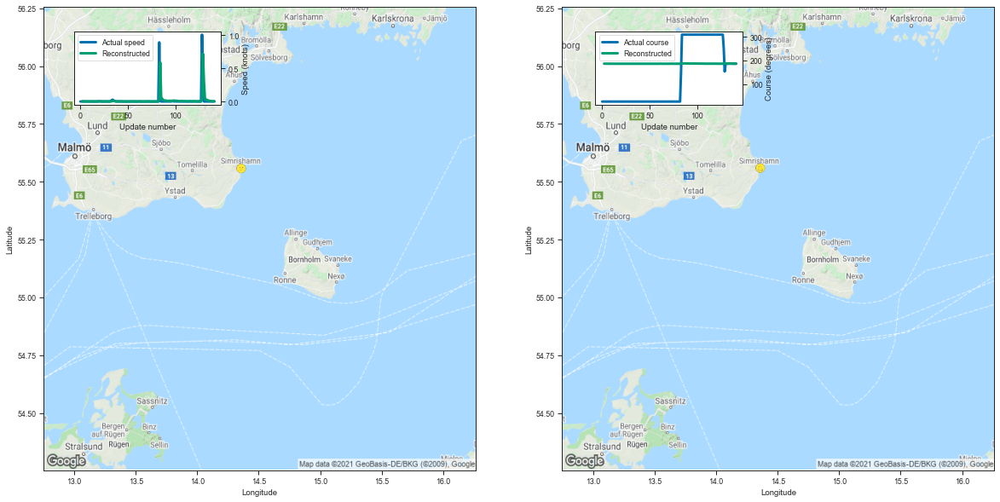

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359046  55.559132 -0.000258  186.765182         0.001355   
3    14.359495  55.558998  0.002372  186.720047         0.001044   
4    14.359263  55.558796  0.001122  186.609818         0.000879   
5    14.358891  55.558895  0.001275  186.629791         0.000877   
6    14.359050  55.558613  0.000901  186.501022         0.000755   
..         ...        ...       ...         ...              ...   
137  14.359691  55.560120  0.008829  187.440674         0.002221   
138  14.358541  55.559704  0.004160  187.186249         0.001712   
139  14.358211  55.559311  0.002784  186.901749         0.001238   
140  14.359791  55.558361  0.004083  186.687561         0.000959   
141  14.359707  55.558964  0.004214  186.847931         0.001104   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001320     0.007451     92.462698  
3          0.000972     0.007488     97.605772  
4          0.000819     0.005294    

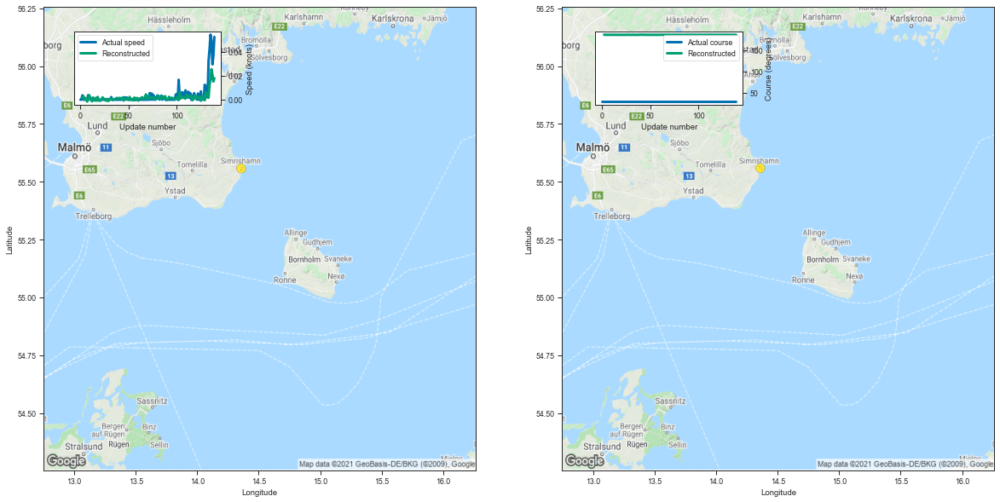

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359529  55.558693  0.001501  186.735062         0.001330   
3    14.359681  55.557934  0.003139  186.507660         0.000833   
4    14.358828  55.559193  0.000180  186.514145         0.000784   
5    14.358623  55.558849  0.001341  186.594101         0.000833   
6    14.358733  55.558910  0.000547  186.621124         0.000855   
..         ...        ...       ...         ...              ...   
135  14.359612  55.558346  0.017056  186.681534         0.000908   
136  14.358996  55.558887  0.025499  186.760391         0.001004   
137  14.359282  55.558800  0.020756  186.454620         0.000731   
138  14.360176  55.557903  0.015228  186.511032         0.000758   
139  14.359205  55.558582  0.018007  186.432556         0.000701   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001303     0.006745     92.084768  
3          0.000796     0.003482     96.731239  
4          0.000736     0.003717    

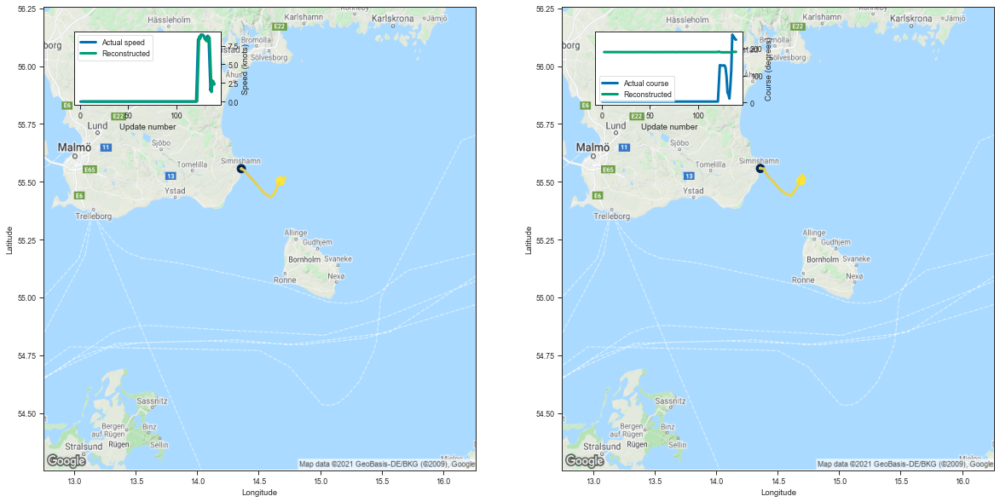

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360044  55.557457  0.002555  186.568710         0.001081   
3    14.360004  55.558556  0.002024  186.474884         0.000792   
4    14.359699  55.558060  0.002064  186.415878         0.000700   
5    14.359889  55.557915  0.003260  186.588501         0.000823   
6    14.359189  55.558327  0.002480  186.507156         0.000757   
..         ...        ...       ...         ...              ...   
136  14.721458  55.515884  4.912414  186.730377         0.012957   
137  14.698081  55.528801  1.274006  187.544128         0.008117   
138  14.711401  55.509708  2.385511  187.228577         0.009374   
139  14.696394  55.505878  2.708033  187.096603         0.009120   
140  14.689231  55.504086  2.296929  187.344070         0.009923   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001070     0.003740     92.283525  
3          0.000755     0.003115     97.103616  
4          0.000661     0.002632    

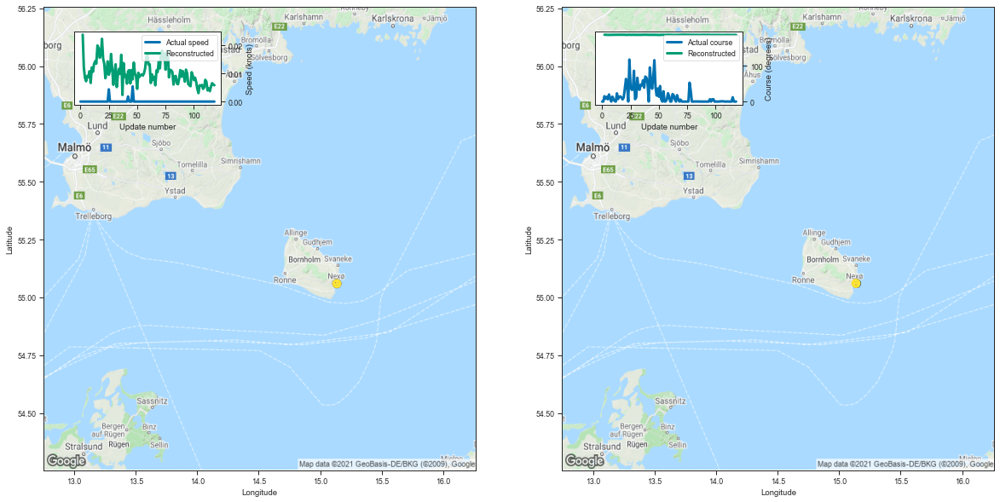

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.140780  55.060085  0.023819  187.100601         0.002884   
3    15.137030  55.061020  0.012058  187.112625         0.002296   
4    15.136455  55.060139  0.008434  186.882462         0.001731   
5    15.135764  55.060841  0.007234  186.730148         0.001414   
6    15.136662  55.060535  0.009121  186.744781         0.001404   
..         ...        ...       ...         ...              ...   
114  15.136815  55.060635  0.003705  186.478958         0.001045   
115  15.136712  55.060894  0.005292  186.512695         0.001063   
116  15.135881  55.061844  0.006547  186.507767         0.001059   
117  15.137385  55.060642  0.006097  186.691391         0.001272   
118  15.137301  55.060310  0.005799  186.691635         0.001305   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002556     0.080336     97.171487  
3          0.001963     0.095706    102.508779  
4          0.001510     0.046700    

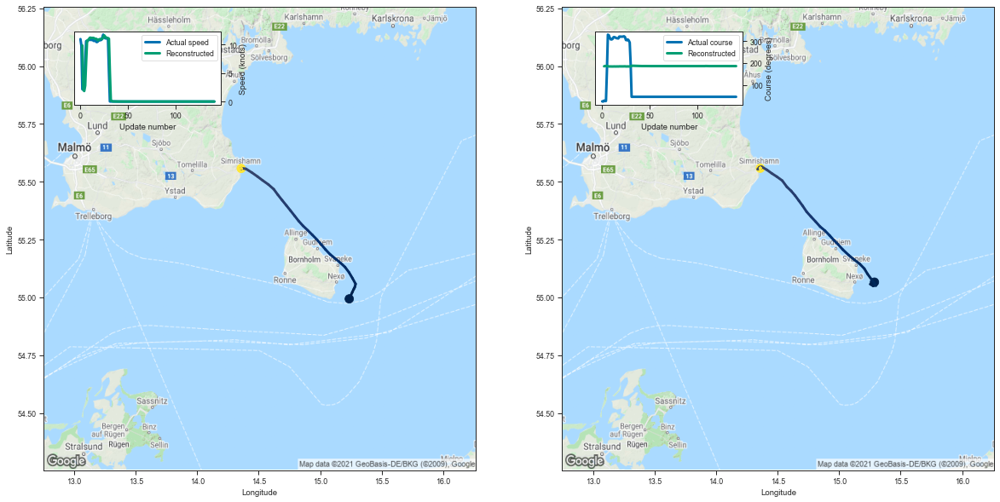

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.287232  55.065838  9.838544  185.532425         0.037791   
3    15.253827  55.056934  2.061611  186.724106         0.006016   
4    15.277181  55.049061  1.845212  187.035324         0.006863   
5    15.288765  55.053692  2.789925  186.978836         0.010082   
6    15.299210  55.050934  6.984485  185.930710         0.018119   
..         ...        ...       ...         ...              ...   
137  14.358667  55.559155 -0.000749  186.502151         0.000749   
138  14.359355  55.558479  0.000429  186.563492         0.000796   
139  14.359242  55.558250 -0.000136  186.600677         0.000830   
140  14.359618  55.558235  0.001338  186.530930         0.000773   
141  14.359231  55.558434  0.000162  186.447525         0.000705   

     Latitude sigma  Speed sigma  Course sigma  
2          0.020834     2.382391     95.210832  
3          0.004262     0.422638     98.463424  
4          0.004705     0.875866    

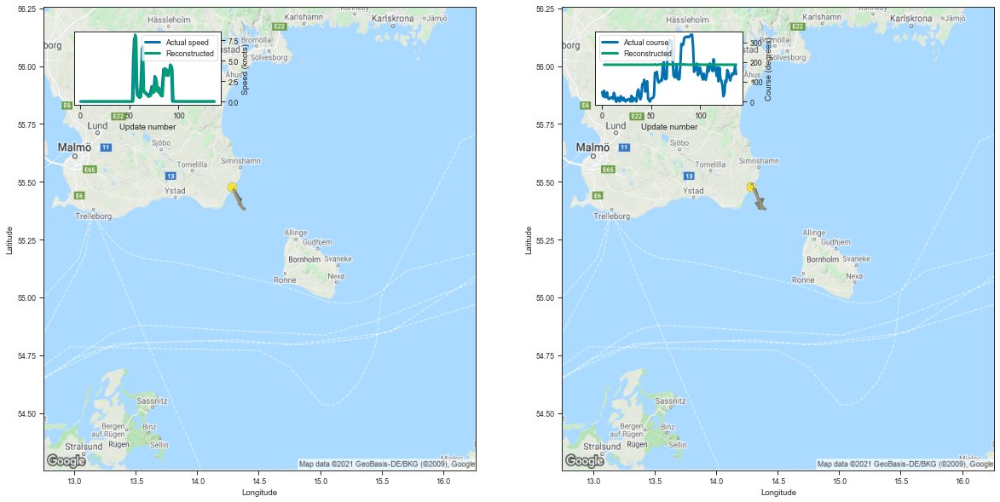

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.285704  55.476978  0.002980  186.764450         0.001282   
3    14.287835  55.476341 -0.001283  186.635895         0.000912   
4    14.287405  55.476685 -0.001385  186.529007         0.000764   
5    14.287421  55.476929 -0.002575  186.488434         0.000714   
6    14.288094  55.476048  0.000612  186.474701         0.000700   
..         ...        ...       ...         ...              ...   
133  14.287933  55.476162  0.002218  186.744019         0.000934   
134  14.288157  55.476723  0.000456  186.588531         0.000804   
135  14.287928  55.476200  0.000669  186.800262         0.000998   
136  14.288484  55.476837  0.001936  186.916473         0.001137   
137  14.286948  55.476704  0.001744  187.125854         0.001419   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001234     0.006377     93.326967  
3          0.000849     0.004692     97.905642  
4          0.000711     0.003428    

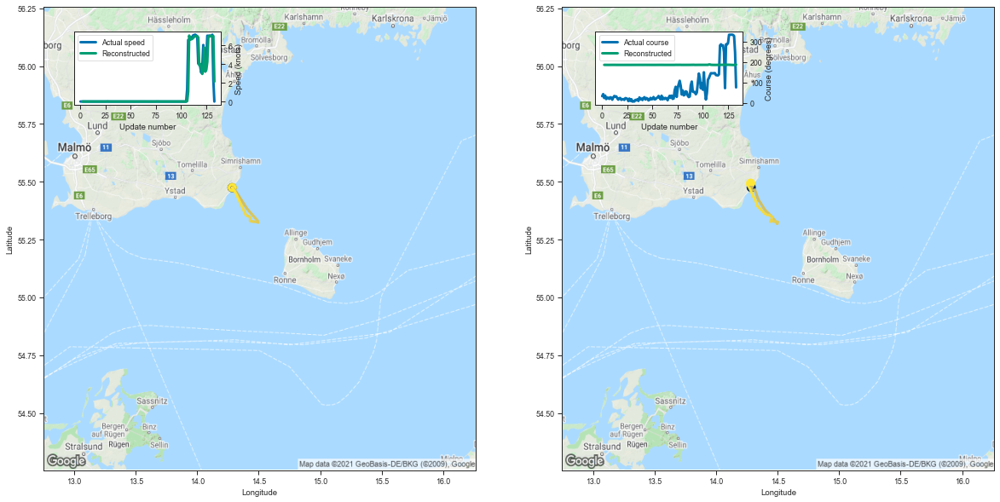

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.285296  55.475197  0.002345  186.654388         0.001146   
3    14.285074  55.475460  0.000653  186.525879         0.000804   
4    14.285772  55.475914 -0.000536  186.539856         0.000769   
5    14.285791  55.475571  0.000656  186.640717         0.000840   
6    14.285410  55.475693 -0.001733  186.482224         0.000708   
..         ...        ...       ...         ...              ...   
129  14.303111  55.435883  7.010851  186.093048         0.009866   
130  14.290982  55.450397  6.965415  186.160767         0.010311   
131  14.273310  55.471119  6.879960  186.291183         0.011343   
132  14.254973  55.487732  6.978994  187.132919         0.026896   
133  14.280664  55.493595  2.120187  187.809052         0.011454   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001117     0.004282     92.845743  
3          0.000756     0.003202     97.823866  
4          0.000712     0.003510    

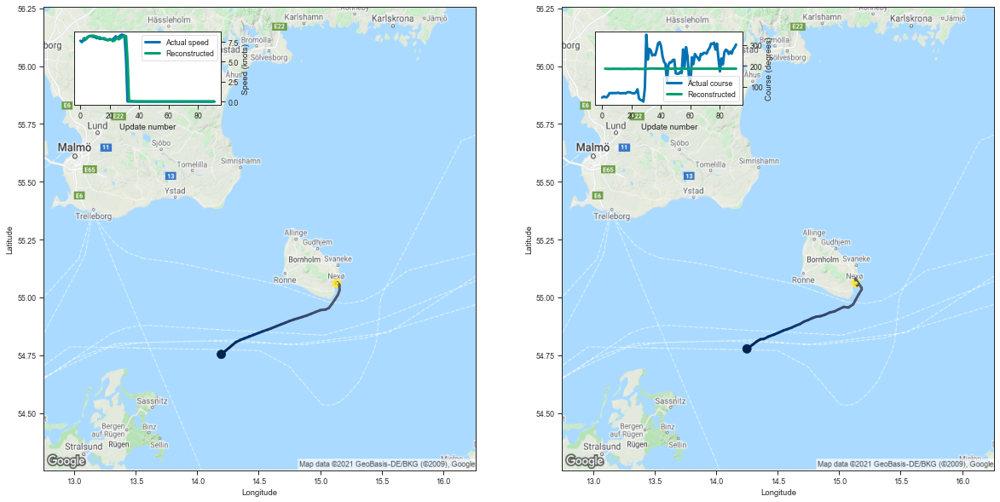

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.250653  54.777191  7.913399  186.484833         0.022827   
3   14.295493  54.794502  7.974610  186.011063         0.012723   
4   14.331748  54.809788  7.880956  185.931061         0.010991   
5   14.360475  54.818531  8.064077  185.477051         0.007479   
6   14.390368  54.820431  8.237382  185.630142         0.009259   
..        ...        ...       ...         ...              ...   
87  15.137229  55.061829 -0.002672  186.346619         0.000899   
88  15.137300  55.061630 -0.000159  186.268707         0.000823   
89  15.137585  55.061115 -0.001118  186.471252         0.001014   
90  15.136908  55.061729 -0.002351  186.364136         0.000921   
91  15.137044  55.061520 -0.001575  186.272263         0.000829   

    Latitude sigma  Speed sigma  Course sigma  
2         0.012974     1.620828     97.741318  
3         0.007543     0.751820     99.945068  
4         0.006606     0.675041    101.049966  
5  

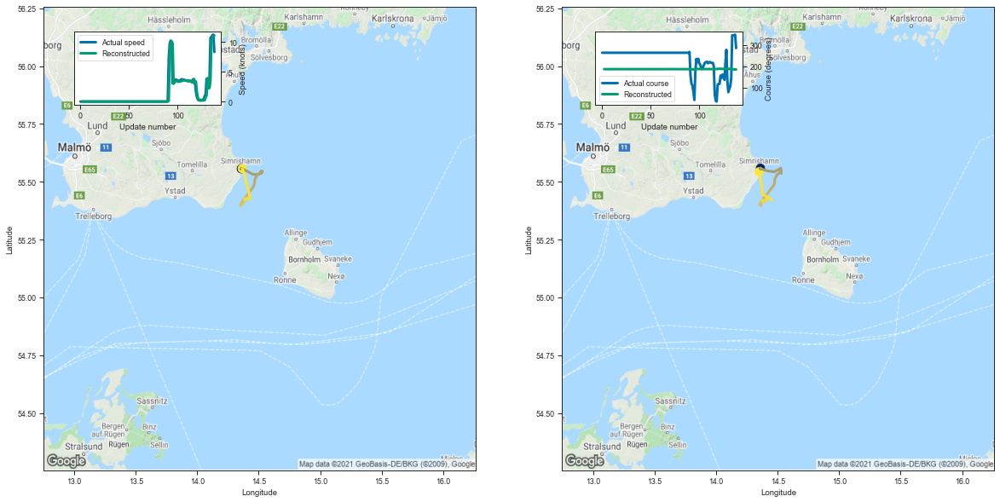

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.360279  55.558342  -0.002665  186.620544         0.001206   
3    14.360909  55.557621  -0.000970  186.692917         0.001029   
4    14.360485  55.558262  -0.001214  186.657791         0.000935   
5    14.361127  55.557610  -0.000582  186.648819         0.000910   
6    14.360753  55.557964   0.001128  186.551254         0.000810   
..         ...        ...        ...         ...              ...   
134  14.452346  55.420712   3.591246  187.471222         0.015362   
135  14.371797  55.450012  10.295008  185.350281         0.016017   
136  14.370176  55.482784  10.696447  185.185287         0.013832   
137  14.360889  55.511688  11.006786  185.145584         0.014330   
138  14.350964  55.543373  11.097071  185.103699         0.013960   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001212     0.004166     90.734207  
3          0.000966     0.006456     96.942819  
4          0.000870     

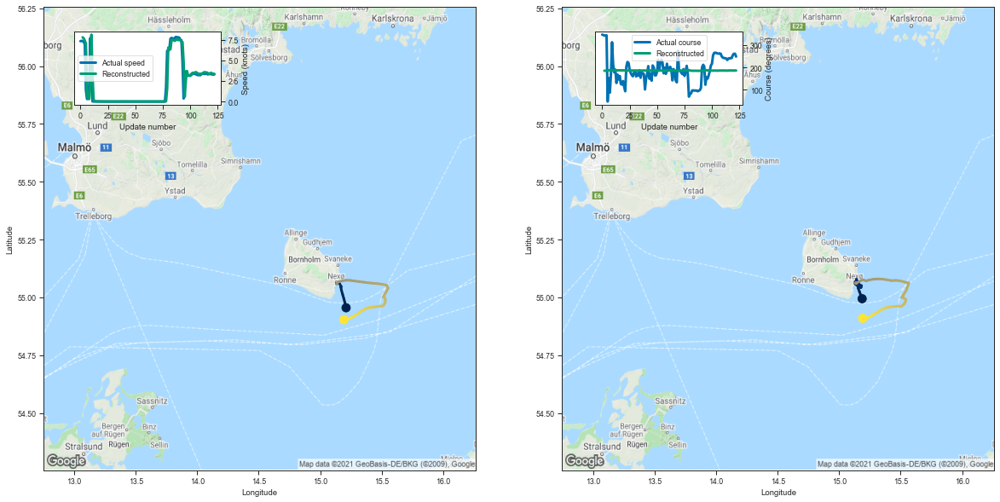

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.187092  54.994133  7.791057  185.446640         0.015986   
3    15.166086  55.023495  7.662377  185.609360         0.014087   
4    15.155075  55.040073  7.383152  185.568497         0.011985   
5    15.148529  55.057003  7.017850  186.334534         0.021881   
6    15.182325  55.050400  1.017787  187.452271         0.007487   
..         ...        ...       ...         ...              ...   
118  15.250577  54.915920  3.420261  186.566223         0.008174   
119  15.236609  54.913101  3.486299  186.269775         0.006147   
120  15.221004  54.911789  3.400423  186.520813         0.007146   
121  15.206740  54.910378  3.367440  186.444641         0.006684   
122  15.191504  54.909130  3.353995  186.376373         0.006064   

     Latitude sigma  Speed sigma  Course sigma  
2          0.010111     0.688920     92.789728  
3          0.008582     0.994743     98.324325  
4          0.007458     0.787451    

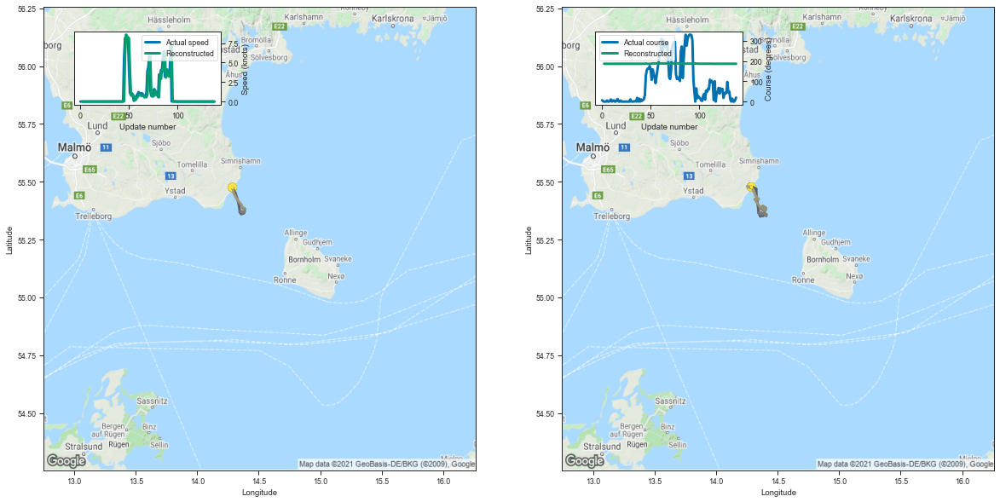

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.286101  55.477394  0.002628  186.719437         0.001212   
3    14.287129  55.476292 -0.001181  186.523041         0.000799   
4    14.286891  55.477047 -0.000949  186.553452         0.000776   
5    14.287571  55.476559 -0.001137  186.475906         0.000703   
6    14.287484  55.476589 -0.001359  186.540527         0.000743   
..         ...        ...       ...         ...              ...   
134  14.287883  55.476994 -0.001263  186.529953         0.000731   
135  14.287828  55.476921  0.000371  186.529877         0.000732   
136  14.287430  55.477093 -0.000692  186.465393         0.000684   
137  14.288294  55.476654  0.001633  186.627121         0.000810   
138  14.287521  55.477135 -0.001683  186.515686         0.000726   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001171     0.005619     93.483167  
3          0.000753     0.003246     97.917351  
4          0.000717     0.003779    

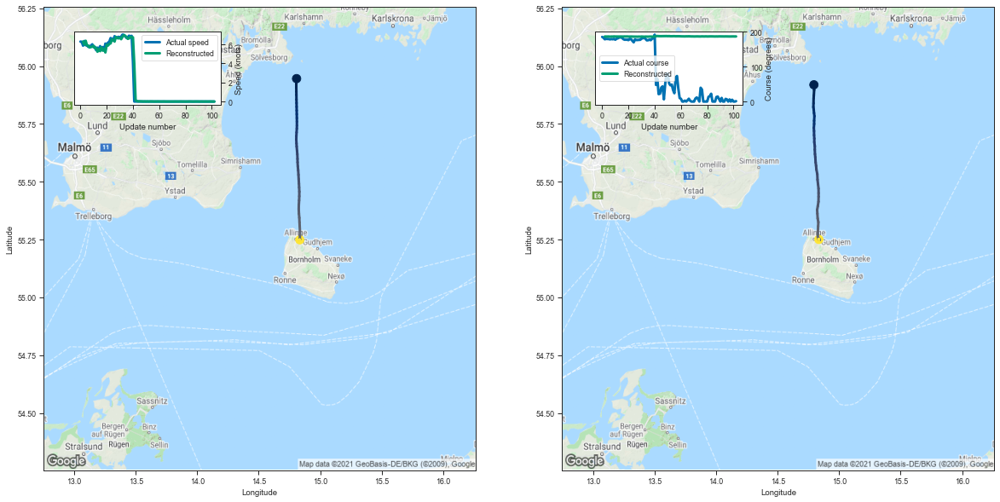

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.795114  55.919270  6.308659  186.198944         0.018585   
3    14.797009  55.896622  5.988691  186.035065         0.011270   
4    14.794378  55.873016  6.383038  186.077042         0.012419   
5    14.792673  55.860458  5.890593  186.181259         0.011601   
6    14.791861  55.839455  5.882017  185.734543         0.007344   
..         ...        ...       ...         ...              ...   
98   14.835353  55.251373 -0.000678  186.296295         0.000715   
99   14.835388  55.250332  0.000228  186.409409         0.000803   
100  14.835540  55.250530 -0.000777  186.437683         0.000836   
101  14.834702  55.250381 -0.002166  186.301483         0.000724   
102  14.835446  55.250351 -0.000929  186.425446         0.000818   

     Latitude sigma  Speed sigma  Course sigma  
2          0.012970     0.853900     85.531113  
3          0.007893     0.503126     89.776404  
4          0.008348     0.754908    

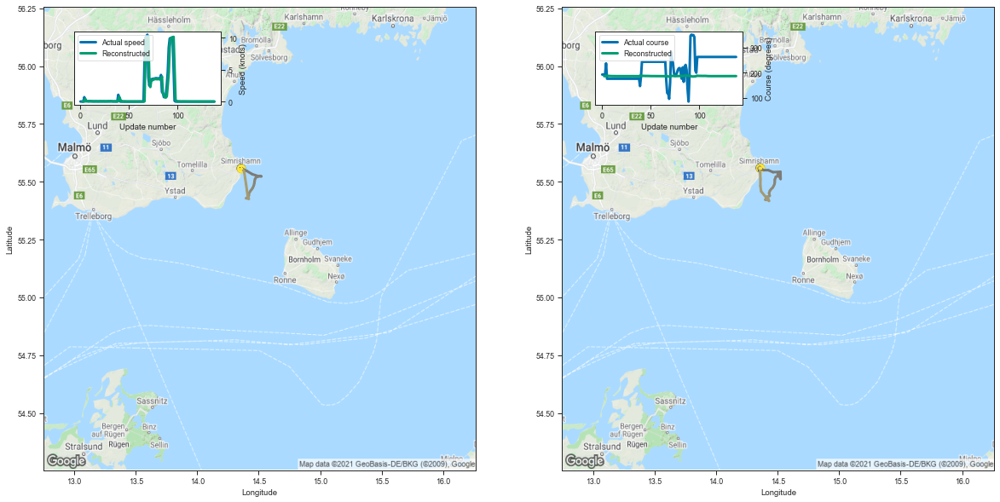

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358954  55.559452  0.001333  186.678024         0.001280   
3    14.358730  55.559330 -0.001390  186.491959         0.000832   
4    14.360372  55.559795  0.020025  188.064835         0.003929   
5    14.351172  55.552383  0.432455  187.603928         0.003958   
6    14.362519  55.554478  0.069319  187.456238         0.002501   
..         ...        ...       ...         ...              ...   
134  14.360365  55.557980  0.000027  186.542435         0.000801   
135  14.360748  55.558052 -0.000679  186.576416         0.000818   
136  14.361014  55.557575  0.001996  186.809830         0.001041   
137  14.360822  55.558250  0.000780  186.541229         0.000806   
138  14.360638  55.558403  0.000517  186.798630         0.001031   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001275     0.005151     91.030172  
3          0.000800     0.003073     96.083079  
4          0.003024     0.595109    

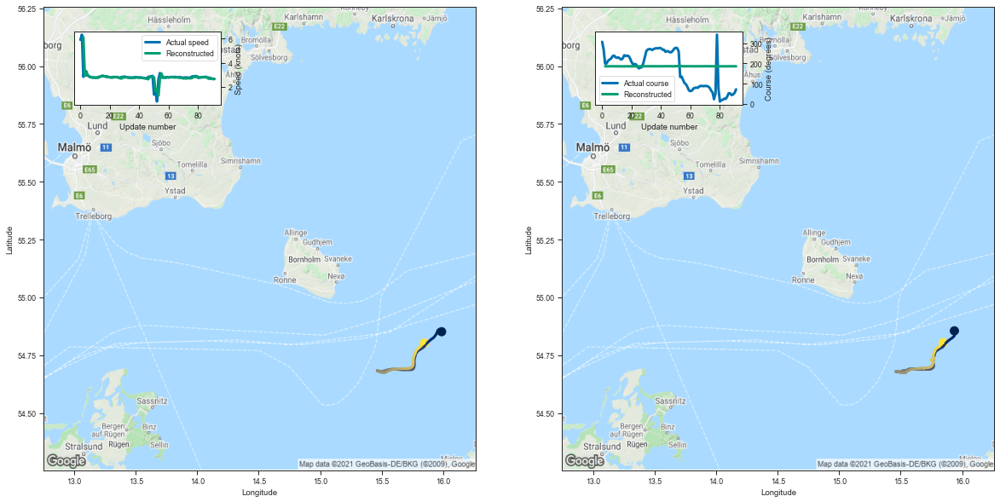

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.936994  54.855358  6.120238  185.956299         0.027237   
3   15.943113  54.857334  2.922948  186.002289         0.007329   
4   15.942268  54.842705  3.298905  185.734818         0.005636   
5   15.938543  54.835384  2.952519  185.769669         0.004728   
6   15.930138  54.829910  2.884371  186.155670         0.006728   
..        ...        ...       ...         ...              ...   
87  15.806837  54.784649  2.683389  186.007721         0.004405   
88  15.817654  54.789116  2.673857  185.992020         0.004361   
89  15.826464  54.794868  2.711056  185.770798         0.003515   
90  15.836271  54.800259  2.640748  185.878754         0.003767   
91  15.846590  54.804123  2.648843  185.802078         0.003558   

    Latitude sigma  Speed sigma  Course sigma  
2         0.015612     1.858410     93.938685  
3         0.004936     0.329632     96.264609  
4         0.003818     0.219858     98.203561  
5  

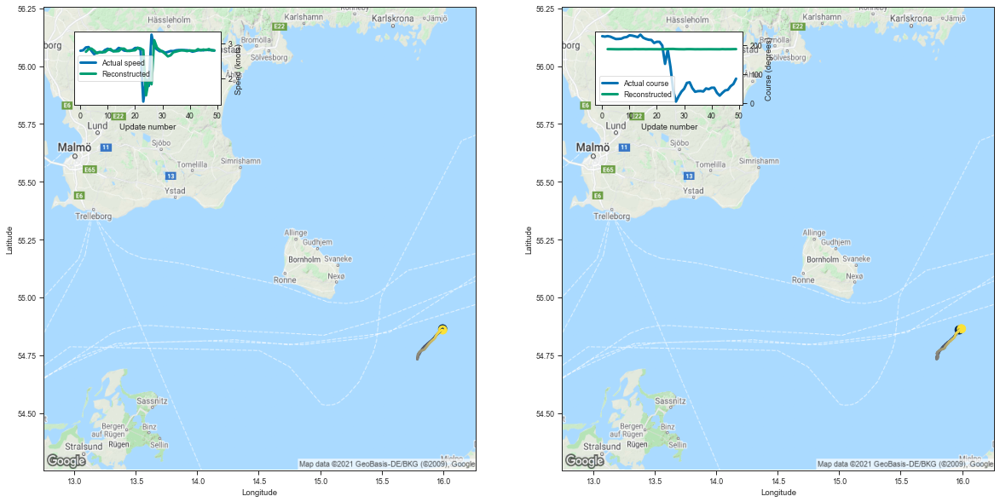

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.976056  54.859322  2.757237  186.006180         0.008161   
3   15.968849  54.849174  2.834327  186.011261         0.006630   
4   15.957151  54.845989  2.847680  185.838516         0.005231   
5   15.946965  54.837791  2.790352  185.655930         0.003930   
6   15.936342  54.830845  2.715438  185.601334         0.003377   
7   15.928741  54.825916  2.741392  185.746002         0.003879   
8   15.920007  54.821911  2.745880  185.768906         0.003994   
9   15.911291  54.817715  2.748733  185.731644         0.003812   
10  15.902138  54.812538  2.807925  185.697220         0.003712   
11  15.888129  54.807308  2.836263  185.765656         0.003971   
12  15.881774  54.804729  2.769528  186.095688         0.005507   
13  15.867698  54.798103  2.770179  185.790771         0.004145   
14  15.860104  54.793816  2.777168  185.809296         0.003997   
15  15.848951  54.788536  2.845382  185.928802         0.00462

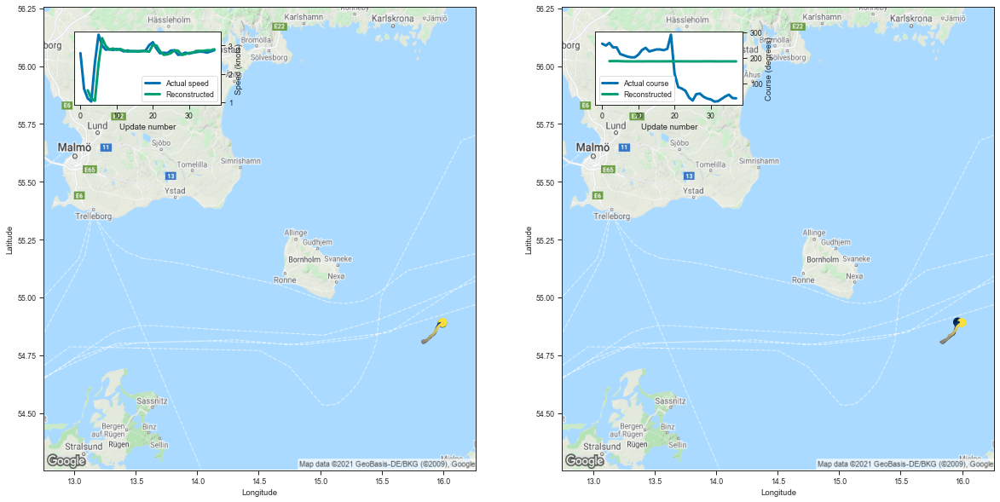

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.964041  54.892921  1.419931  186.611862         0.009477   
3   15.972541  54.890514  1.128045  186.757477         0.007402   
4   15.966261  54.891479  1.050751  186.981628         0.008588   
5   15.964307  54.888119  2.346850  186.530075         0.009459   
6   15.950848  54.883965  3.256225  185.918716         0.007123   
7   15.949933  54.870838  2.979916  185.738327         0.004867   
8   15.946278  54.861641  2.853352  185.669296         0.003987   
9   15.940208  54.853848  2.891464  185.530838         0.003391   
10  15.937051  54.845673  2.844121  185.813797         0.004342   
11  15.927772  54.839729  2.875728  185.622559         0.003708   
12  15.917138  54.837273  2.823407  185.863831         0.004514   
13  15.904479  54.831898  2.782931  185.846481         0.004430   
14  15.896068  54.826668  2.799923  185.942139         0.004887   
15  15.884856  54.822186  2.795757  185.741272         0.00396

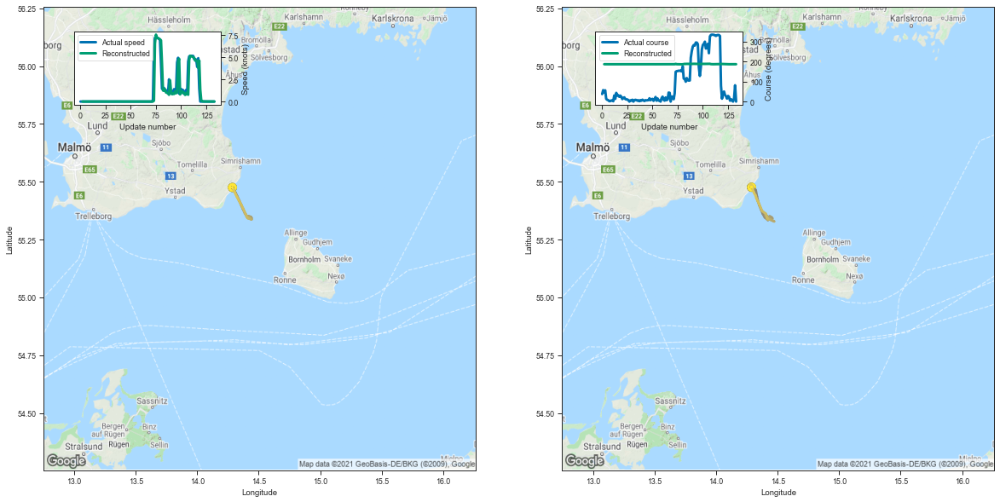

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.287500  55.476120  0.002089  186.694916         0.001212   
3    14.287052  55.477005 -0.003301  186.549179         0.000829   
4    14.288096  55.476833 -0.002139  186.573532         0.000803   
5    14.288065  55.476490 -0.001356  186.479187         0.000707   
6    14.287257  55.477024 -0.000234  186.470032         0.000692   
..         ...        ...       ...         ...              ...   
129  14.287721  55.477451  0.000715  186.487793         0.000703   
130  14.287483  55.477100  0.001060  186.624969         0.000811   
131  14.287805  55.476555 -0.000329  186.634369         0.000828   
132  14.287806  55.476303 -0.000066  186.555679         0.000759   
133  14.288642  55.475994  0.002688  186.646561         0.000845   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001181     0.004961     92.621115  
3          0.000781     0.003430     97.598533  
4          0.000742     0.003951    

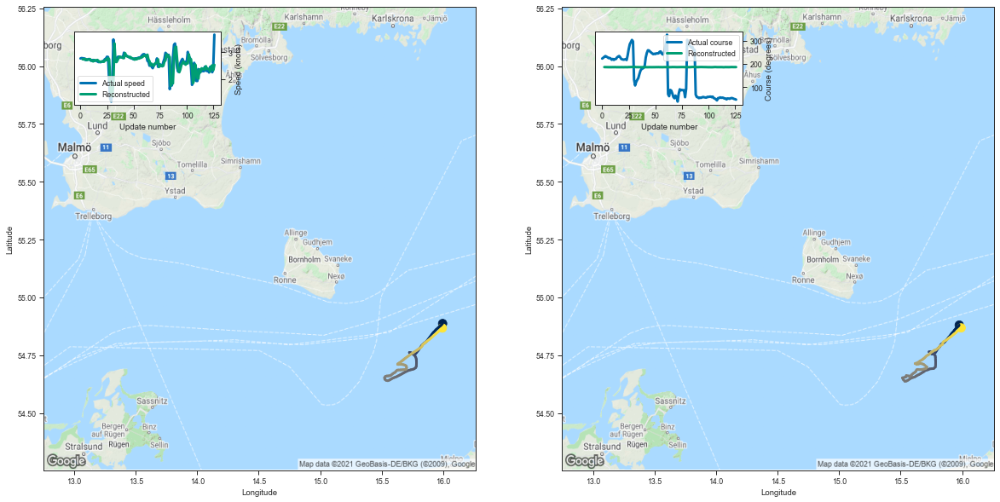

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.976641  54.880135  2.735686  186.170532         0.009776   
3    15.969089  54.874718  2.736862  186.133575         0.007534   
4    15.957547  54.869690  2.722102  186.037369         0.006317   
5    15.947999  54.864643  2.743843  185.900879         0.005231   
6    15.937268  54.858002  2.707118  185.822571         0.004498   
..         ...        ...       ...         ...              ...   
122  15.956491  54.852352  2.283125  186.378555         0.006816   
123  15.967008  54.856415  2.465695  186.265076         0.006711   
124  15.974914  54.859360  2.511438  186.132828         0.005975   
125  15.984241  54.862793  2.332508  186.254471         0.006275   
126  15.991903  54.867954  2.529385  186.133957         0.006090   

     Latitude sigma  Speed sigma  Course sigma  
2          0.006695     0.420656     92.554497  
3          0.005054     0.439852     97.494170  
4          0.004239     0.341420    

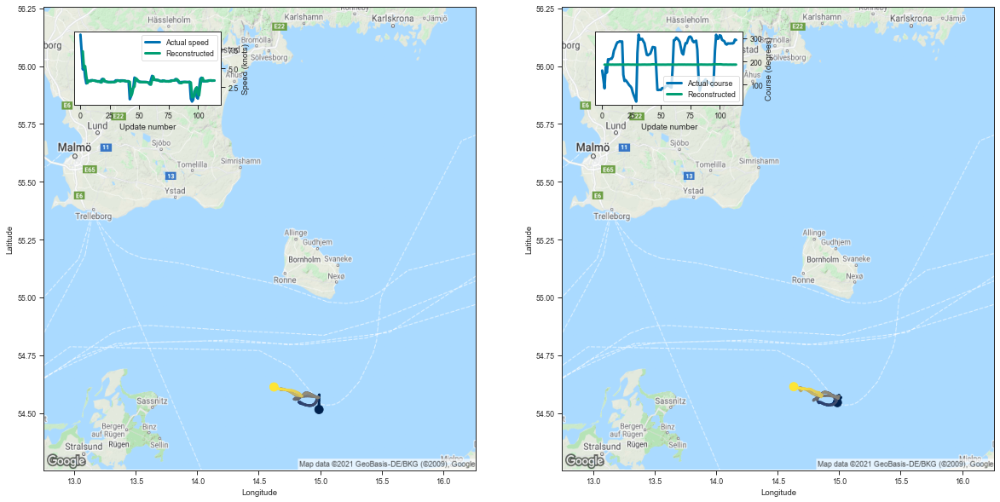

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.985501  54.545017  7.287466  186.356689         0.027698   
3    15.014586  54.566978  5.086410  186.034821         0.007915   
4    15.004489  54.570736  5.312015  186.217682         0.009222   
5    14.999680  54.576748  3.960941  186.280518         0.005852   
6    14.981282  54.571918  3.050509  186.511032         0.005070   
..         ...        ...       ...         ...              ...   
110  14.689677  54.606747  3.401522  186.321930         0.003951   
111  14.671533  54.607937  3.410029  186.130859         0.003197   
112  14.659626  54.607960  3.402567  186.423965         0.004174   
113  14.644597  54.609718  3.376560  186.203751         0.003362   
114  14.631144  54.613750  3.388876  186.440170         0.004180   

     Latitude sigma  Speed sigma  Course sigma  
2          0.015237     2.198479     98.798791  
3          0.005107     0.388081     99.422974  
4          0.005685     0.758739    

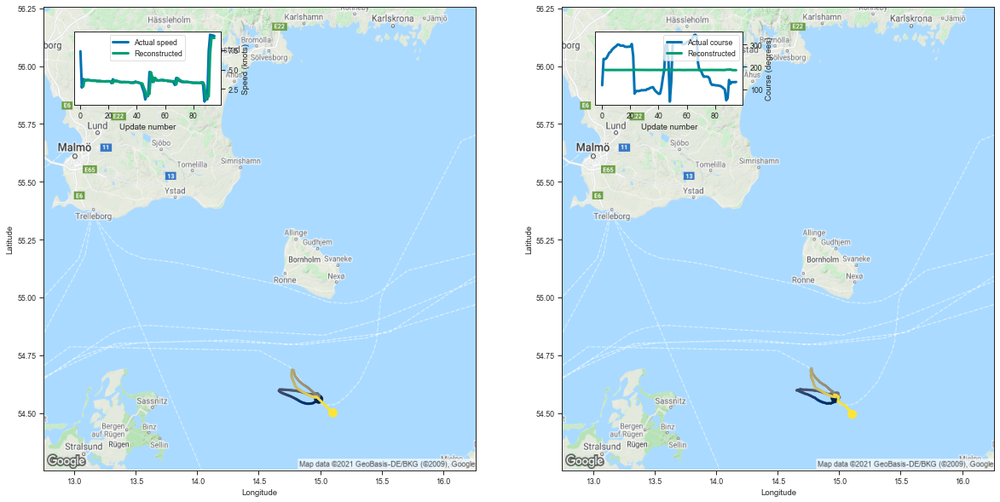

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.968541  54.564041  2.807988  186.583679         0.006983   
3   14.965958  54.548378  3.715224  186.120392         0.004706   
4   14.950605  54.545799  3.582416  186.056656         0.003827   
5   14.933032  54.541603  3.619283  186.195526         0.004300   
6   14.916479  54.541893  3.656389  186.048111         0.003737   
..        ...        ...       ...         ...              ...   
91  14.995058  54.570366  1.534771  188.486435         0.022406   
92  14.991362  54.549160  7.152845  186.140564         0.018228   
93  15.049305  54.531170  9.169365  185.578690         0.020107   
94  15.081941  54.512314  9.083340  185.618240         0.020494   
95  15.106749  54.494186  9.067328  185.231827         0.014022   

    Latitude sigma  Speed sigma  Course sigma  
2         0.004953     0.234928     95.135573  
3         0.003264     0.141953    100.108828  
4         0.002687     0.104850    101.741122  
5  

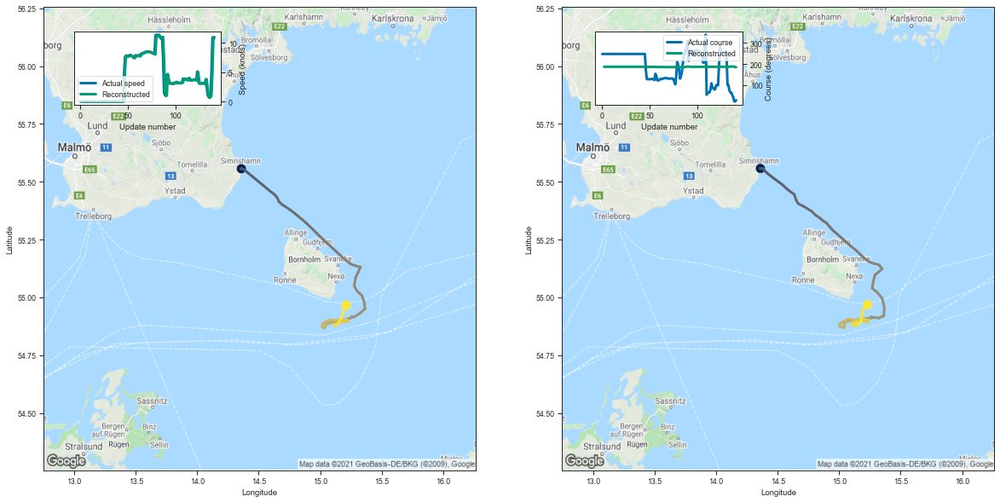

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.360007  55.557400  -0.002006  186.727432         0.001355   
3    14.360512  55.556747  -0.000425  186.582077         0.000920   
4    14.359936  55.558186  -0.001317  186.629913         0.000906   
5    14.360034  55.558025   0.001117  186.678726         0.000935   
6    14.360449  55.557407  -0.001203  186.491684         0.000763   
..         ...        ...        ...         ...              ...   
137  15.149927  54.887321   0.728025  187.685211         0.007733   
138  15.159188  54.885559   1.066139  188.198456         0.014986   
139  15.175514  54.892651   5.046563  186.446121         0.014026   
140  15.193231  54.947098  10.914482  184.650055         0.015905   
141  15.230291  54.968456  10.755615  184.756088         0.016236   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001344     0.006169     91.125455  
3          0.000878     0.004311     96.319755  
4          0.000844     

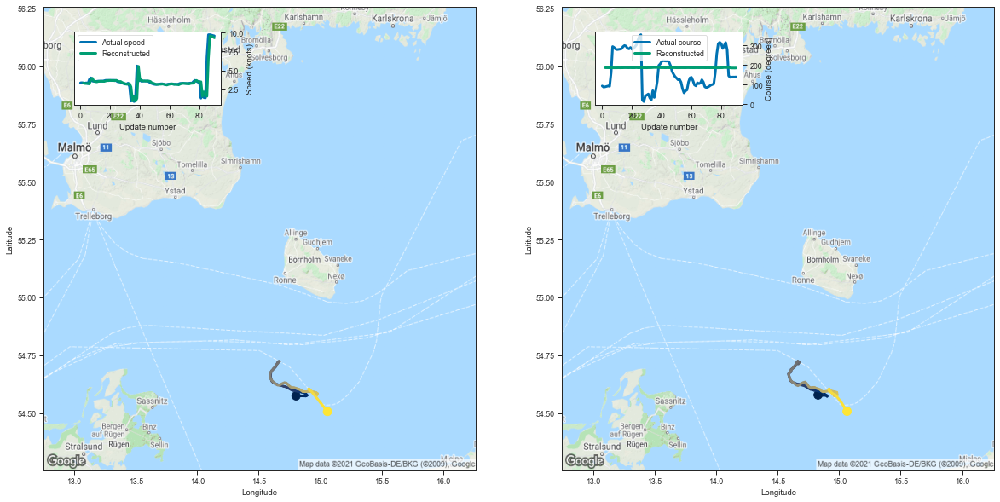

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.828950  54.577911  3.359490  186.484772         0.006577   
3   14.847932  54.576252  3.281966  186.434265         0.004927   
4   14.865975  54.576263  3.270475  186.305161         0.004122   
5   14.884310  54.576397  3.304838  186.279404         0.004018   
6   14.898894  54.575928  3.216932  186.219772         0.003663   
..        ...        ...       ...         ...              ...   
86  14.922824  54.592644  6.585857  186.103668         0.013586   
87  14.974179  54.575279  9.530644  185.277161         0.015686   
88  15.012654  54.550629  9.537300  185.216766         0.014970   
89  15.039306  54.527264  9.454512  185.021652         0.012129   
90  15.064487  54.507275  9.300479  185.318436         0.015473   

    Latitude sigma  Speed sigma  Course sigma  
2         0.004614     0.214711     96.412257  
3         0.003399     0.205234    101.377798  
4         0.002876     0.150281    102.346336  
5  

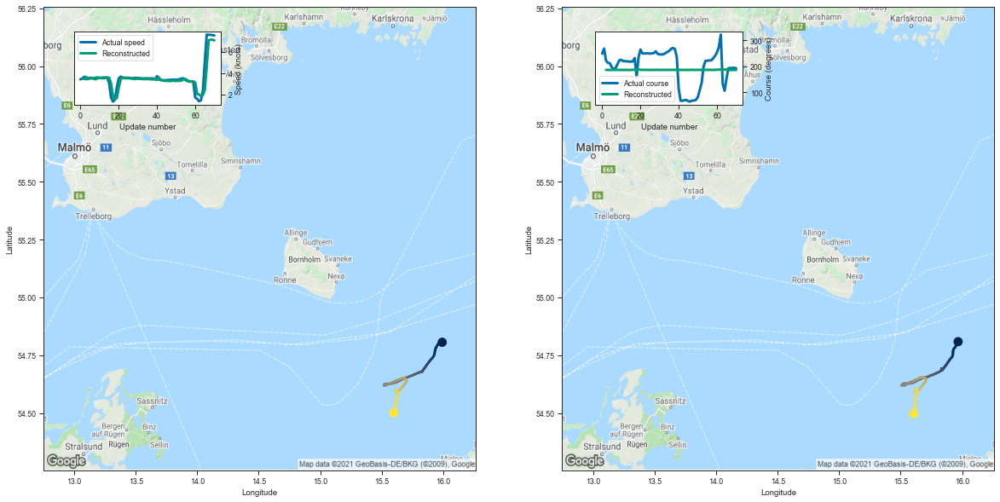

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.967268  54.808437  3.452403  185.662262         0.007695   
3   15.955517  54.795883  3.644831  185.580017         0.005631   
4   15.945477  54.785915  3.441797  185.463959         0.004213   
5   15.931465  54.777122  3.508172  185.708450         0.005316   
6   15.926376  54.768559  3.510263  185.613510         0.004897   
..        ...        ...       ...         ...              ...   
66  15.638735  54.596611  4.609149  186.486145         0.014851   
67  15.617570  54.564556  7.063145  185.210129         0.010349   
68  15.617369  54.537601  7.132126  185.336761         0.010952   
69  15.614560  54.515629  7.127393  185.575699         0.013793   
70  15.606870  54.497490  7.069183  185.617828         0.014395   

    Latitude sigma  Speed sigma  Course sigma  
2         0.005391     0.158345     91.023054  
3         0.003841     0.179810     97.532867  
4         0.002939     0.103750     98.586113  
5  

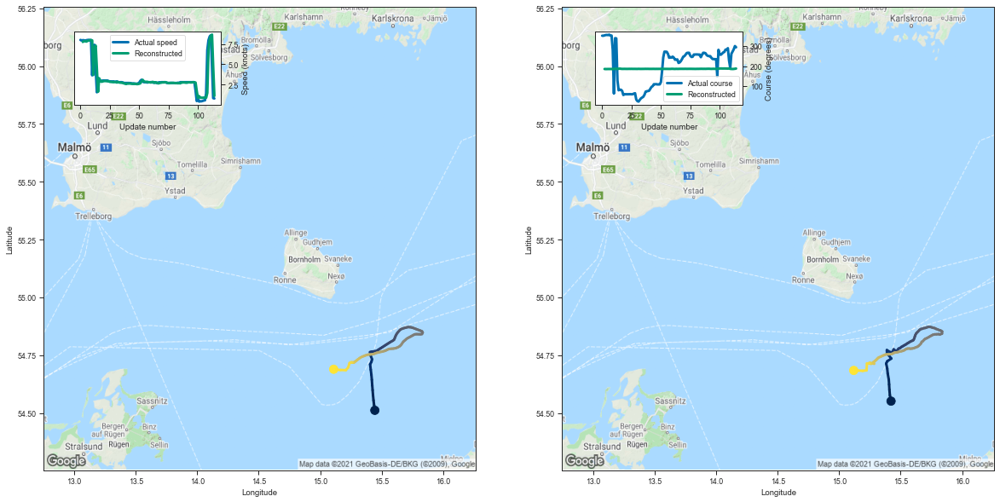

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.422002  54.551224  7.744759  185.422134         0.018011   
3    15.412660  54.576786  7.846801  185.175995         0.011963   
4    15.408767  54.600899  7.844279  185.103271         0.010456   
5    15.406434  54.623436  7.795001  185.385986         0.013227   
6    15.403687  54.644569  7.870926  185.294037         0.012568   
..         ...        ...       ...         ...              ...   
110  15.222845  54.684326  7.990479  185.571945         0.015906   
111  15.191605  54.682178  8.471655  185.389938         0.014510   
112  15.148301  54.683666  8.646940  185.692810         0.019811   
113  15.105429  54.692791  4.719858  186.530914         0.011019   
114  15.118849  54.683994  1.112831  187.626923         0.009074   

     Latitude sigma  Speed sigma  Course sigma  
2          0.010582     0.840308     95.747950  
3          0.007140     0.561943     98.939287  
4          0.006281     0.490633    

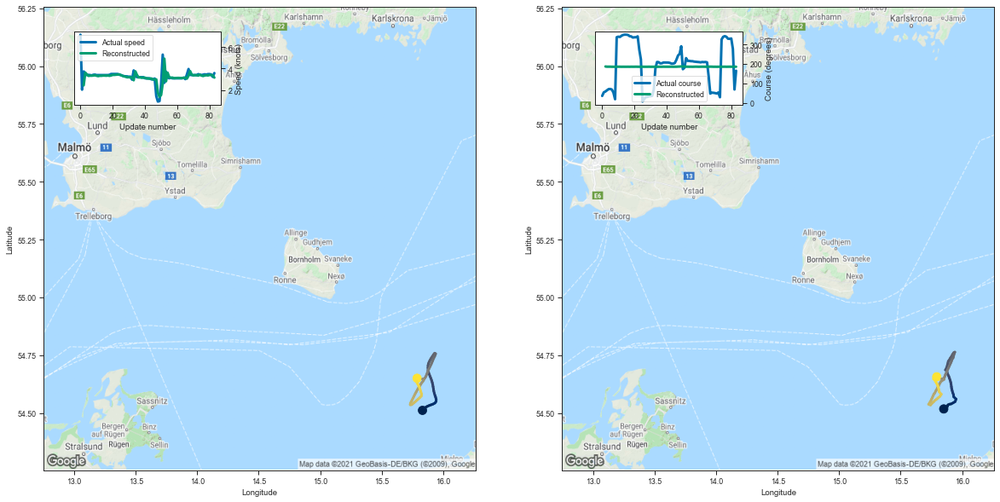

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.850496  54.517456  2.443289  186.888199         0.015280   
3   15.879451  54.527714  3.615857  185.972885         0.007783   
4   15.884671  54.534878  3.460654  185.974731         0.006678   
5   15.897465  54.537968  3.324134  185.930679         0.005994   
6   15.911466  54.539196  3.344053  185.577606         0.004169   
..        ...        ...       ...         ...              ...   
79  15.792637  54.628399  3.364788  185.845901         0.004892   
80  15.783887  54.635399  3.404404  185.701157         0.004304   
81  15.775047  54.644428  3.406719  185.861603         0.004977   
82  15.767282  54.646866  3.376783  185.904251         0.005190   
83  15.793662  54.656487  3.164604  185.666687         0.003742   

    Latitude sigma  Speed sigma  Course sigma  
2         0.009364     1.285429     97.521217  
3         0.005025     0.400906     99.868375  
4         0.004323     0.406785    102.374704  
5  

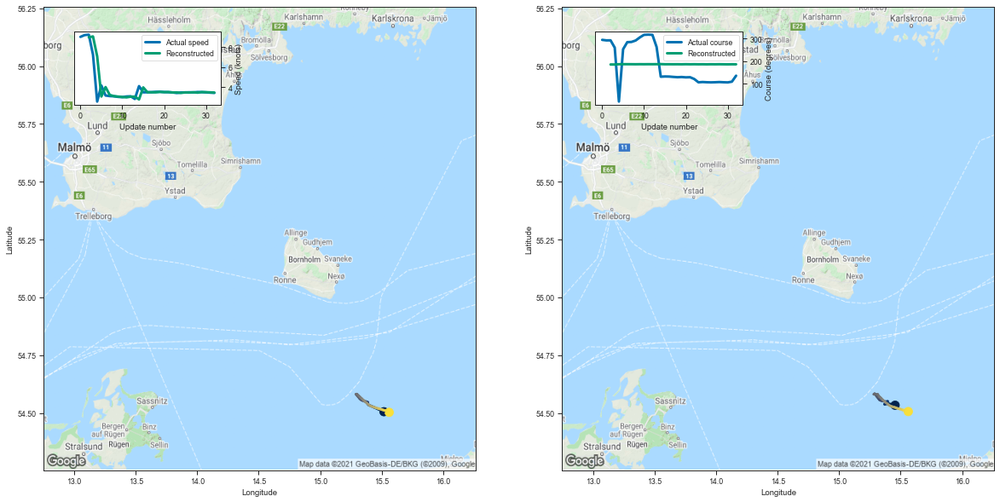

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.455156  54.533451  8.973944  184.954315         0.018520   
3   15.403325  54.540020  9.060806  184.841232         0.013094   
4   15.369884  54.537754  7.077101  186.147842         0.021343   
5   15.394842  54.550045  3.066136  186.252426         0.005555   
6   15.375452  54.548756  4.005955  186.214890         0.006956   
7   15.357856  54.551594  3.222675  186.126785         0.004734   
8   15.342591  54.553463  3.098704  185.967377         0.003690   
9   15.328330  54.556675  3.058160  186.202774         0.004417   
10  15.318260  54.563347  3.016304  186.054214         0.003803   
11  15.309387  54.569366  2.979462  186.227005         0.004345   
12  15.298787  54.576702  3.048900  186.132568         0.004108   
13  15.288976  54.583382  3.046957  186.300354         0.004756   
14  15.282199  54.580898  2.775117  186.585037         0.005803   
15  15.313273  54.580833  3.972225  185.997498         0.00518

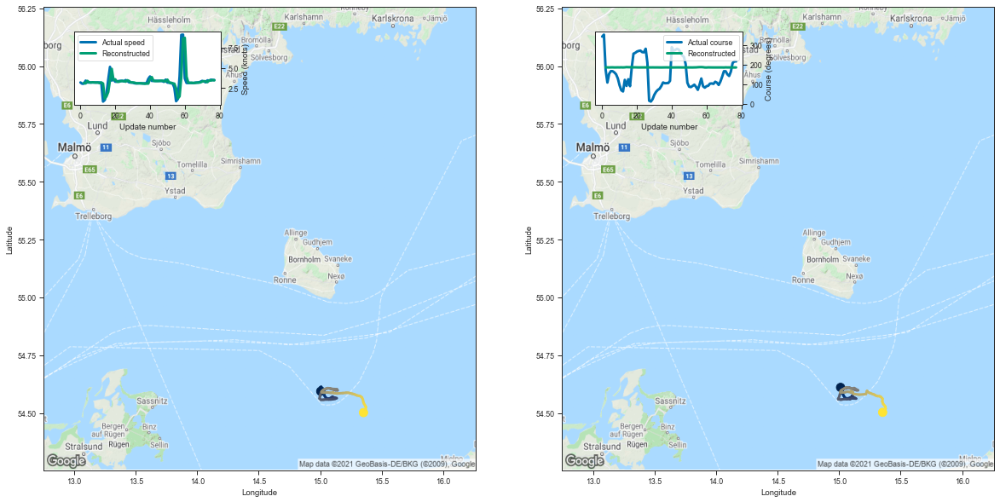

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.011950  54.610550  3.144094  186.381531         0.006194   
3   15.003208  54.606453  3.079681  186.329834         0.004548   
4   15.024594  54.612591  3.395544  186.014221         0.003514   
5   15.024675  54.602455  3.212337  186.398727         0.004674   
6   15.026792  54.593353  3.194324  186.510681         0.005366   
..        ...        ...       ...         ...              ...   
73  15.366496  54.533318  3.239817  186.169113         0.004704   
74  15.375459  54.528206  3.446599  185.994431         0.004297   
75  15.378168  54.517673  3.436490  185.912903         0.003888   
76  15.365843  54.509560  3.499984  185.855865         0.003693   
77  15.353835  54.502792  3.465625  185.950394         0.003956   

    Latitude sigma  Speed sigma  Course sigma  
2         0.004420     0.197054     96.101854  
3         0.003214     0.179525    100.902959  
4         0.002532     0.097083    101.546427  
5  

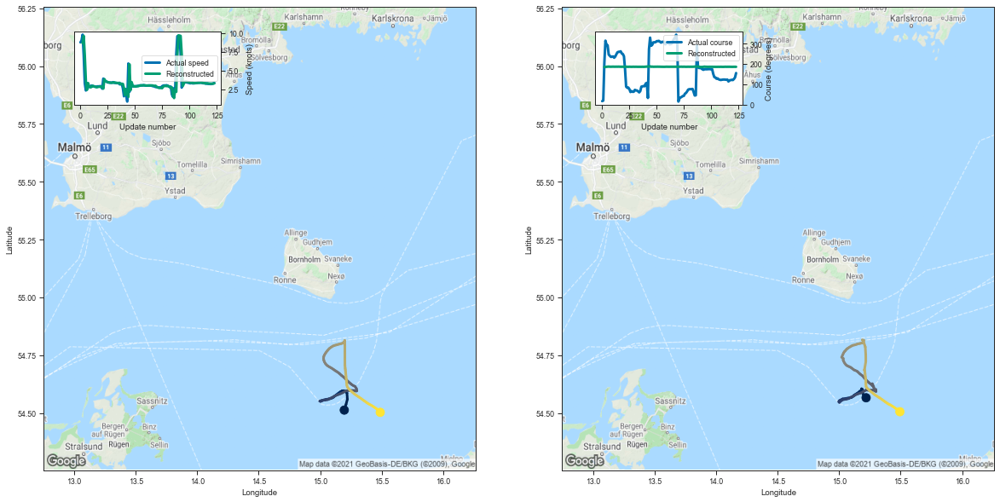

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.219380  54.565720  8.653385  185.321579         0.018860   
3    15.203003  54.568768  9.623297  185.194824         0.019277   
4    15.182221  54.604561  6.988831  185.989975         0.015924   
5    15.189646  54.601986  3.537631  186.548126         0.007758   
6    15.189810  54.599300  2.422366  186.989410         0.007853   
..         ...        ...       ...         ...              ...   
119  15.442375  54.526150  3.259656  185.882309         0.003671   
120  15.456445  54.520847  3.263436  185.831482         0.003497   
121  15.469093  54.516479  3.242956  186.076248         0.004452   
122  15.482916  54.510952  3.264976  185.997253         0.004283   
123  15.493969  54.505356  3.309550  185.888580         0.003938   

     Latitude sigma  Speed sigma  Course sigma  
2          0.010934     0.868086     96.263397  
3          0.010697     1.246300    100.611422  
4          0.009017     1.499190    

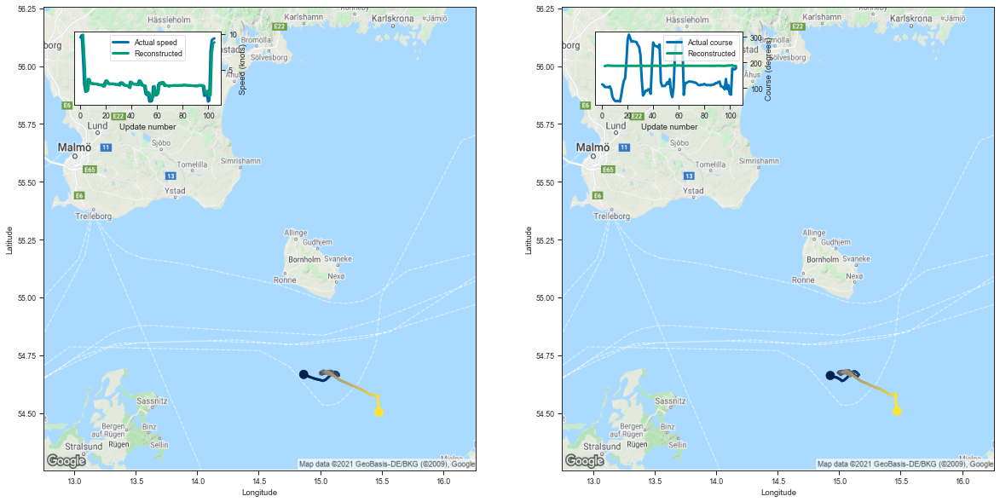

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.928560  54.662052  9.922132  185.335739         0.023179   
3    14.972182  54.653957  6.823916  186.177475         0.015902   
4    14.982774  54.653130  3.054078  187.132996         0.010029   
5    14.998243  54.648144  1.972252  187.241287         0.007759   
6    15.007420  54.645988  2.145488  187.367691         0.009074   
..         ...        ...       ...         ...              ...   
101  15.458951  54.583427  1.417084  187.551682         0.012290   
102  15.460962  54.582626  1.448272  188.558792         0.029745   
103  15.456199  54.563931  7.337220  186.165451         0.029239   
104  15.466117  54.529652  8.692981  185.280151         0.018078   
105  15.471216  54.507744  8.847324  185.065231         0.014419   

     Latitude sigma  Speed sigma  Course sigma  
2          0.012934     1.229074     97.445352  
3          0.009120     1.528313    101.763589  
4          0.006285     1.344643    

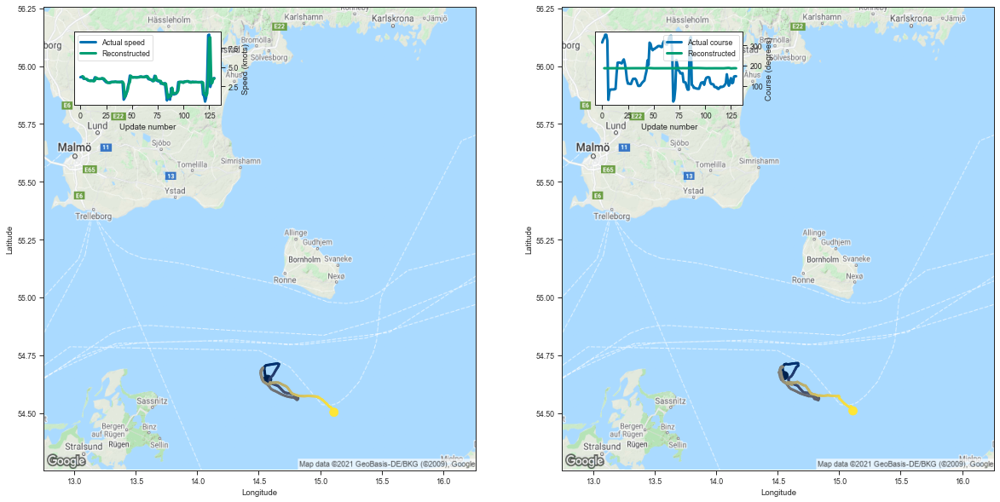

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.552917  54.661705  3.834555  186.542496         0.007243   
3    14.548497  54.670128  3.760737  186.302322         0.004408   
4    14.543283  54.682434  3.515779  186.431396         0.004232   
5    14.540110  54.693363  3.494343  186.487961         0.004392   
6    14.540031  54.698048  3.476060  186.442474         0.004189   
..         ...        ...       ...         ...              ...   
126  15.083426  54.524685  8.902271  186.010727         0.028320   
127  15.095022  54.529022  2.869210  186.774292         0.007141   
128  15.101764  54.525719  2.973459  186.676178         0.006399   
129  15.103251  54.517757  3.515805  186.345795         0.005539   
130  15.112472  54.509308  3.532216  186.361618         0.005554   

     Latitude sigma  Speed sigma  Course sigma  
2          0.005018     0.219704     95.127130  
3          0.003105     0.113597     99.435801  
4          0.002946     0.144602    

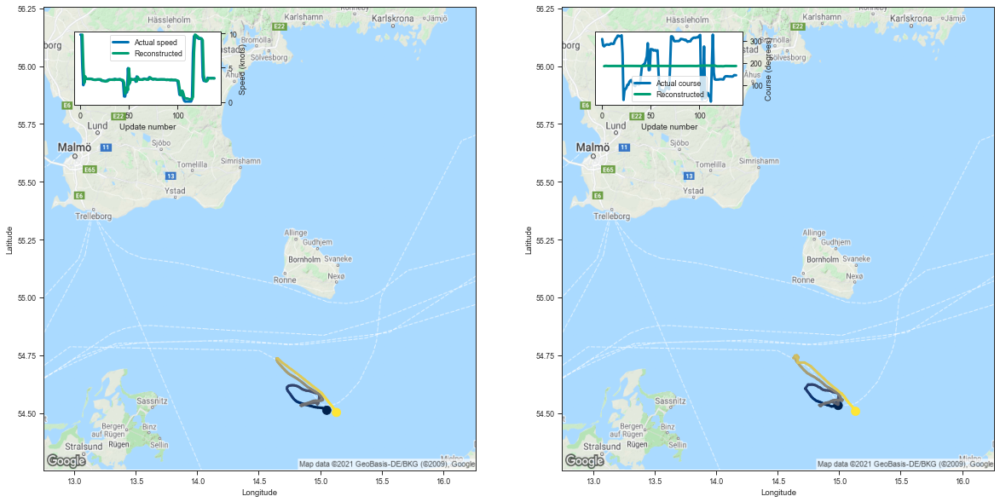

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.992305  54.532516  9.813886  185.395905         0.025828   
3    14.966216  54.536140  5.110824  186.598953         0.013237   
4    14.951946  54.528847  2.783855  186.711411         0.006186   
5    14.937853  54.528152  3.737985  186.270248         0.005211   
6    14.916911  54.532940  3.380240  186.152191         0.003852   
..         ...        ...       ...         ...              ...   
134  15.090317  54.537239  3.483210  186.173904         0.004307   
135  15.102421  54.530064  3.458687  186.243362         0.004605   
136  15.113289  54.522842  3.477858  186.087616         0.004019   
137  15.123771  54.514778  3.465089  186.261810         0.004740   
138  15.133586  54.507252  3.452185  186.284103         0.004931   

     Latitude sigma  Speed sigma  Course sigma  
2          0.014279     1.302952     97.219528  
3          0.007827     1.331598    102.262812  
4          0.004123     0.371011    

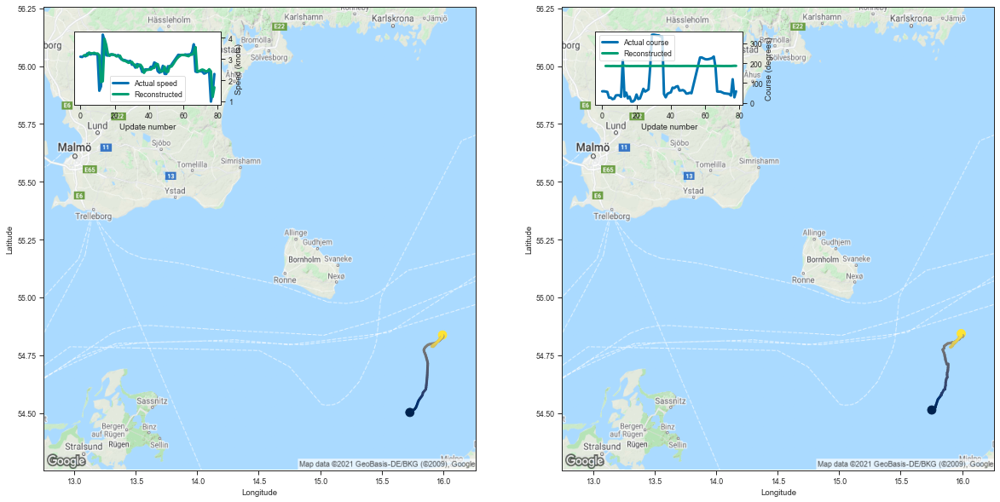

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.753168  54.512863  3.166845  185.969376         0.007103   
3   15.768888  54.518215  3.193405  186.033417         0.006052   
4   15.782381  54.523529  3.165159  185.912262         0.005109   
5   15.786766  54.533497  3.306692  185.515854         0.003434   
6   15.791614  54.540405  3.272419  185.843399         0.004534   
..        ...        ...       ...         ...              ...   
74  15.980082  54.826160  2.430690  185.879929         0.004030   
75  15.986689  54.829582  2.516309  185.746063         0.003642   
76  15.995501  54.836143  2.417841  186.314590         0.006461   
77  15.980041  54.836693  1.206671  186.835052         0.007330   
78  15.992446  54.843102  1.659804  186.525818         0.006518   

    Latitude sigma  Speed sigma  Course sigma  
2         0.004902     0.201962     95.811506  
3         0.004032     0.306880    101.492365  
4         0.003438     0.230340    102.179300  
5  

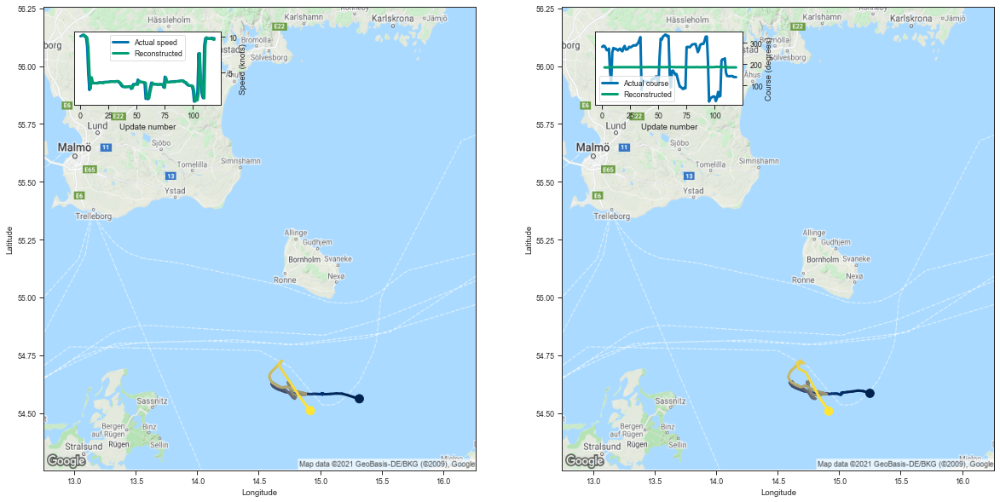

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    15.250372  54.584991  10.114613  185.251175         0.030247   
3    15.195633  54.594673  10.290266  185.054184         0.021223   
4    15.154004  54.596779  10.156870  185.081726         0.019227   
5    15.113050  54.593365  10.043673  184.965668         0.015746   
6    15.066348  54.590519   9.878987  185.164337         0.017172   
..         ...        ...        ...         ...              ...   
115  14.803414  54.603378   9.706972  185.358002         0.015427   
116  14.828720  54.577656   9.695467  185.489670         0.017957   
117  14.855250  54.554008   9.737436  185.113083         0.012942   
118  14.883811  54.534206   9.608170  185.547424         0.018965   
119  14.915404  54.507622   9.592422  185.101227         0.012695   

     Latitude sigma  Speed sigma  Course sigma  
2          0.016480     1.626706     96.937369  
3          0.011619     1.252169    100.184698  
4          0.010583     

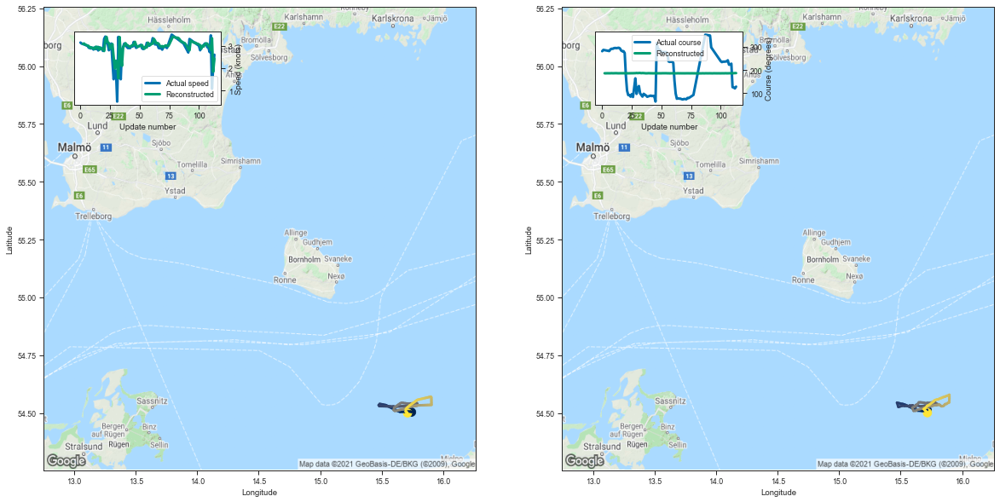

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.715572  54.512596  3.081110  185.980103         0.007092   
3    15.707670  54.511452  3.104067  185.820206         0.004622   
4    15.689741  54.509800  3.057858  186.061493         0.005329   
5    15.674438  54.508747  3.029257  186.084702         0.005339   
6    15.656952  54.510029  3.011197  186.011612         0.004797   
..         ...        ...       ...         ...              ...   
109  15.695125  54.518513  2.982768  185.977005         0.004643   
110  15.687855  54.516663  2.815359  186.089279         0.004782   
111  15.708849  54.503944  3.340046  186.294983         0.007054   
112  15.701214  54.510117  1.833825  186.851959         0.007807   
113  15.717913  54.500938  2.426351  186.692688         0.008291   

     Latitude sigma  Speed sigma  Course sigma  
2          0.004933     0.178684     94.827295  
3          0.003199     0.127318     99.975305  
4          0.003569     0.276265    

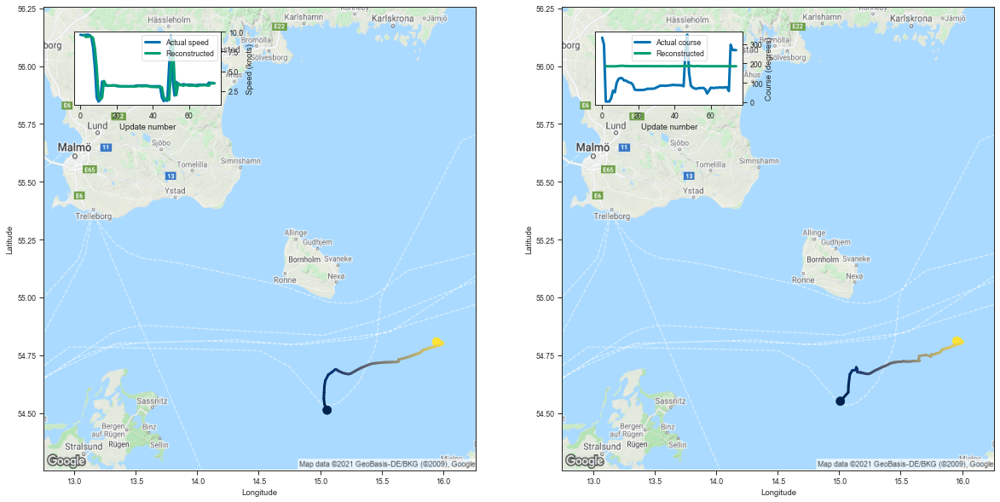

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.010130  54.550911  9.587580  185.782471         0.035277   
3   15.073862  54.589001  9.351982  185.388275         0.019535   
4   15.076401  54.620338  9.367929  185.136414         0.014420   
5   15.082987  54.650078  9.402020  185.141129         0.014097   
6   15.087754  54.667404  9.397478  185.081985         0.013268   
..        ...        ...       ...         ...              ...   
70  15.996113  54.801189  3.198609  185.880249         0.005540   
71  16.006546  54.806923  3.169430  185.823517         0.005500   
72  15.983967  54.818317  3.507262  185.479752         0.004509   
73  15.972369  54.811920  3.532096  185.482269         0.004306   
74  15.956060  54.811169  3.484339  185.456314         0.004028   

    Latitude sigma  Speed sigma  Course sigma  
2         0.018748     2.253121     98.491919  
3         0.010709     1.325483    100.876326  
4         0.008235     0.856645    101.058954  
5  

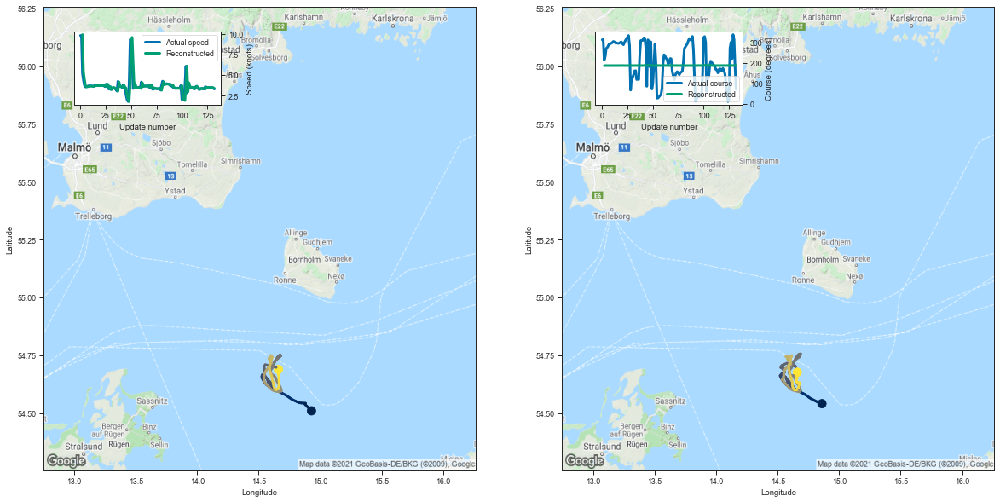

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.860194  54.540276  9.897364  185.845276         0.037287   
3    14.879099  54.546024  5.384701  186.502365         0.012968   
4    14.872258  54.543377  4.442587  186.141724         0.005998   
5    14.849028  54.545059  3.723405  186.214417         0.004522   
6    14.833530  54.546432  3.542090  186.199997         0.004038   
..         ...        ...       ...         ...              ...   
128  14.654051  54.647797  3.450807  186.584839         0.005130   
129  14.659391  54.649406  3.409594  186.510818         0.004741   
130  14.654725  54.669067  3.501002  186.595856         0.005313   
131  14.651907  54.675346  3.452116  186.544846         0.004985   
132  14.659642  54.676235  3.379875  186.676041         0.005510   

     Latitude sigma  Speed sigma  Course sigma  
2          0.019606     2.324646     98.782471  
3          0.007686     1.130677    101.157442  
4          0.003996     0.245747    

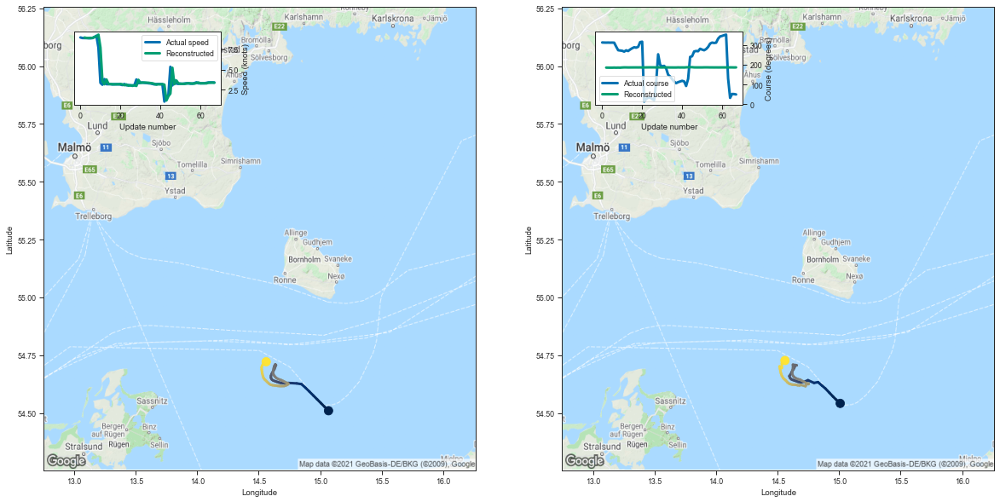

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.008982  54.541431  8.946975  185.538025         0.022943   
3   14.975818  54.557560  8.900405  185.322388         0.014622   
4   14.949619  54.571415  8.893393  185.216370         0.012151   
5   14.921435  54.587223  8.904022  185.175690         0.011177   
6   14.888486  54.605701  8.900249  185.607147         0.016492   
..        ...        ...       ...         ...              ...   
63  14.515626  54.701302  3.286641  186.565475         0.004333   
64  14.534177  54.694298  3.364176  186.671906         0.004990   
65  14.534604  54.715313  3.374777  186.592484         0.004587   
66  14.543801  54.720428  3.385667  186.362656         0.003685   
67  14.559659  54.726986  3.365289  186.574631         0.004439   

    Latitude sigma  Speed sigma  Course sigma  
2         0.013090     1.150153     96.335899  
3         0.008496     0.771059     99.814887  
4         0.007144     0.597500    100.724936  
5  

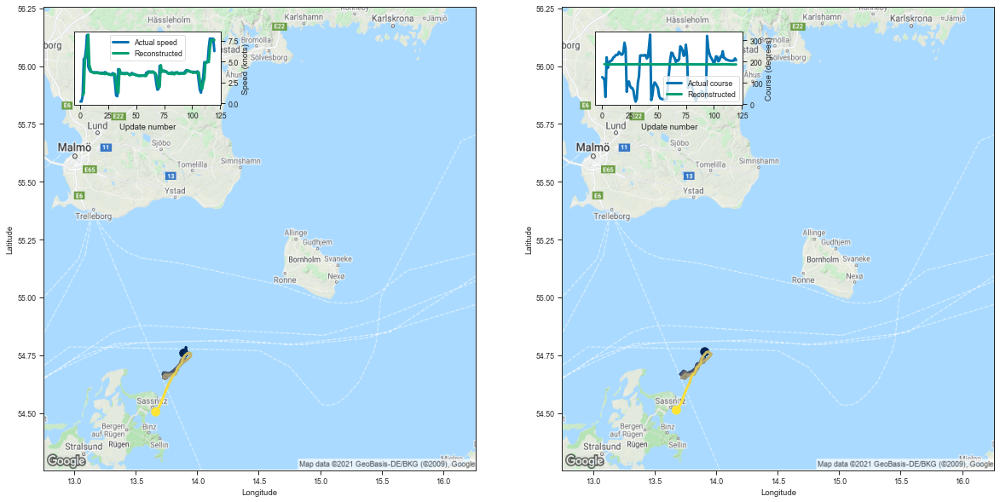

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.908126  54.764458  0.950460  188.231888         0.008498   
3    13.889589  54.763077  1.188763  188.895279         0.014679   
4    13.922768  54.768246  5.291384  187.064255         0.010971   
5    13.916155  54.764488  5.505468  186.951355         0.010105   
6    13.912433  54.773716  6.501481  186.737488         0.011248   
..         ...        ...       ...         ...              ...   
116  13.746652  54.585869  6.561753  186.672379         0.009899   
117  13.732132  54.567612  7.526230  186.627548         0.012778   
118  13.719593  54.546284  7.539609  186.561508         0.011954   
119  13.699747  54.528847  7.558078  186.666412         0.013234   
120  13.676321  54.512424  7.561650  186.898453         0.016557   

     Latitude sigma  Speed sigma  Course sigma  
2          0.005720     0.617679     97.838934  
3          0.008461     2.541235    105.326205  
4          0.006680     0.877463    

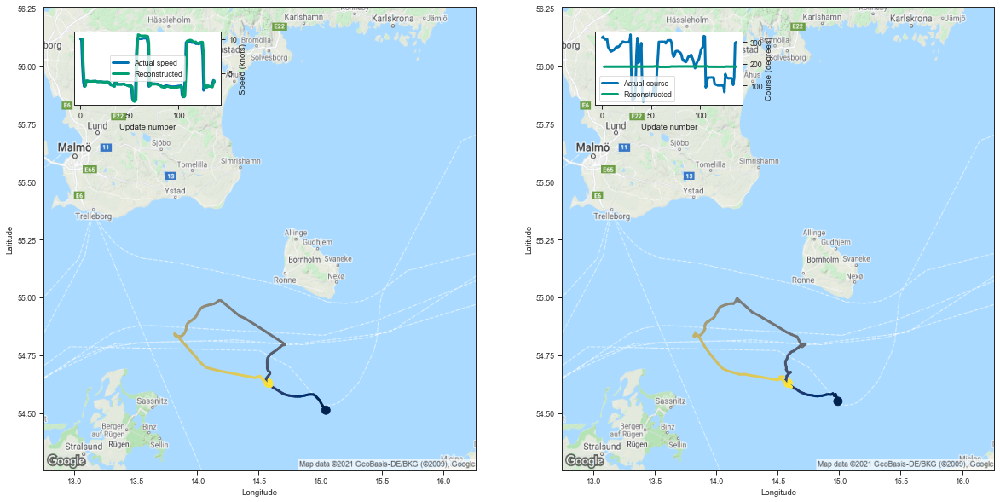

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.990278  54.550549  10.058798  185.468231         0.030276   
3    14.970957  54.581284   6.108711  186.277802         0.014114   
4    14.968409  54.572254   3.818522  186.357651         0.006259   
5    14.958251  54.574745   3.044017  186.576096         0.005494   
6    14.949673  54.583958   3.738453  186.281204         0.005193   
..         ...        ...        ...         ...              ...   
133  14.583116  54.619541   3.049702  186.598083         0.004233   
134  14.592700  54.615166   3.025067  186.613739         0.004318   
135  14.610251  54.613705   2.936171  186.585434         0.004069   
136  14.612678  54.610985   3.454379  186.488266         0.004505   
137  14.585444  54.628830   3.880681  186.377960         0.004688   

     Latitude sigma  Speed sigma  Course sigma  
2          0.016431     1.620866     97.403322  
3          0.008274     1.234893    101.136366  
4          0.004194     

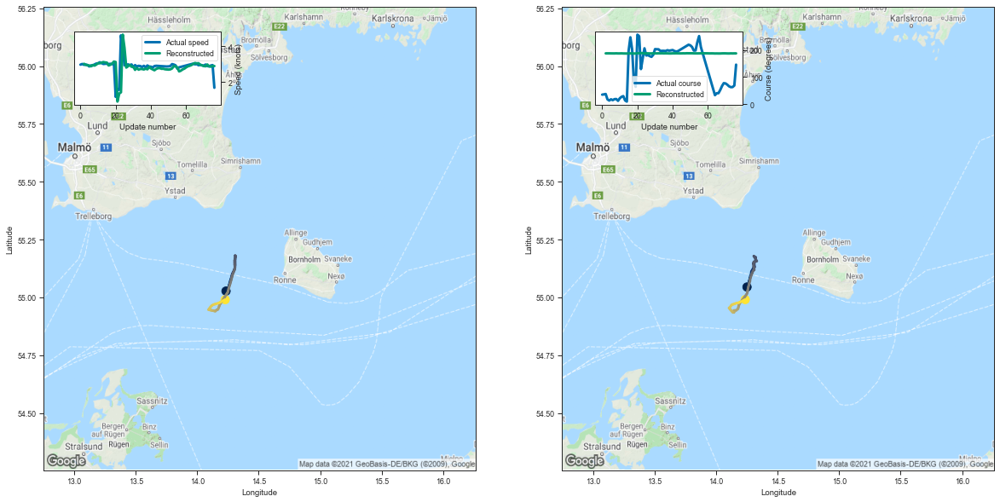

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.251026  55.044678  3.014947  187.137161         0.007646   
3   14.260983  55.051308  2.954592  187.183655         0.006614   
4   14.266375  55.059124  2.940615  187.204361         0.006460   
5   14.268035  55.068863  2.915770  187.067902         0.005553   
6   14.270990  55.074039  2.877223  186.989777         0.004989   
..        ...        ...       ...         ...              ...   
72  14.184898  54.977028  2.975612  186.770370         0.003847   
73  14.197204  54.980717  2.871582  187.121124         0.005262   
74  14.211417  54.982716  2.853024  186.919998         0.004411   
75  14.223232  54.987289  2.893896  187.083969         0.005240   
76  14.236691  54.990440  2.890121  187.065277         0.005292   

    Latitude sigma  Speed sigma  Course sigma  
2         0.005270     0.403466     95.697302  
3         0.004409     0.483588     99.958102  
4         0.004273     0.533454    101.139402  
5  

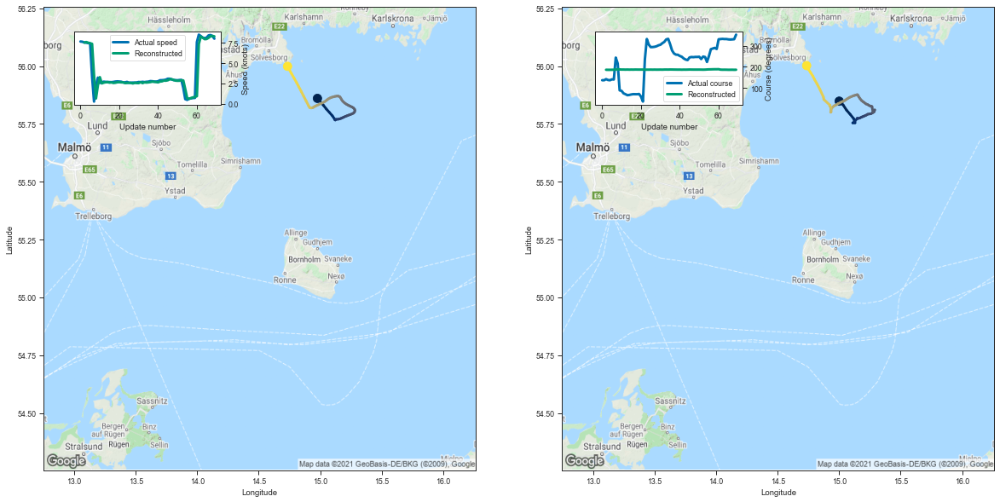

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.000539  55.848503  7.525496  185.684967         0.017858   
3   15.032820  55.832058  7.588264  185.431488         0.011874   
4   15.060783  55.809296  7.502528  185.441528         0.011121   
5   15.088903  55.792137  7.442105  185.662216         0.013722   
6   15.118199  55.772915  7.365820  185.735779         0.014948   
..        ...        ...       ...         ...              ...   
65  14.800671  55.941566  7.961347  185.616135         0.013065   
66  14.786701  55.956532  8.100220  185.673767         0.013768   
67  14.768963  55.971508  8.294691  185.813354         0.016848   
68  14.751581  55.985859  8.339714  185.512146         0.012622   
69  14.735973  56.002144  8.286266  185.799393         0.016017   

    Latitude sigma  Speed sigma  Course sigma  
2         0.012333     0.743002     87.077911  
3         0.008303     0.484386     90.691447  
4         0.007695     0.513975     92.364031  
5  

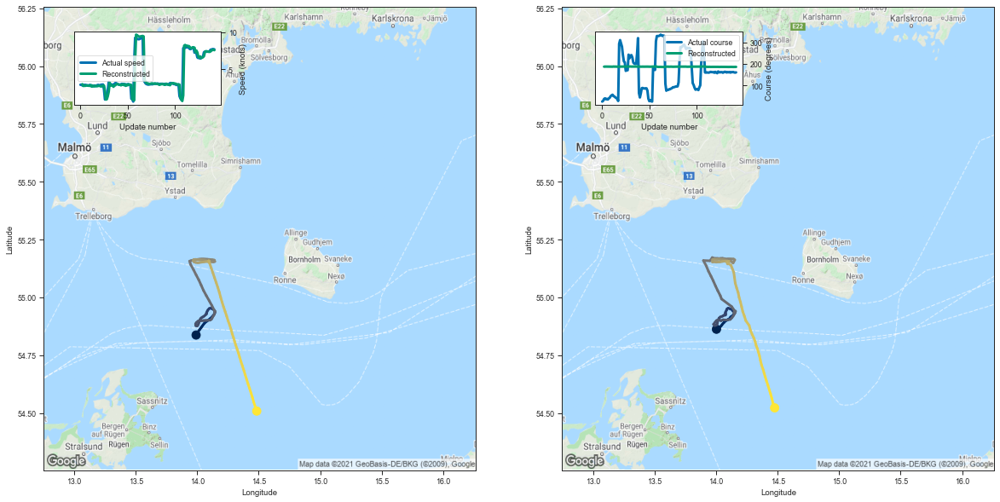

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.002837  54.862217  2.953477  187.107239         0.005979   
3    14.010426  54.863491  2.706700  187.343399         0.005780   
4    14.021307  54.866550  2.738912  187.462463         0.006519   
5    14.030992  54.870899  2.719819  187.365463         0.005938   
6    14.041449  54.876968  2.775340  187.522675         0.007096   
..         ...        ...       ...         ...              ...   
138  14.431843  54.601105  7.420289  185.774780         0.008391   
139  14.442588  54.582893  7.570117  185.762589         0.008621   
140  14.452839  54.563255  7.593821  185.836487         0.009430   
141  14.462735  54.541763  7.650094  185.592361         0.007616   
142  14.476070  54.521988  7.580952  186.053741         0.011747   

     Latitude sigma  Speed sigma  Course sigma  
2          0.004113     0.188941     96.274728  
3          0.003770     0.347547    101.645721  
4          0.004131     0.530745    

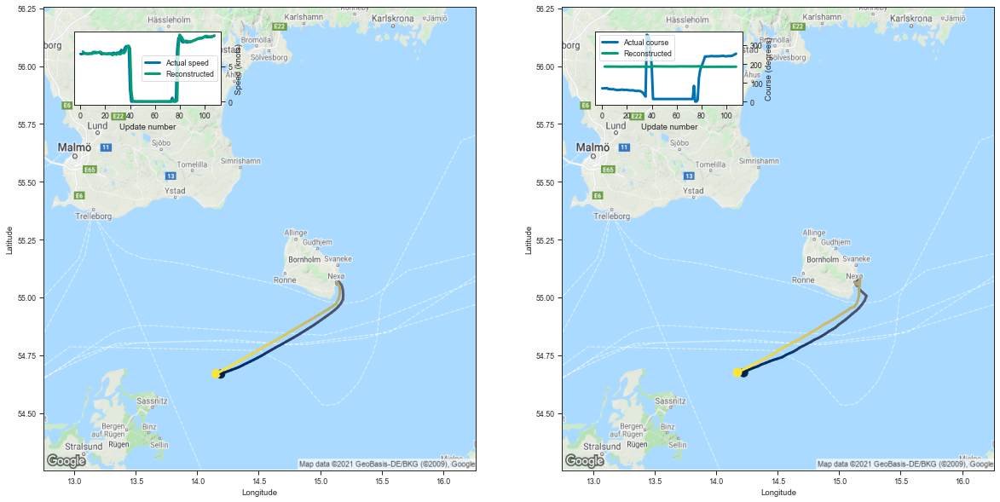

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.223810  54.674099  7.058665  186.323654         0.014311   
3    14.270338  54.687973  6.895103  186.241440         0.010577   
4    14.303824  54.695091  6.825603  186.376129         0.011441   
5    14.339493  54.701775  6.812105  186.028336         0.008337   
6    14.368982  54.709641  6.713372  186.340027         0.010895   
..         ...        ...       ...         ...              ...   
104  14.330582  54.717667  9.133646  185.483704         0.010140   
105  14.299621  54.708012  9.194267  185.387283         0.009252   
106  14.268831  54.700130  9.161641  185.511246         0.010088   
107  14.221576  54.688290  9.231601  185.600327         0.010926   
108  14.173732  54.675220  9.310728  185.511871         0.009930   

     Latitude sigma  Speed sigma  Course sigma  
2          0.008698     0.689385     96.580202  
3          0.006457     0.632219    100.689566  
4          0.006852     0.906258    

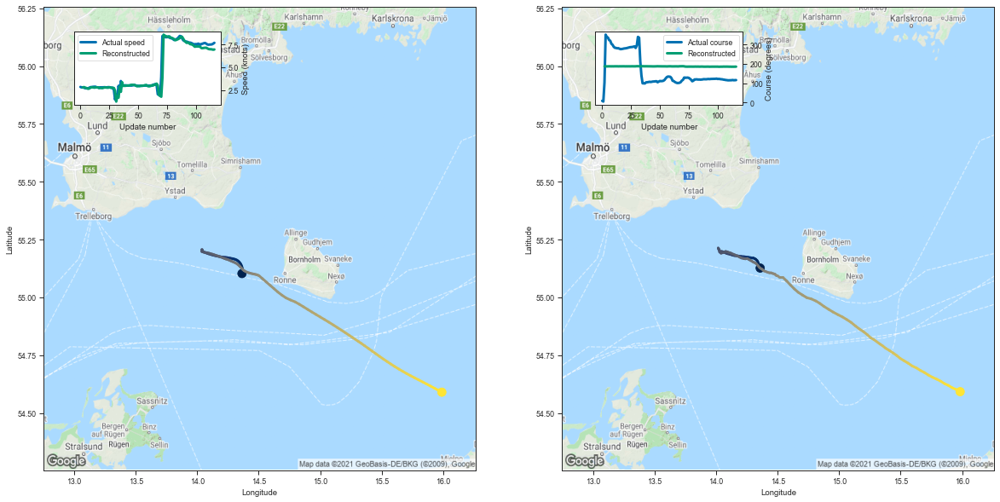

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358241  55.126751  2.788872  187.080566         0.007178   
3    14.376548  55.122822  2.836619  187.047134         0.006232   
4    14.346515  55.139591  2.785780  186.802216         0.004515   
5    14.343615  55.145447  2.739475  186.990097         0.005128   
6    14.341208  55.151058  2.686050  187.213745         0.006370   
..         ...        ...       ...         ...              ...   
112  15.857872  54.626453  6.981948  184.993439         0.009183   
113  15.887100  54.619503  6.982289  185.168304         0.010743   
114  15.918386  54.609203  6.960654  185.059677         0.009958   
115  15.951174  54.601727  6.932257  185.284943         0.012593   
116  15.983785  54.592010  6.954614  185.434540         0.015268   

     Latitude sigma  Speed sigma  Course sigma  
2          0.005085     0.371857     95.074334  
3          0.004304     0.396258     98.243738  
4          0.003223     0.179815    

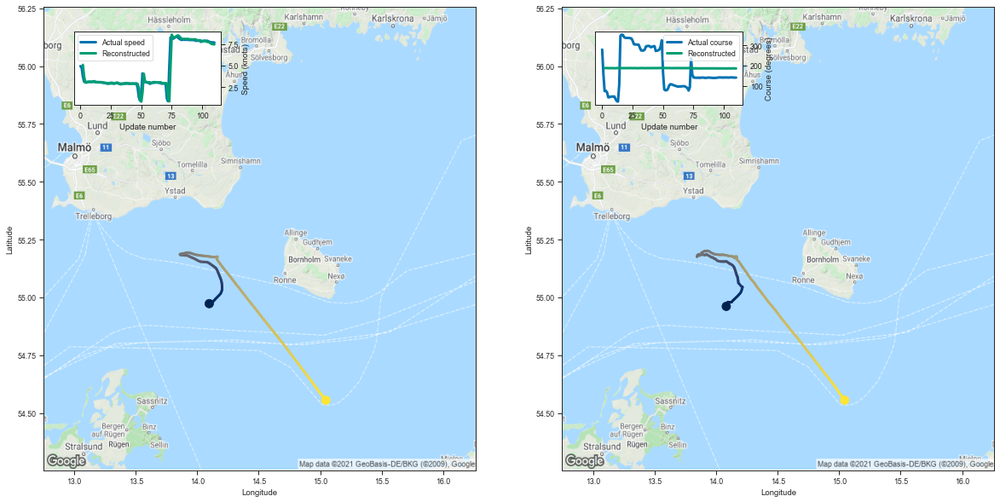

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.082522  54.960995  5.086942  187.132645         0.014892   
3    14.094809  54.979622  3.731483  187.228531         0.008512   
4    14.111518  54.978416  3.031646  187.319412         0.006968   
5    14.124928  54.979126  3.017729  187.094742         0.005481   
6    14.139102  54.987713  3.081664  186.827271         0.004206   
..         ...        ...       ...         ...              ...   
106  14.960032  54.618969  7.701858  185.585770         0.010830   
107  14.979423  54.604530  7.590636  185.688934         0.011806   
108  15.002810  54.586052  7.514710  185.853516         0.013800   
109  15.020023  54.572823  7.483337  185.651810         0.011448   
110  15.045074  54.555405  7.481228  185.280640         0.007925   

     Latitude sigma  Speed sigma  Course sigma  
2          0.009301     1.120294     96.204773  
3          0.005428     0.686095    100.102067  
4          0.004473     0.560108    

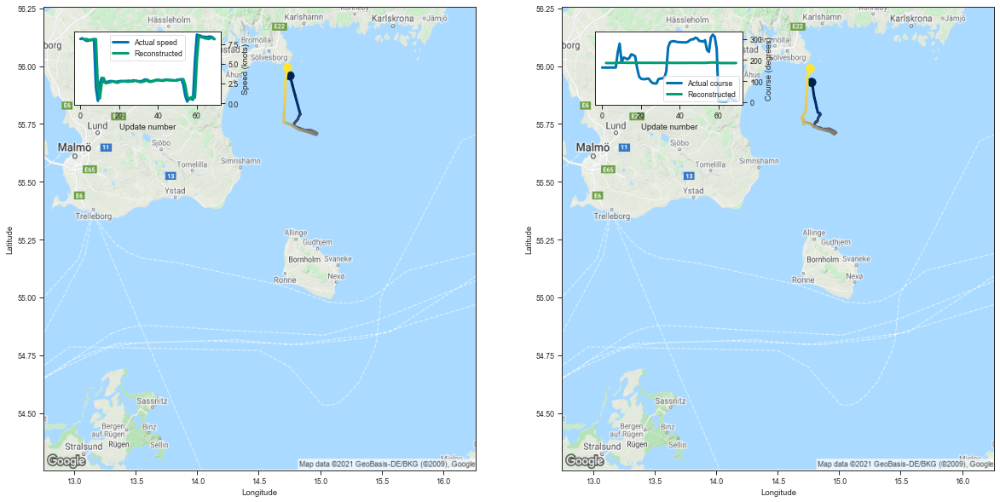

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.777272  55.929714  8.025465  185.954483         0.025750   
3   14.787014  55.905354  8.124951  185.570892         0.014182   
4   14.792472  55.882000  8.015263  185.580917         0.012724   
5   14.799148  55.862526  8.003453  185.685974         0.013915   
6   14.808642  55.843983  8.067355  185.657074         0.013942   
..        ...        ...       ...         ...              ...   
65  14.741400  55.917374  8.190626  185.813019         0.015173   
66  14.741347  55.937408  8.112585  185.841248         0.015340   
67  14.738276  55.952984  8.223915  185.400085         0.010295   
68  14.754809  55.966244  8.238286  185.600510         0.012192   
69  14.764982  55.989571  8.139301  185.842194         0.015499   

    Latitude sigma  Speed sigma  Course sigma  
2         0.016987     1.279462     86.354005  
3         0.009627     0.626215     90.277756  
4         0.008627     0.638301     92.148535  
5  

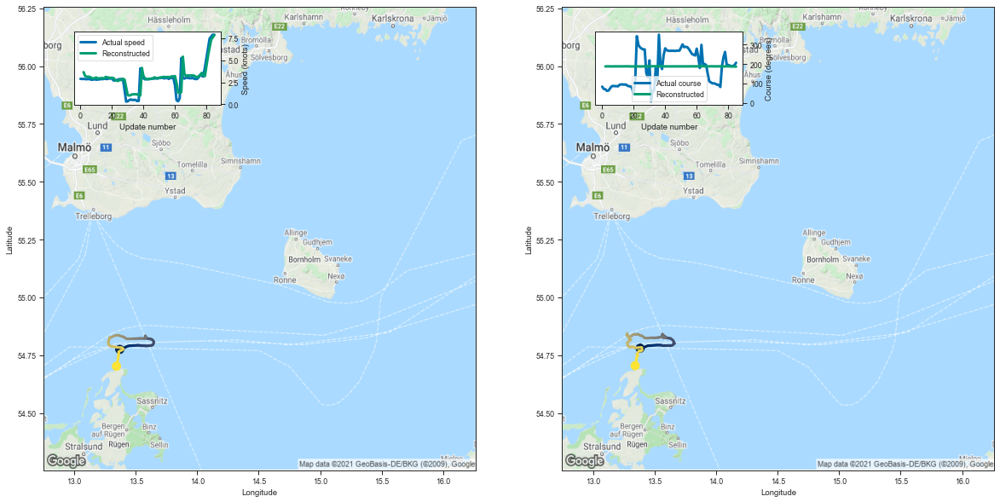

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.382112  54.780045  3.649257  187.585266         0.008568   
3   13.405826  54.780350  3.207310  187.960632         0.009078   
4   13.429186  54.787880  3.129165  188.052017         0.009614   
5   13.445630  54.790619  3.132967  187.849594         0.007920   
6   13.456169  54.792027  3.109174  187.569733         0.005945   
..        ...        ...       ...         ...              ...   
81  13.364001  54.747803  5.514887  187.638092         0.013933   
82  13.358349  54.745110  6.474948  187.091660         0.010983   
83  13.355179  54.742702  7.335751  186.953400         0.012458   
84  13.351567  54.729675  7.602494  186.940018         0.013313   
85  13.341935  54.704357  7.860016  186.569885         0.010052   

    Latitude sigma  Speed sigma  Course sigma  
2         0.005356     0.310077     96.044357  
3         0.005294     0.725876    102.142029  
4         0.005510     0.933251    103.399233  
5  

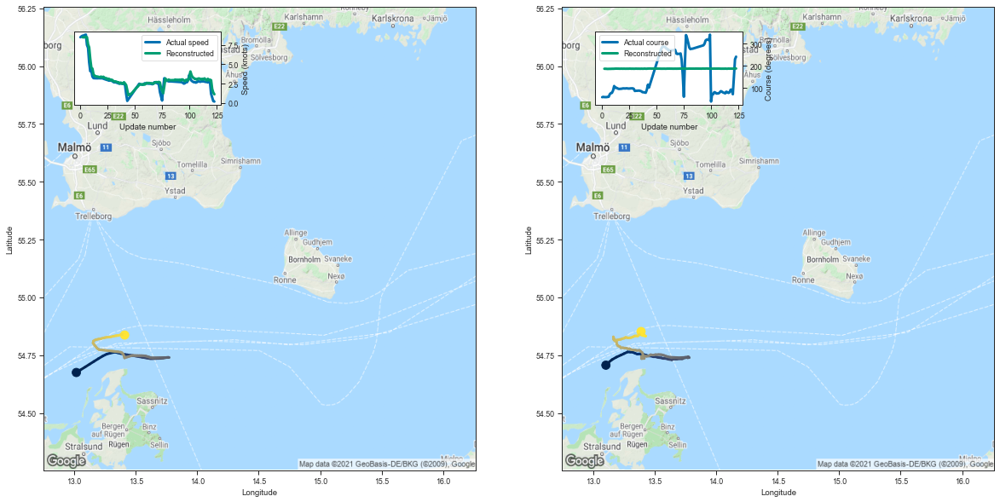

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.104222  54.706757  8.484241  187.488419         0.033969   
3    13.118036  54.715084  8.476882  187.453400         0.027526   
4    13.154349  54.730743  8.489154  187.163803         0.020505   
5    13.190042  54.741573  8.548632  186.743378         0.013779   
6    13.226479  54.750397  8.487497  186.960892         0.016684   
..         ...        ...       ...         ...              ...   
119  13.399241  54.839825  3.017735  187.918610         0.007924   
120  13.409135  54.839329  2.947919  187.998535         0.008372   
121  13.427079  54.832382  1.823527  188.280350         0.007540   
122  13.401677  54.834999  1.363831  189.021301         0.012858   
123  13.389951  54.852306  1.138031  188.494110         0.007277   

     Latitude sigma  Speed sigma  Course sigma  
2          0.017426     2.137777     98.267989  
3          0.014108     2.217490    102.544645  
4          0.010866     1.553527    

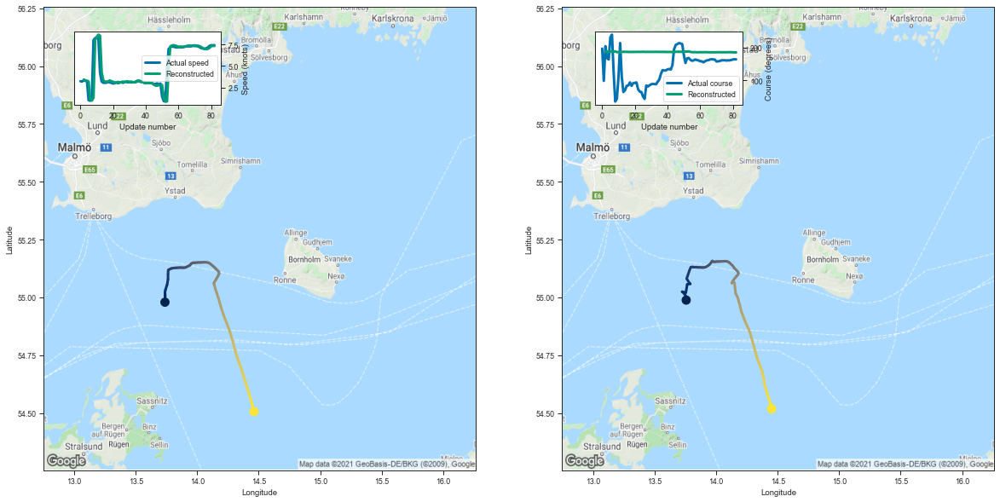

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.756899  54.988094  3.419951  187.705734         0.011198   
3   13.748585  54.987865  3.333961  187.368103         0.006728   
4   13.754491  54.995026  3.283954  187.230637         0.005476   
5   13.755090  55.004520  3.185081  187.953613         0.010690   
6   13.735634  55.019672  1.099888  188.223618         0.006789   
..        ...        ...       ...         ...              ...   
78  14.410320  54.592293  7.014962  186.316895         0.012356   
79  14.420995  54.573711  7.119501  186.205994         0.011795   
80  14.433880  54.554890  7.303873  185.887131         0.009166   
81  14.442497  54.537926  7.368404  185.611069         0.006987   
82  14.450799  54.517933  7.339869  185.720215         0.007657   

    Latitude sigma  Speed sigma  Course sigma  
2         0.006973     0.865960     97.397723  
3         0.004320     0.378613     99.502267  
4         0.003557     0.256838    100.417410  
5  

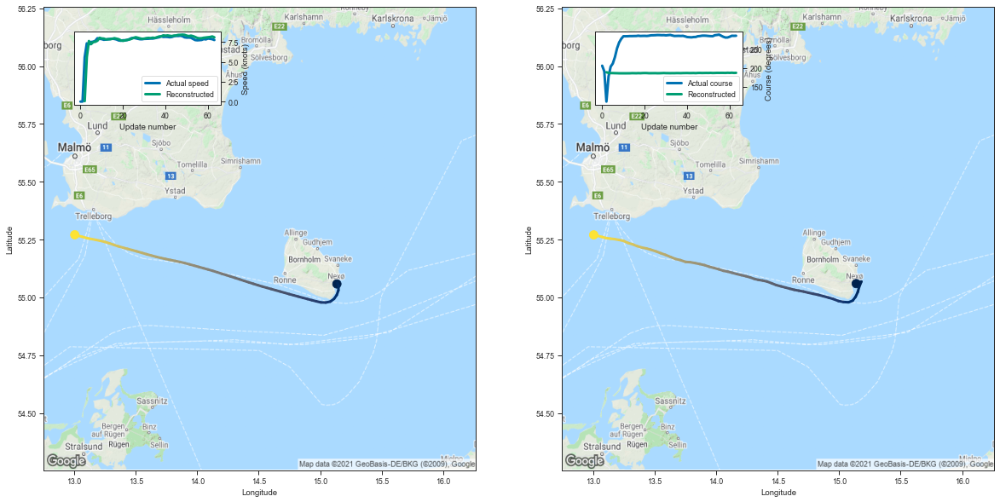

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.138759  55.059456  0.053685  188.273560         0.009957   
3   15.180906  55.068291  5.639212  186.528610         0.020784   
4   15.162524  55.044281  7.644776  186.058258         0.023759   
5   15.151808  55.023205  7.254416  186.046967         0.020066   
6   15.134364  55.002674  7.510825  185.819565         0.016930   
..        ...        ...       ...         ...              ...   
59  13.141440  55.253769  8.091152  186.892456         0.012667   
60  13.103110  55.256721  8.125342  186.611725         0.009583   
61  13.072374  55.261097  8.155674  186.986511         0.013545   
62  13.034493  55.266315  8.224291  186.493790         0.008403   
63  13.004836  55.270210  8.111116  186.697021         0.009515   

    Latitude sigma  Speed sigma  Course sigma  
2         0.007728     1.740301    101.328567  
3         0.012480     1.909719     96.426852  
4         0.013411     2.124543     98.489227  
5  

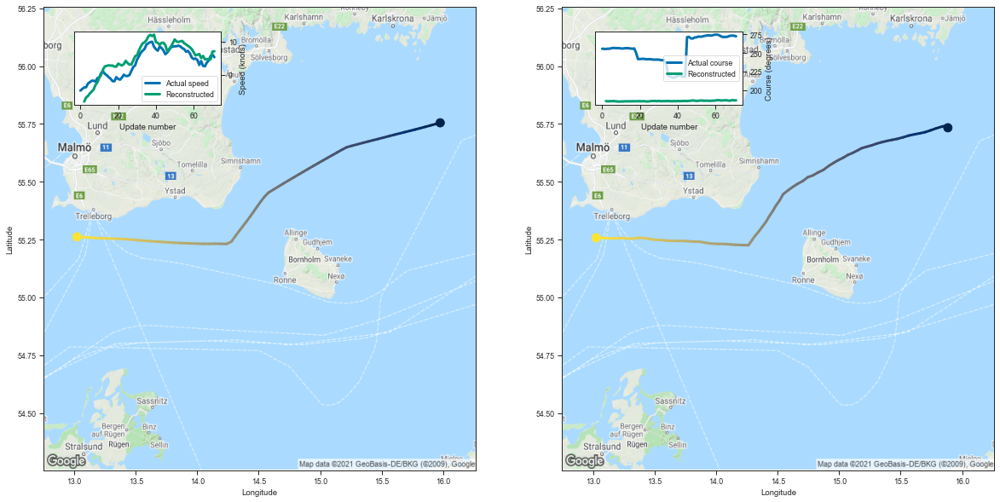

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.884127  55.733391  8.203438  185.326645         0.034965   
3   15.876953  55.743282  8.324226  184.932770         0.018918   
4   15.837646  55.738770  8.372416  185.129074         0.020574   
5   15.789123  55.730873  8.447480  185.108063         0.020012   
6   15.741112  55.721867  8.503584  185.345490         0.024539   
..        ...        ...       ...         ...              ...   
67  13.197925  55.256248  9.474327  185.878113         0.007729   
68  13.150111  55.254421  9.471910  185.927521         0.007719   
69  13.119926  55.255798  9.464279  186.600861         0.014541   
70  13.068220  55.257271  9.697660  186.160812         0.009989   
71  13.024443  55.257526  9.707577  186.294571         0.010941   

    Latitude sigma  Speed sigma  Course sigma  
2         0.022927     1.509171     84.324904  
3         0.012744     0.752541     88.255845  
4         0.013567     1.189606     91.102487  
5  

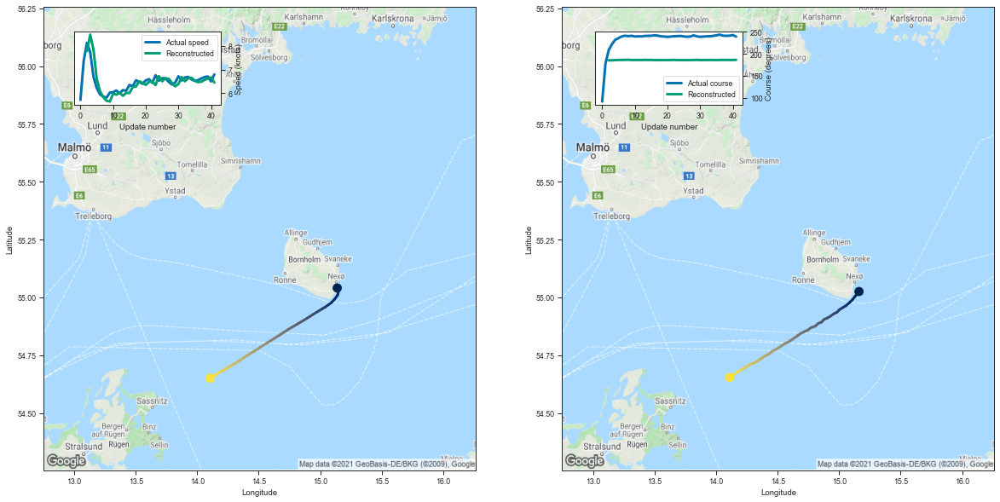

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.161657  55.025154  7.789027  185.402176         0.016412   
3   15.127703  55.002804  8.484391  185.300781         0.013826   
4   15.107376  54.989109  7.841850  185.723557         0.015891   
5   15.082701  54.976624  6.603189  186.133194         0.015740   
6   15.055531  54.963932  6.088496  186.144043         0.013264   
7   15.028791  54.955517  5.829855  186.280960         0.013330   
8   15.002949  54.946613  5.681557  186.593506         0.017195   
9   14.981688  54.935287  5.647267  186.004761         0.009611   
10  14.955579  54.928616  5.978892  186.064850         0.010448   
11  14.931903  54.919346  5.941102  186.137817         0.010882   
12  14.905771  54.911041  6.022897  185.973816         0.009418   
13  14.878548  54.904903  5.890104  186.276031         0.011588   
14  14.856510  54.892792  6.015275  186.061462         0.009933   
15  14.830596  54.887371  6.007055  186.302353         0.01200

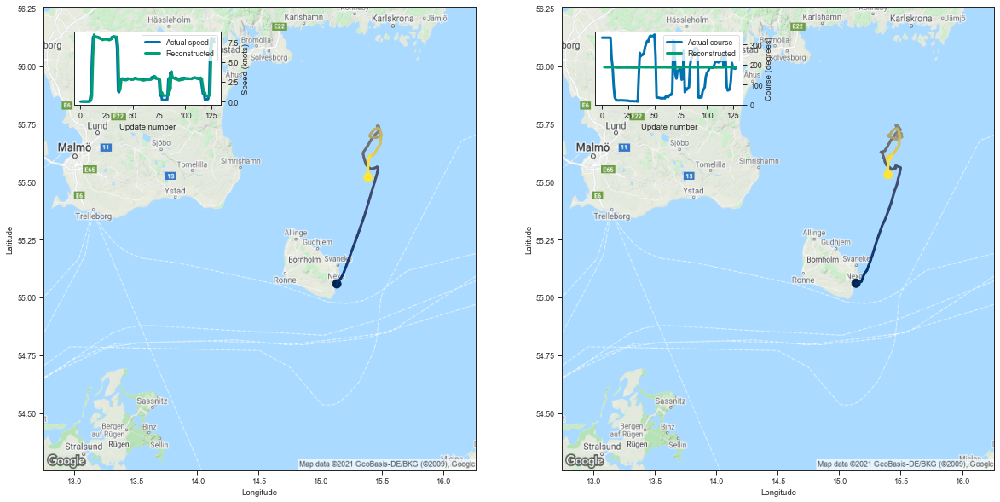

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.137573  55.061218  0.019692  187.028091         0.002897   
3    15.137533  55.060524  0.010893  186.840866         0.001805   
4    15.137208  55.060680  0.005628  186.597870         0.001299   
5    15.137288  55.060425  0.001772  186.513779         0.001133   
6    15.137527  55.060253  0.005654  186.823914         0.001529   
..         ...        ...       ...         ...              ...   
124  15.433641  55.613323  1.187277  187.937820         0.021321   
125  15.398675  55.588333  6.426928  185.968521         0.020605   
126  15.398484  55.569336  7.956993  185.485840         0.018349   
127  15.395720  55.550255  7.961876  185.196320         0.013229   
128  15.398109  55.530483  7.980054  185.255249         0.013441   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002642     0.058472     94.645685  
3          0.001616     0.035685    100.199547  
4          0.001186     0.016563    

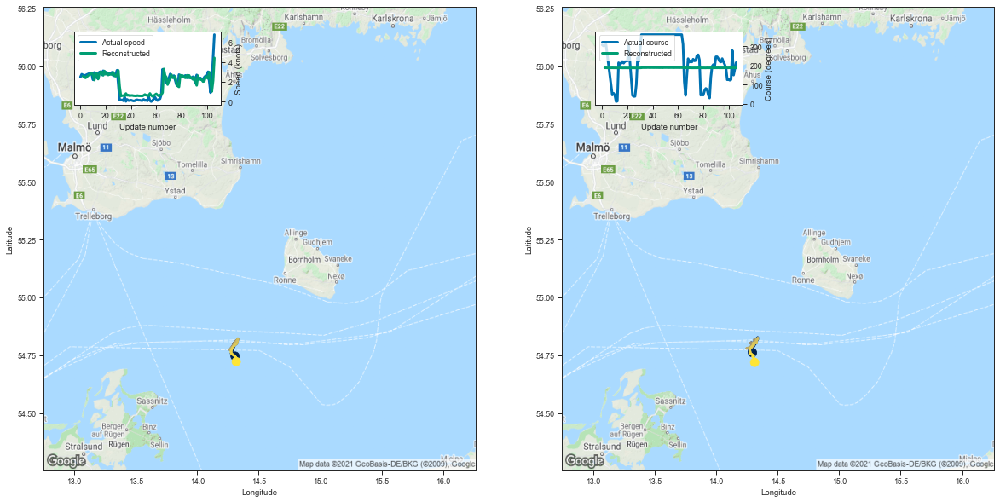

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.295362  54.760864  2.576857  187.611633         0.010881   
3    14.278652  54.765175  2.515487  187.396851         0.007350   
4    14.269026  54.767097  2.400393  187.217072         0.005561   
5    14.278801  54.767448  2.509397  186.964722         0.004412   
6    14.287868  54.769348  2.633550  187.138153         0.005397   
..         ...        ...       ...         ...              ...   
102  14.299393  54.748951  2.990950  187.431213         0.008600   
103  14.305896  54.748650  2.000042  187.786072         0.008526   
104  14.297298  54.743603  1.026275  188.090012         0.008374   
105  14.316545  54.732220  2.134093  187.601349         0.007697   
106  14.313107  54.718620  4.434250  187.143936         0.011228   

     Latitude sigma  Speed sigma  Course sigma  
2          0.006979     0.927558     98.276098  
3          0.004798     0.573520    100.916290  
4          0.003719     0.330084    

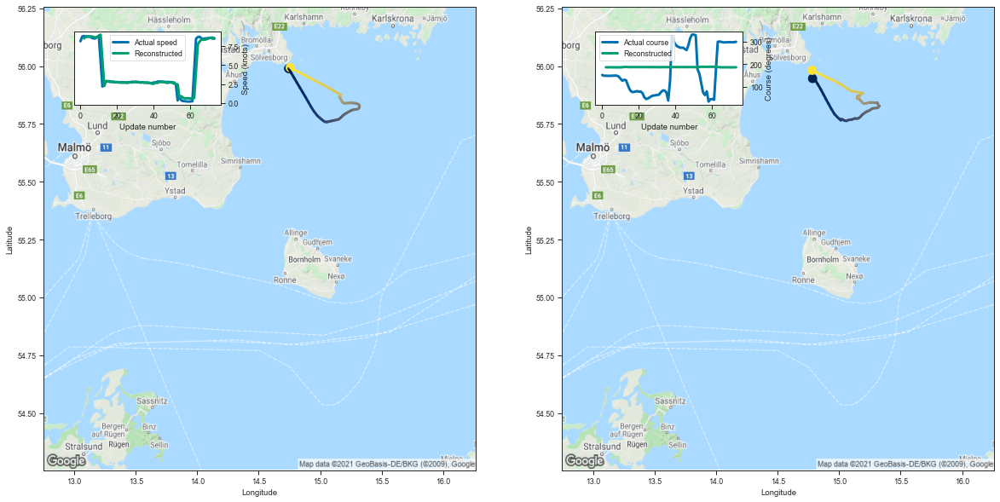

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.784005  55.946503  8.539629  185.707474         0.021999   
3   14.809112  55.936794  8.779568  185.422714         0.014947   
4   14.829290  55.919067  8.749846  185.563004         0.016253   
5   14.851684  55.898872  8.780495  185.514023         0.015917   
6   14.872905  55.877556  8.821230  185.335007         0.013504   
..        ...        ...       ...         ...              ...   
69  14.912390  55.947334  8.473642  185.398788         0.013202   
70  14.880753  55.955170  8.573245  185.160431         0.010213   
71  14.849460  55.963402  8.653650  185.296707         0.011375   
72  14.816941  55.972591  8.659030  185.389755         0.012439   
73  14.781204  55.982101  8.575367  185.675400         0.016061   

    Latitude sigma  Speed sigma  Course sigma  
2         0.014805     1.020232     87.204512  
3         0.010163     0.705694     90.877337  
4         0.010710     1.019328     93.037910  
5  

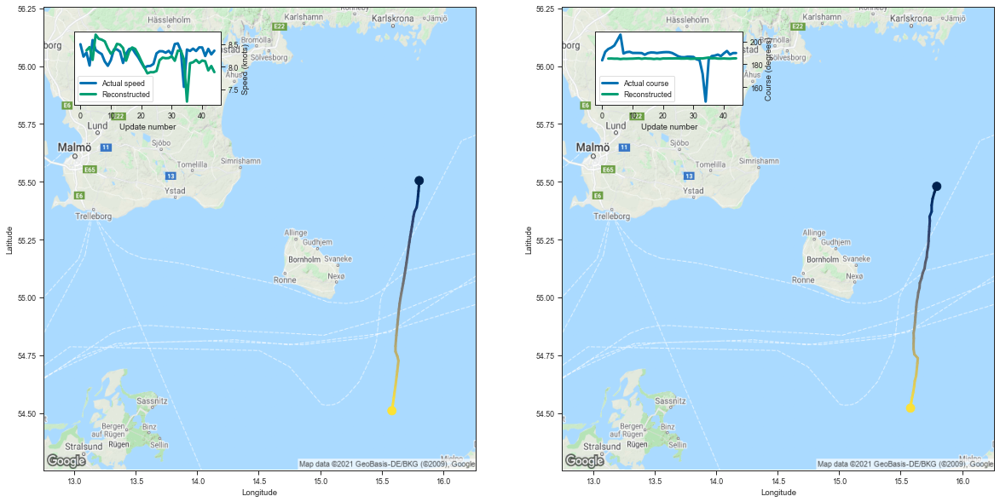

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.793854  55.480038  8.363287  184.985214         0.022524   
3   15.774886  55.454151  8.437340  185.062790         0.019589   
4   15.760081  55.426823  8.151834  184.901062         0.014460   
5   15.752131  55.398193  8.713753  184.935989         0.017267   
6   15.752253  55.371014  8.622023  184.575653         0.011577   
7   15.735195  55.348774  8.601183  184.860489         0.014361   
8   15.737762  55.331154  8.563978  184.803833         0.013777   
9   15.734348  55.307423  8.408150  184.906464         0.014388   
10  15.731853  55.284630  8.288843  184.946228         0.014401   
11  15.728594  55.264313  8.356951  185.104340         0.017124   
12  15.727216  55.243305  8.508289  185.281876         0.021847   
13  15.723407  55.218590  8.490747  184.799011         0.013773   
14  15.715105  55.194767  8.416080  185.201523         0.018680   
15  15.712140  55.172764  8.134352  185.006348         0.01447

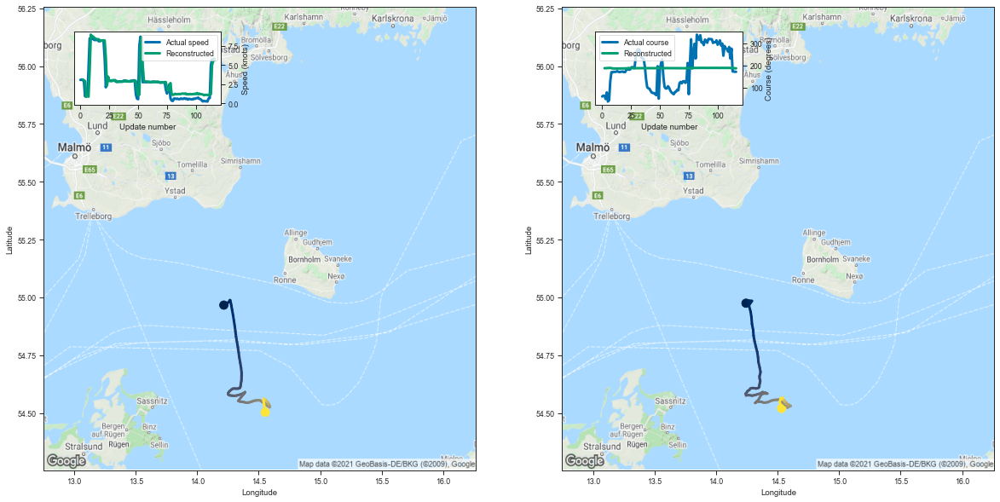

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.242795  54.974655  3.116150  186.891785         0.005961   
3    14.257195  54.976955  2.995324  186.837479         0.004590   
4    14.273911  54.982014  2.890612  187.071121         0.005368   
5    14.257321  54.981361  0.831560  187.788452         0.004986   
6    14.259519  54.981663  1.076100  187.632660         0.004803   
..         ...        ...       ...         ...              ...   
112  14.540992  54.564095  1.210198  187.753128         0.007586   
113  14.527264  54.564953  1.191514  188.362534         0.013598   
114  14.516130  54.546585  4.954226  186.853775         0.012125   
115  14.526834  54.535061  5.657892  186.401550         0.009592   
116  14.531676  54.519955  5.606039  186.229950         0.007745   

     Latitude sigma  Speed sigma  Course sigma  
2          0.004209     0.207048     95.821311  
3          0.003197     0.179880     99.590210  
4          0.003596     0.353556    

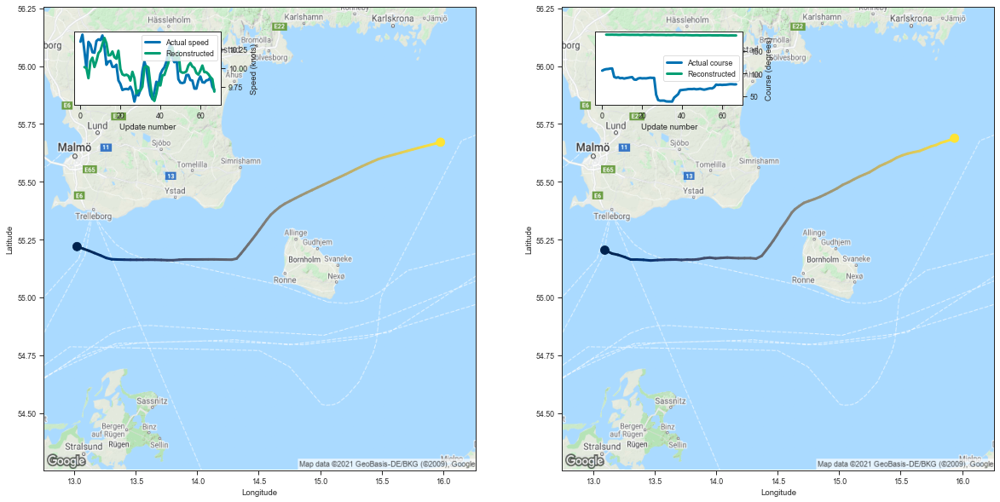

    Longitude   Latitude      Speed      Course  Longitude sigma  \
2   13.095278  55.204178  10.011843  186.178314         0.014489   
3   13.154443  55.189362   9.997080  186.101044         0.011216   
4   13.202633  55.183769   9.864422  186.099792         0.010639   
5   13.258357  55.173904  10.087515  186.213852         0.013380   
6   13.307577  55.163296  10.135872  186.011597         0.011613   
..        ...        ...        ...         ...              ...   
63  15.787649  55.658566   9.943840  184.224777         0.011849   
64  15.828969  55.668839   9.918842  184.419159         0.014543   
65  15.866482  55.674511   9.878729  184.427475         0.015419   
66  15.902447  55.680893   9.851858  184.340805         0.014540   
67  15.938039  55.688240   9.686712  184.381409         0.014527   

    Latitude sigma  Speed sigma  Course sigma  
2         0.009326     0.351293     92.011787  
3         0.007185     0.363858     96.847536  
4         0.006759     0.388482     98.

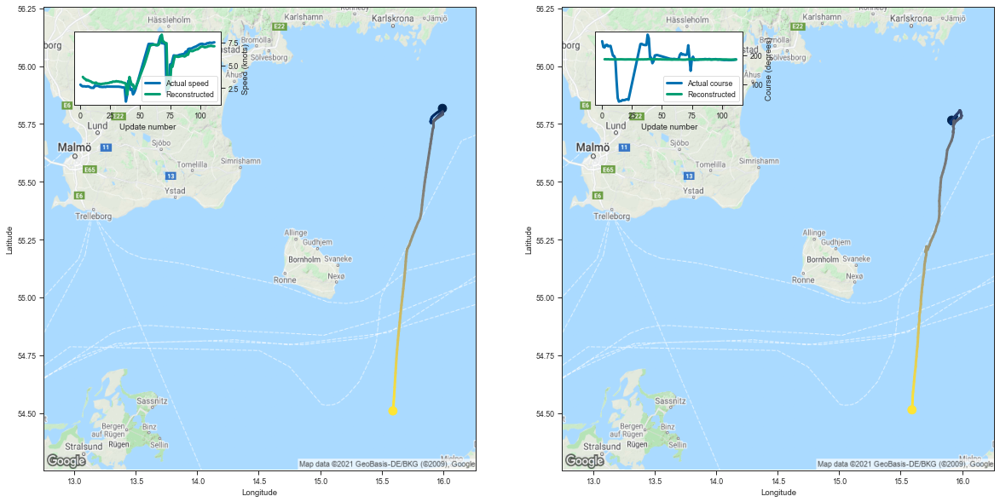

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.915423  55.766117  3.730464  186.414764         0.025179   
3    15.944269  55.778500  3.568896  186.549561         0.021521   
4    15.957035  55.782707  3.498925  186.159317         0.013123   
5    15.947582  55.775433  3.350079  186.540314         0.017096   
6    15.947781  55.779873  3.388027  185.991699         0.010143   
..         ...        ...       ...         ...              ...   
108  15.600958  54.591091  7.107597  184.985123         0.007559   
109  15.597981  54.571632  7.149463  185.089798         0.008375   
110  15.597416  54.550831  7.118065  185.168213         0.008948   
111  15.595339  54.531033  7.094871  185.141510         0.008660   
112  15.592403  54.513748  7.090942  185.334671         0.010347   

     Latitude sigma  Speed sigma  Course sigma  
2          0.020152     1.122401     79.399246  
3          0.016545     1.632354     86.155236  
4          0.010434     0.717243    

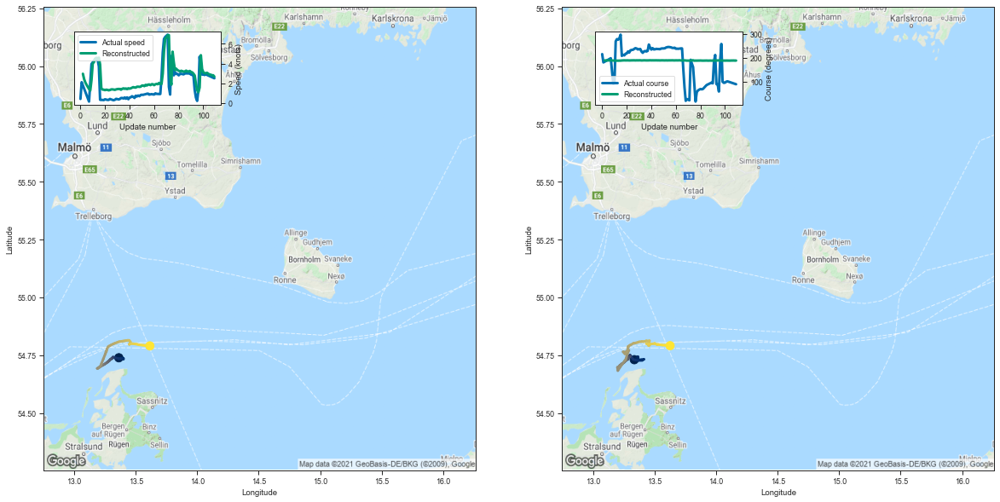

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.335107  54.730389  2.957943  188.336426         0.013987   
3    13.340266  54.736176  2.415117  188.426666         0.010896   
4    13.351595  54.736320  2.074203  188.592300         0.011163   
5    13.355003  54.736847  1.835446  188.677475         0.011279   
6    13.353382  54.736702  1.620556  188.597107         0.009680   
..         ...        ...       ...         ...              ...   
105  13.567139  54.793377  2.862504  188.045563         0.009444   
106  13.581758  54.793167  2.870186  188.035248         0.009545   
107  13.596164  54.792976  2.799129  188.186356         0.010967   
108  13.611949  54.792755  2.808061  187.884888         0.008284   
109  13.625577  54.790955  2.666075  187.926773         0.008178   

     Latitude sigma  Speed sigma  Course sigma  
2          0.008038     1.098126     98.339510  
3          0.006159     1.076130    102.328634  
4          0.006186     1.326126    

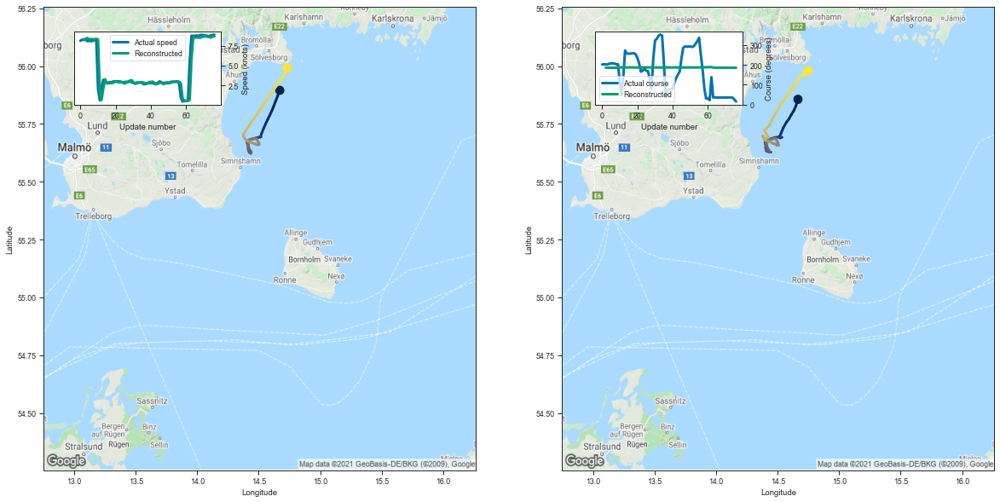

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.665401  55.856346  8.227724  185.908310         0.022988   
3   14.649257  55.828239  8.387811  185.394806         0.011554   
4   14.629706  55.805305  8.446236  185.594162         0.012777   
5   14.610668  55.789375  8.280688  185.399643         0.009824   
6   14.591568  55.771133  8.335777  185.519623         0.010743   
..        ...        ...       ...         ...              ...   
72  14.632609  55.914501  8.613741  185.543625         0.012180   
73  14.655716  55.929718  8.586071  185.831741         0.016215   
74  14.681627  55.952263  8.514846  185.526581         0.012373   
75  14.707816  55.962067  8.646227  185.174576         0.008788   
76  14.745821  55.980251  8.659676  185.652557         0.014287   

    Latitude sigma  Speed sigma  Course sigma  
2         0.015230     1.111840     87.358848  
3         0.008135     0.389785     90.153975  
4         0.008651     0.695440     93.264938  
5  

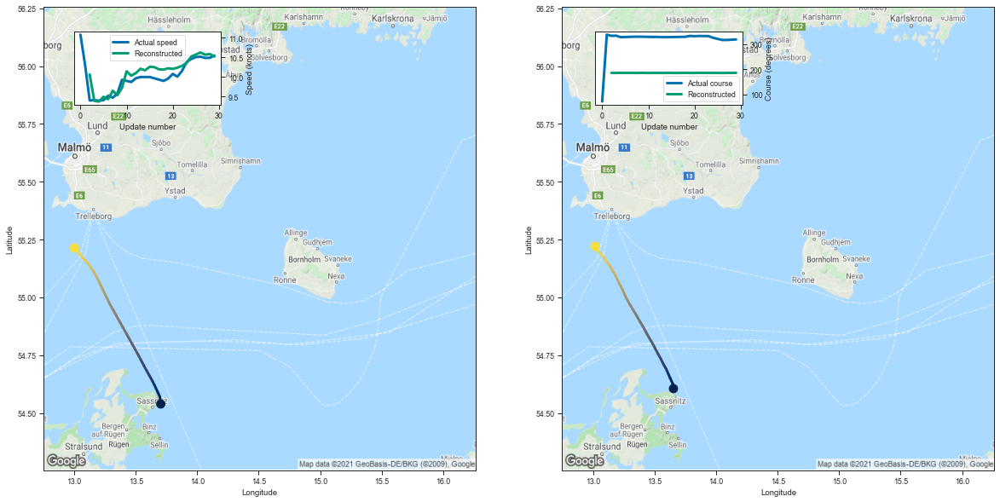

    Longitude   Latitude      Speed      Course  Longitude sigma  \
2   13.653132  54.605343  10.065302  186.066116         0.020513   
3   13.648071  54.626225   9.391254  186.068314         0.013609   
4   13.626588  54.650463   9.372929  186.381348         0.017229   
5   13.612248  54.667816   9.494679  186.105255         0.013289   
6   13.594685  54.689659   9.433586  186.285812         0.015079   
7   13.571569  54.711285   9.648297  185.980453         0.011730   
8   13.551885  54.732868   9.535336  186.164398         0.013213   
9   13.528604  54.754669   9.722675  186.308945         0.015835   
10  13.502009  54.781429  10.146021  185.867889         0.011602   
11  13.485213  54.799095  10.033577  186.095306         0.013702   
12  13.455694  54.825039  10.099974  186.131592         0.014176   
13  13.429941  54.849792  10.210054  185.920258         0.011755   
14  13.412282  54.867565  10.170980  186.162781         0.014377   
15  13.380733  54.895306  10.260029  186.002808 

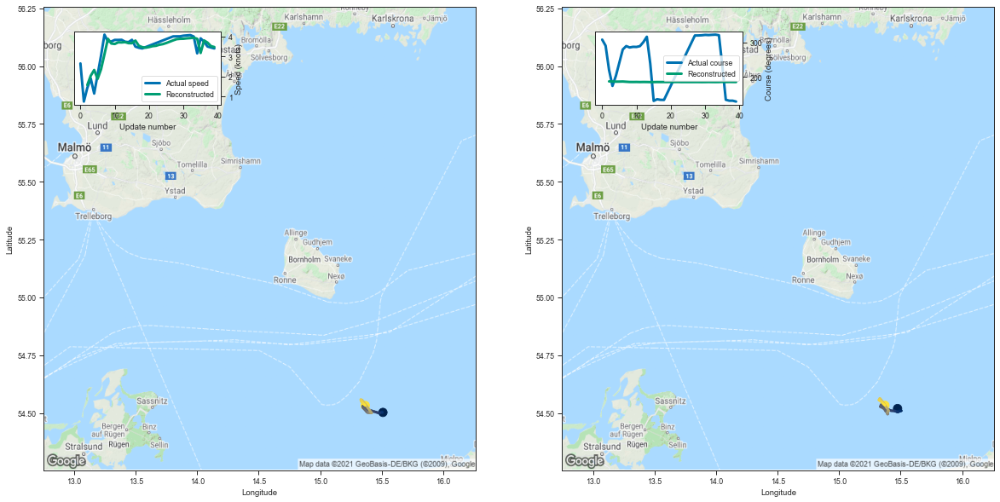

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.475143  54.519138  1.573232  187.661240         0.020615   
3   15.488601  54.513077  2.037779  187.402527         0.015543   
4   15.505461  54.509529  2.325637  186.908844         0.009678   
5   15.494745  54.508575  1.881693  187.029694         0.008824   
6   15.479046  54.504925  2.360468  187.302292         0.013189   
7   15.452917  54.508614  3.109633  186.597244         0.008458   
8   15.437398  54.509350  3.881560  185.985886         0.005633   
9   15.422004  54.509895  3.645090  185.911484         0.004500   
10  15.405433  54.513538  3.623094  186.045166         0.004946   
11  15.390102  54.516308  3.703859  185.803818         0.003976   
12  15.370392  54.520096  3.698219  185.999985         0.004644   
13  15.355894  54.526161  3.714584  185.900208         0.004254   
14  15.341028  54.535450  3.662609  185.663773         0.003237   
15  15.334669  54.527344  3.660333  185.668716         0.00312

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
34,34,7237328,266054000,Fishing,144,1342.084717,9.320033
44,44,7135380,266054000,Fishing,144,1338.034790,9.291908
25,25,7292936,266054000,Fishing,144,1336.213135,9.279258
29,29,6787151,265759000,Fishing,143,1297.636963,9.074384
74,74,6962046,265759000,Fishing,143,1287.738403,9.005164
...,...,...,...,...,...,...,...
33,33,4352040,261015270,Fishing,113,-76.863800,-0.680211
21,21,19488,211243240,Fishing,110,-79.542442,-0.723113
13,13,7873292,266315000,Fishing,77,-57.870930,-0.751571
101,101,1176042,211755650,Fishing,30,-23.433155,-0.781105


In [18]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n